In [1]:
import torch
from torch.utils.data import Dataset, DataLoader
from transformers import BertTokenizer, BertModel
from datasets import load_dataset
from PIL import Image
import torchvision.transforms as transforms

/home/vamsi/miniconda3/envs/nlp/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
ds = load_dataset("osunlp/MagicBrush")

In [3]:
ds

DatasetDict({
    train: Dataset({
        features: ['img_id', 'turn_index', 'source_img', 'mask_img', 'instruction', 'target_img'],
        num_rows: 8807
    })
    dev: Dataset({
        features: ['img_id', 'turn_index', 'source_img', 'mask_img', 'instruction', 'target_img'],
        num_rows: 528
    })
})

In [4]:
print(ds['train'][0].keys())

dict_keys(['img_id', 'turn_index', 'source_img', 'mask_img', 'instruction', 'target_img'])


In [5]:
image_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Typical ImageNet normalization
])

In [6]:
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
bert_model = BertModel.from_pretrained('bert-base-uncased')

In [7]:
import io
class MagicBrushDataset(Dataset):
    def __init__(self, split='train', fraction=1.0):
        if fraction<1.0:
            split = f"{split}[:{int(fraction * 100)}%]"
        self.dataset = load_dataset("osunlp/MagicBrush", split=split)

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        # Retrieve the item from the dataset
        item = self.dataset[idx]

        # Process text: encode with BERT tokenizer and get embeddings
        text = item['instruction']
        tokens = tokenizer(text, return_tensors='pt', padding='max_length', max_length=128, truncation=True)
        with torch.no_grad():
            text_embedding = bert_model(**tokens).last_hidden_state[:, 0, :]  # CLS token embedding (768-dimensional)

        if isinstance(item['source_img'], Image.Image):  # Already a PIL image
            image = item['source_img'].convert('RGB')
        else:
            raise ValueError(f"Unexpected type for 'source_img': {type(item['source_img'])}")
        
        # Apply image transformations
        image = image_transform(image)

        # Process binary mask (convert to binary tensor)
        if isinstance(item['mask_img'], Image.Image):  # Check if already a PIL image
            mask = item['mask_img'].convert('L')
        else:
            raise ValueError(f"Unexpected type for 'mask': {type(item['mask'])}")

        mask = transforms.Resize((224, 224))(mask)
        mask = transforms.ToTensor()(mask)
        mask = (mask > 0).float()  # Binary mask
        mask = mask.squeeze(0)
        return text_embedding.squeeze(0), image, mask

In [8]:
train_dataset = MagicBrushDataset(split='train', fraction=0.5)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=8, pin_memory=False)

In [9]:
test_dataset = MagicBrushDataset(split='dev')
test_loader = DataLoader(train_dataset, batch_size=32, shuffle=False, num_workers=8, pin_memory=False)

In [10]:
print(len(train_dataset), len(test_dataset))

4404 528


In [11]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import models

In [12]:
# reference : https://www.restack.io/p/cross-attention-answer-sequence-to-sequence-cat-ai

In [13]:
class CrossAttention(nn.Module):
    def __init__(self, embed_size, heads):
        super(CrossAttention, self).__init__()
        self.heads = heads
        self.embed_size = embed_size
        self.values = nn.Linear(embed_size, embed_size, bias=False)
        self.keys = nn.Linear(embed_size, embed_size, bias=False)
        self.queries = nn.Linear(embed_size, embed_size, bias=False)
        self.fc_out = nn.Linear(embed_size, embed_size)

    def forward(self, x, context):
        N = x.shape[0]  # Number of samples
        value_len, key_len, query_len = context.shape[1], context.shape[1], x.shape[1]
        
        # Split embedding into multiple heads
        values = self.values(context).view(N, value_len, self.heads, self.embed_size // self.heads)
        keys = self.keys(context).view(N, key_len, self.heads, self.embed_size // self.heads)
        queries = self.queries(x).view(N, query_len, self.heads, self.embed_size // self.heads)
                
        # Calculate attention scores
        energy = torch.einsum('nqhd,nkhd->nqhk', [queries, keys])
        attention = torch.softmax(energy / (self.embed_size ** (1 / 2)), dim=3)

        # Weighted sum of values
        out = torch.einsum('nqhk,nvhd->nqhd', [attention, values]).reshape(N, query_len, self.embed_size)
        return self.fc_out(out)

In [14]:

from torchvision.models import ResNet50_Weights

resnet = models.resnet50(weights=ResNet50_Weights.DEFAULT)
for param in resnet.parameters():
    param.requires_grad = False

resnet = nn.Sequential(*list(resnet.children())[:-1])

projection_layer = nn.Linear(2048, 768)

class MaskPredictor(nn.Module):
    def __init__(self, resnet, projection_layer, embed_size=768, heads=8):
        super(MaskPredictor, self).__init__()
        self.resnet = resnet
        self.projection = projection_layer
        self.cross_attention = CrossAttention(embed_size, heads)  # Integrating Cross Attention
        
        # Mask prediction network
        self.mask_prediction_network =  nn.Sequential(
            # Step 1: Expand the channel dimension
            nn.ConvTranspose2d(768, 512, kernel_size=3, stride=2, padding=0),  # [32, 512, 3, 3]
            nn.ReLU(inplace=True),
            
            # Step 2: Further upsample with larger spatial dimensions
            nn.ConvTranspose2d(512, 256, kernel_size=5, stride=2, padding=1),  # [32, 256, 7, 7]
            nn.ReLU(inplace=True),
            
            nn.ConvTranspose2d(256, 128, kernel_size=5, stride=2, padding=2),  # [32, 128, 14, 14]
            nn.ReLU(inplace=True),
            
            nn.ConvTranspose2d(128, 64, kernel_size=5, stride=2, padding=1),   # [32, 64, 28, 28]
            nn.ReLU(inplace=True),
            
            nn.ConvTranspose2d(64, 32, kernel_size=5, stride=2, padding=1),    # [32, 32, 56, 56]
            nn.ReLU(inplace=True),
            
            nn.ConvTranspose2d(32, 16, kernel_size=5, stride=2, padding=0),    # [32, 16, 112, 112]
            nn.ReLU(inplace=True),
            
            nn.ConvTranspose2d(16, 1, kernel_size=4, stride=2, padding=2),     # [32, 1, 224, 224]
            nn.Sigmoid()  # Assuming output needs to be normalized to [0, 1]
        )

        

    def forward(self, img, text):
        # Image feature extraction using ResNet
        features = self.resnet(img)
        features = features.view(features.size(0), -1)  # Flatten features
        img_features = self.projection(features)  # Project to the desired feature space
        

        # Cross-Attention: Text as query, Image features as key and value
        attention_out = self.cross_attention(text.unsqueeze(1), img_features.unsqueeze(1))  # (batch_size, seq_len, embed_size)
        

        # Prepare the output from attention mechanism
        attention_out = attention_out.view(attention_out.size(0), attention_out.size(2), 1, 1)# Add a dimension for the mask prediction network
        

        # Pass through the mask prediction network
        out = self.mask_prediction_network(attention_out)  # Shape: [batch_size, 1, 224, 224]
        
        return out.squeeze(1)  # Final output shape: [batch_size, 224, 224]

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = MaskPredictor(resnet, projection_layer).to(device)
print(device)

cuda


In [15]:

# model = torch.load("crossattention_maskpredictor.pth").to(device)

In [16]:
import torch

# Check if CUDA is available
if torch.cuda.is_available():
    print(f"Number of CUDA devices: {torch.cuda.device_count()}")
    
    for i in range(torch.cuda.device_count()):
        print(f"Device {i}: {torch.cuda.get_device_name(i)}")
        print(f"  Memory Allocated: {torch.cuda.memory_allocated(i)} bytes")
        print(f"  Memory Cached: {torch.cuda.memory_reserved(i)} bytes")
        print(f"  Compute Capability: {torch.cuda.get_device_capability(i)}")
else:
    print("CUDA is not available. Running on CPU.")


Number of CUDA devices: 1
Device 0: NVIDIA GeForce RTX 3060
  Memory Allocated: 144781312 bytes
  Memory Cached: 155189248 bytes
  Compute Capability: (8, 6)


combined loss [ce+dice(bg-white)] 100 epochs

In [17]:
import torch.optim as optim
from tqdm import tqdm

def combined_loss(pred, target, smooth=1):
    bce = nn.BCELoss()(pred, target)  # Binary Cross Entropy Loss
    intersection = (pred * target).sum()
    dice = (2. * intersection + smooth) / (pred.sum() + target.sum() + smooth)
    return bce + (1 - dice) 

optimizer = optim.Adam(model.parameters(), lr=1e-3)
num_epochs = 100
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    for text_embedding, img, gt_mask in tqdm(train_loader):
        text_embedding = text_embedding.to(device)
        img = img.to(device)
        gt_mask = gt_mask.to(device)

        optimizer.zero_grad()
        pred_mask = model(img, text_embedding)
        loss = combined_loss(pred_mask, gt_mask)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    epoch_loss = running_loss / len(train_loader)
    torch.save(model, "crossattention+dice_maskpredictor.pth")
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}")


  0%|          | 0/138 [00:13<?, ?it/s]


KeyboardInterrupt: 

/tmp/ipykernel_141929/406986693.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load("/home/vamsi/nlp/DICE+BCE/dice_maskpredictor_100.pth")
  0%|          

tensor(0.1294)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


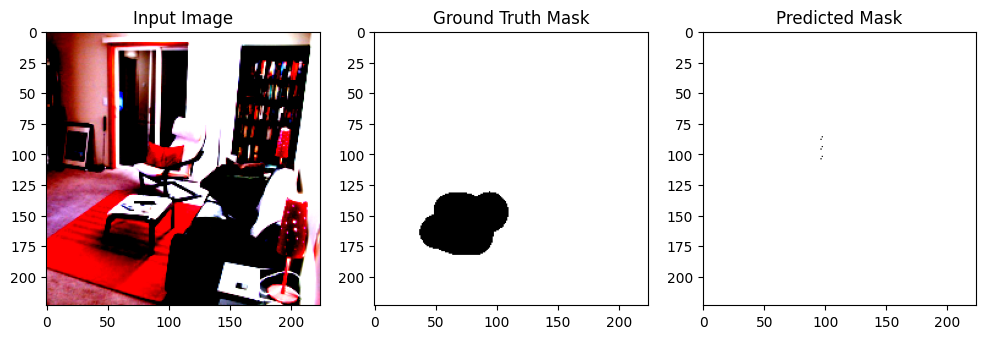

  1%|          | 1/138 [00:19<45:05, 19.75s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0755)


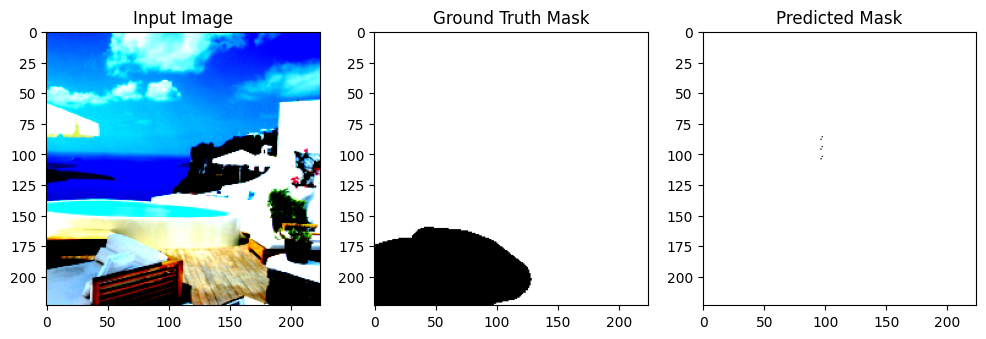

  1%|▏         | 2/138 [00:20<20:01,  8.83s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0614)


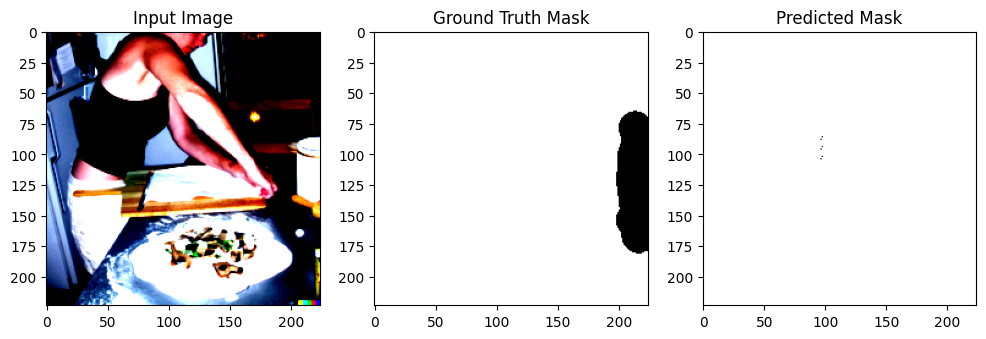

  2%|▏         | 3/138 [00:21<11:18,  5.03s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0869)


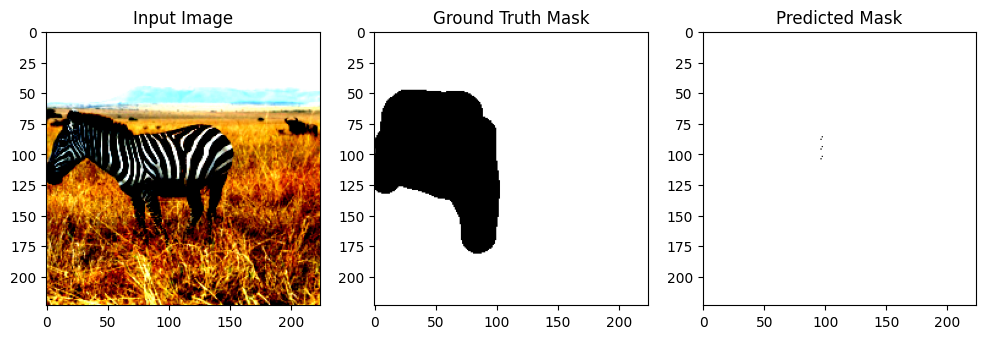

  3%|▎         | 4/138 [00:21<07:08,  3.20s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9980307..2.64].


tensor(0.0820)


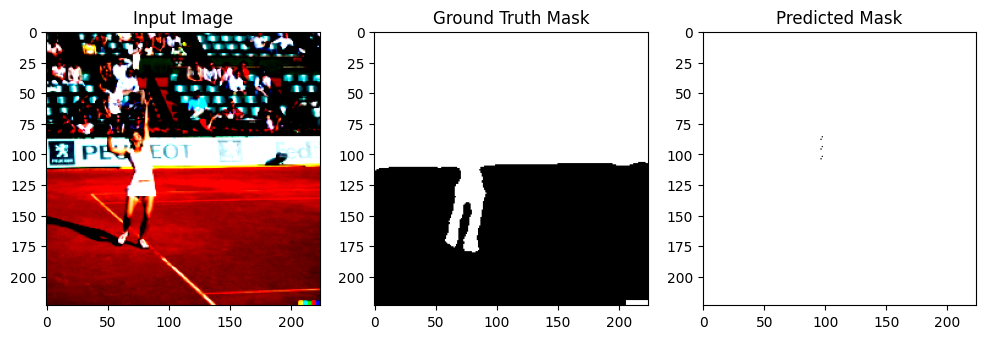

  4%|▎         | 5/138 [00:22<04:52,  2.20s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0843)


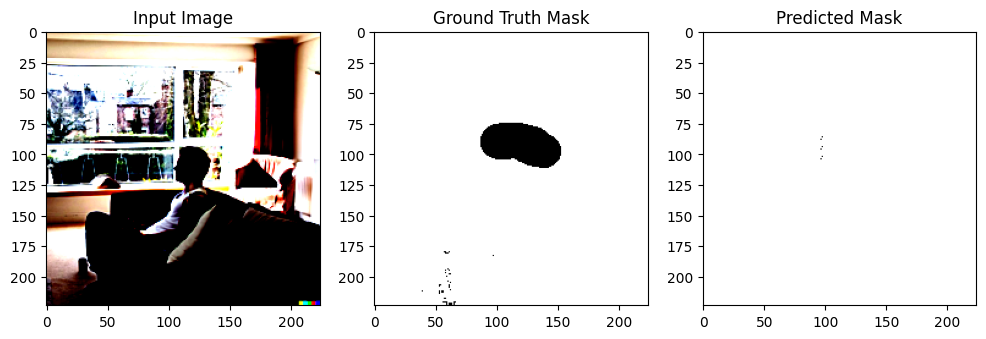

  4%|▍         | 6/138 [00:22<03:33,  1.62s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0357141..2.64].


tensor(0.0559)


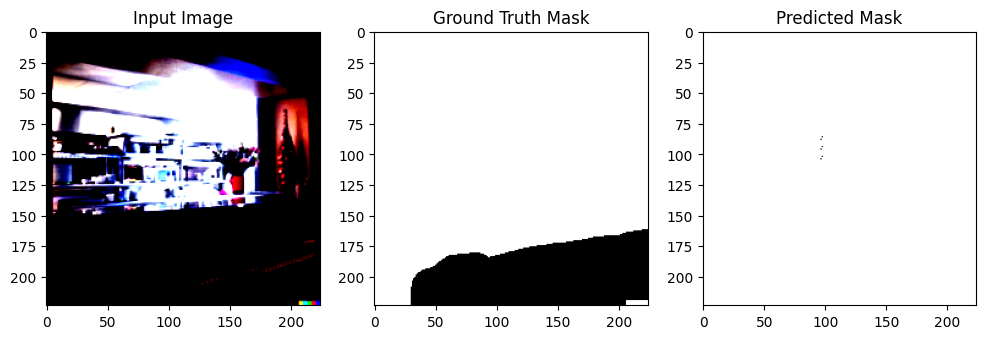

  5%|▌         | 7/138 [00:23<02:40,  1.23s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6384109..2.64].


tensor(0.1294)


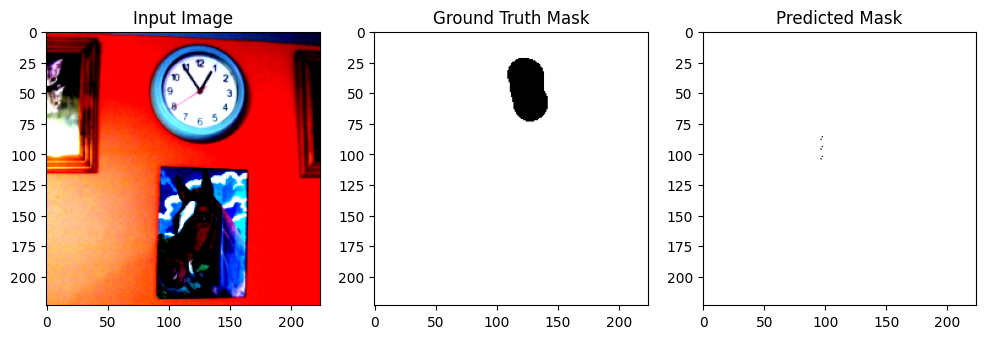

  6%|▌         | 8/138 [00:23<02:07,  1.02it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].


tensor(0.0603)


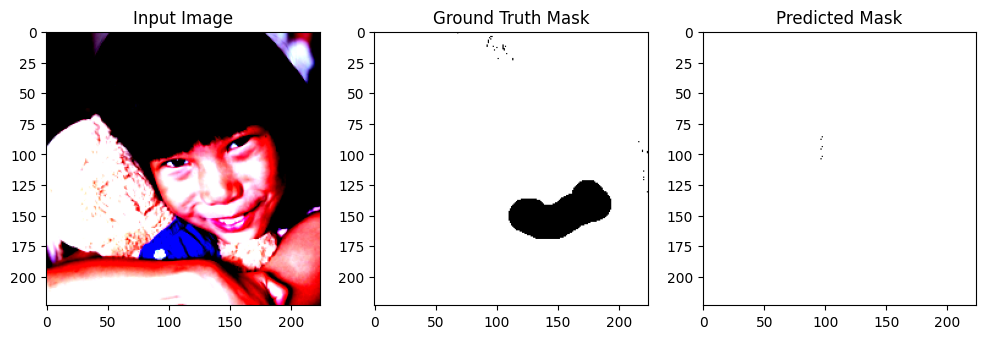

  7%|▋         | 9/138 [00:28<05:00,  2.33s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


tensor(0.0992)


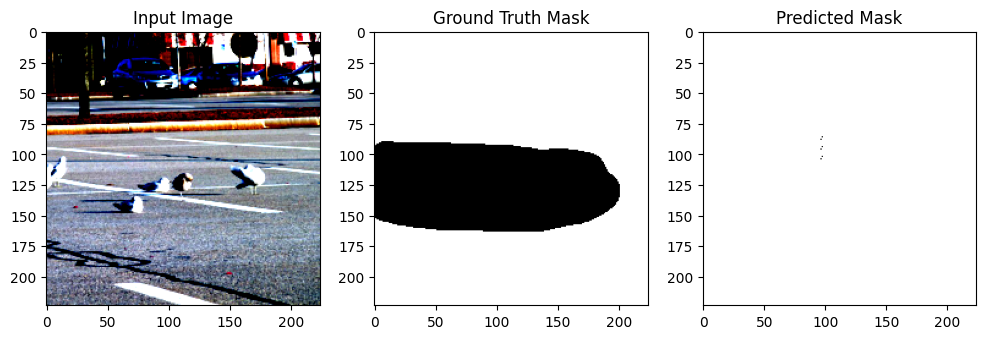

  7%|▋         | 10/138 [00:29<03:47,  1.78s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0613)


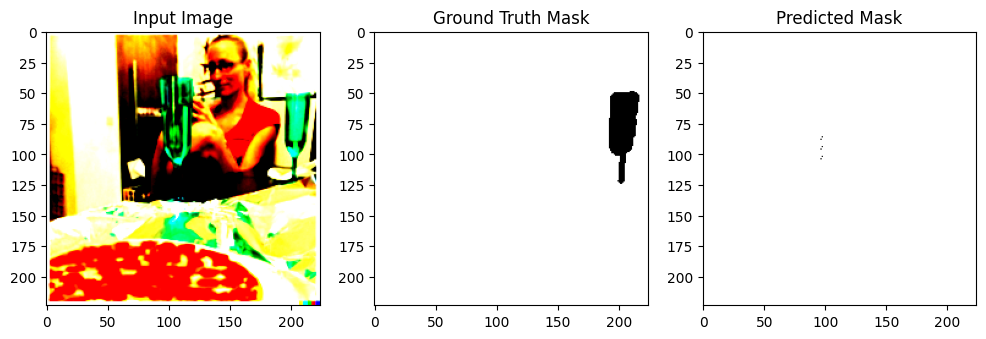

  8%|▊         | 11/138 [00:29<02:56,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0770)


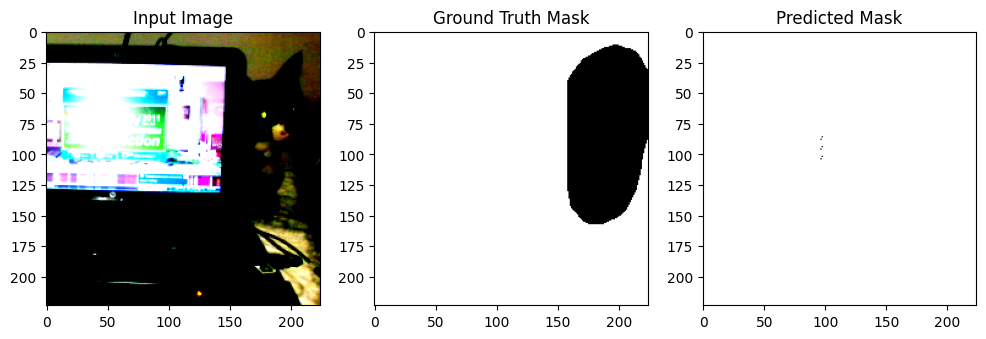

  9%|▊         | 12/138 [00:30<02:20,  1.11s/it]

tensor(0.0704)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


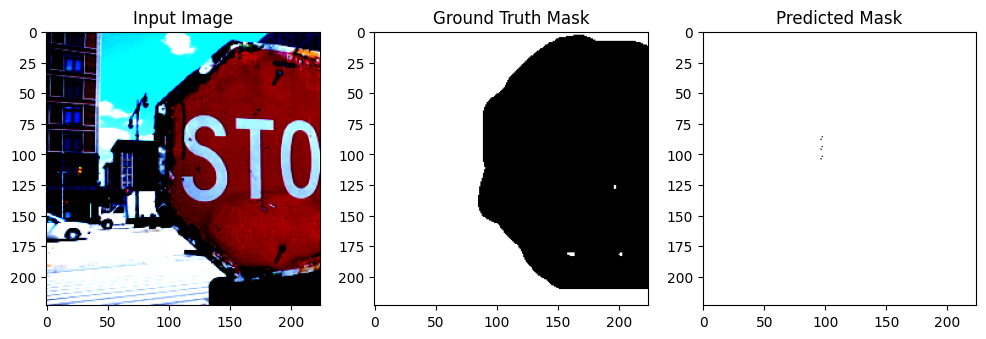

  9%|▉         | 13/138 [00:31<02:30,  1.20s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0322802..2.64].


tensor(0.0878)


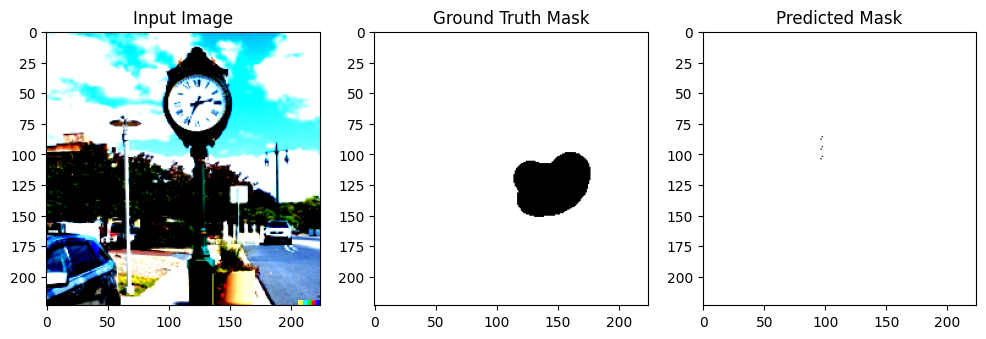

 10%|█         | 14/138 [00:32<02:02,  1.01it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9637812..2.5702832].


tensor(0.0959)


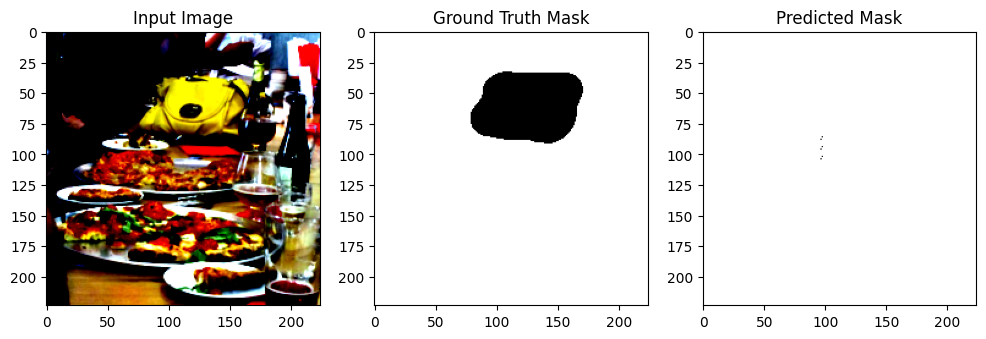

 11%|█         | 15/138 [00:32<01:43,  1.19it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.64].


tensor(0.0873)


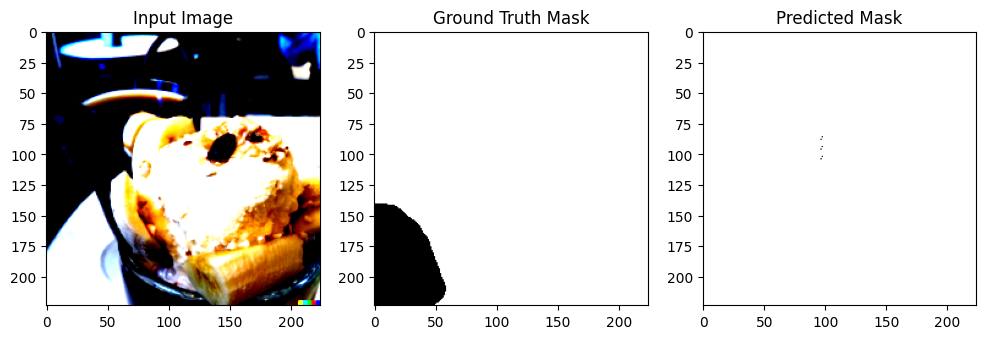

 12%|█▏        | 16/138 [00:33<01:30,  1.35it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9980307..2.64].


tensor(0.0532)


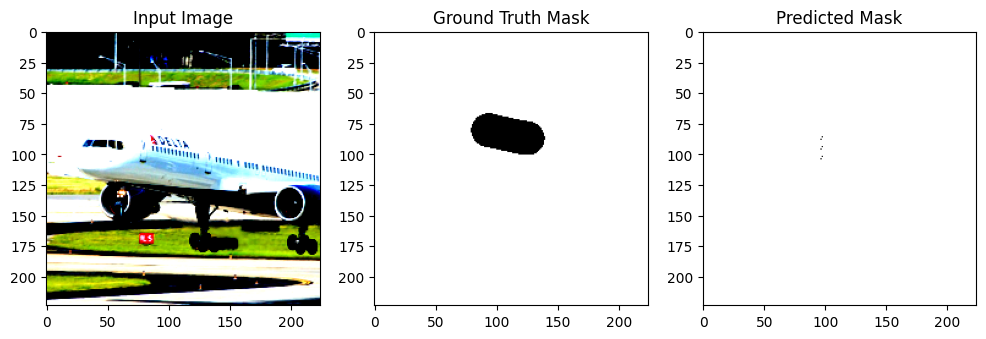

 12%|█▏        | 17/138 [00:44<07:31,  3.73s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0800)


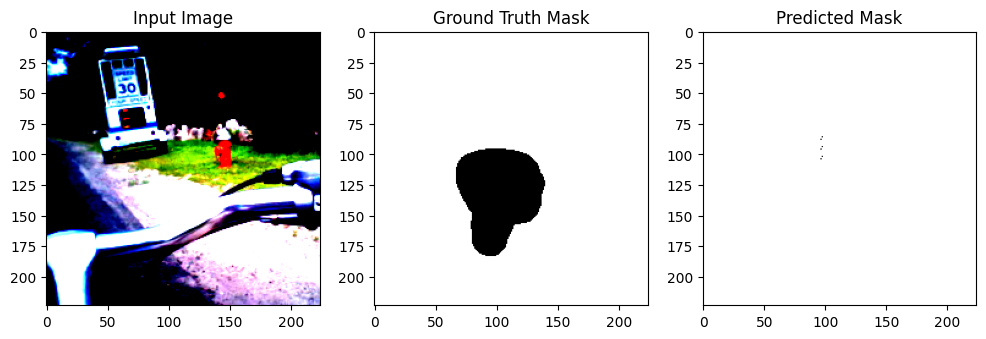

 13%|█▎        | 18/138 [00:44<05:30,  2.75s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0564)


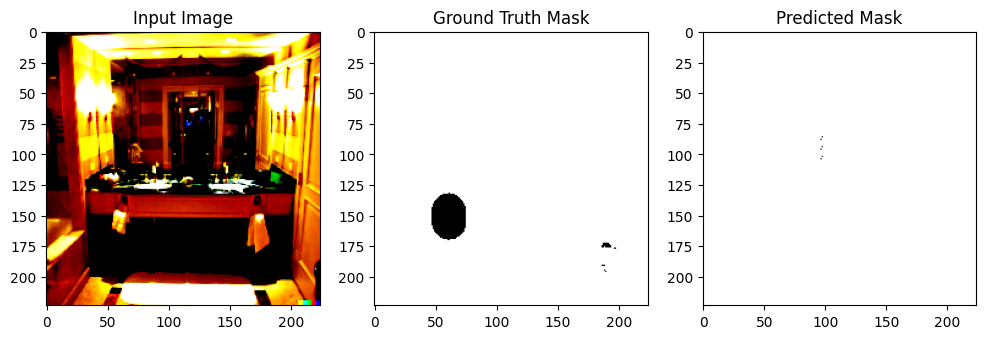

 14%|█▍        | 19/138 [00:45<04:05,  2.07s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


tensor(0.0796)


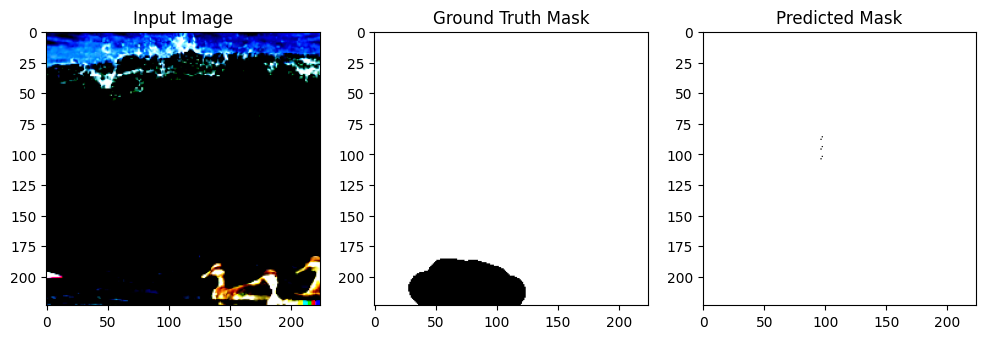

 14%|█▍        | 20/138 [00:45<03:05,  1.58s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0963)


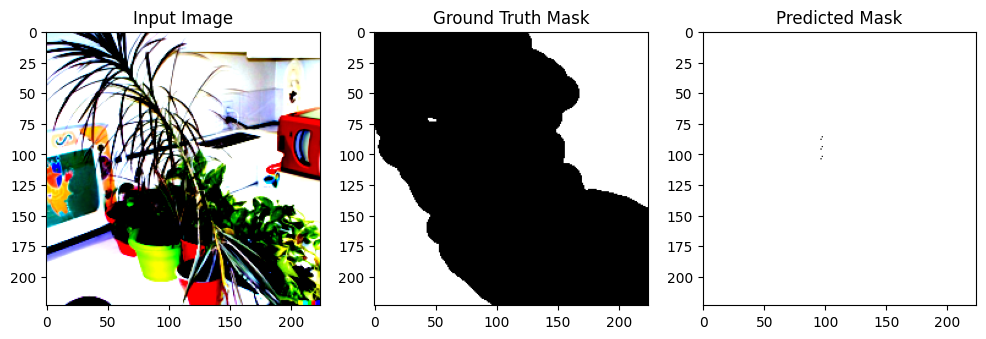

 15%|█▌        | 21/138 [00:45<02:27,  1.26s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8556864].


tensor(0.0884)


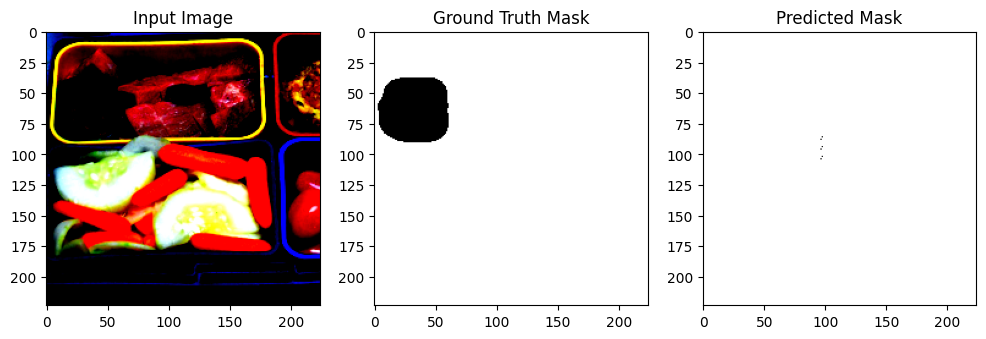

 16%|█▌        | 22/138 [00:46<01:59,  1.03s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0812)


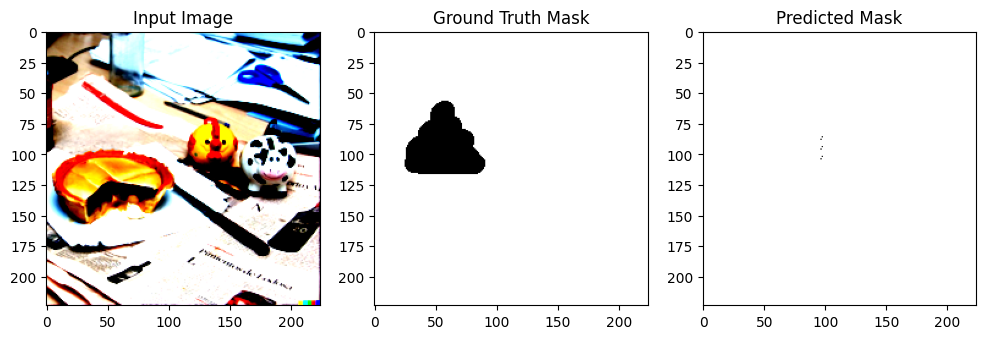

 17%|█▋        | 23/138 [00:46<01:41,  1.14it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0505)


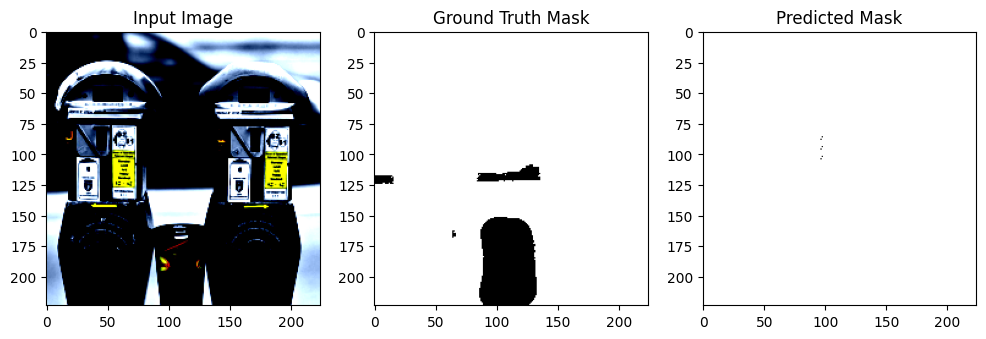

 17%|█▋        | 24/138 [00:47<01:26,  1.31it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0919)


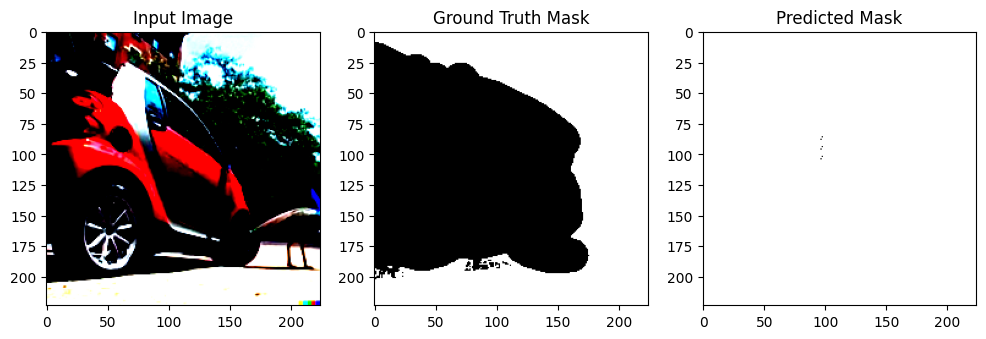

 18%|█▊        | 25/138 [00:59<07:56,  4.22s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9980307..2.64].


tensor(0.0863)


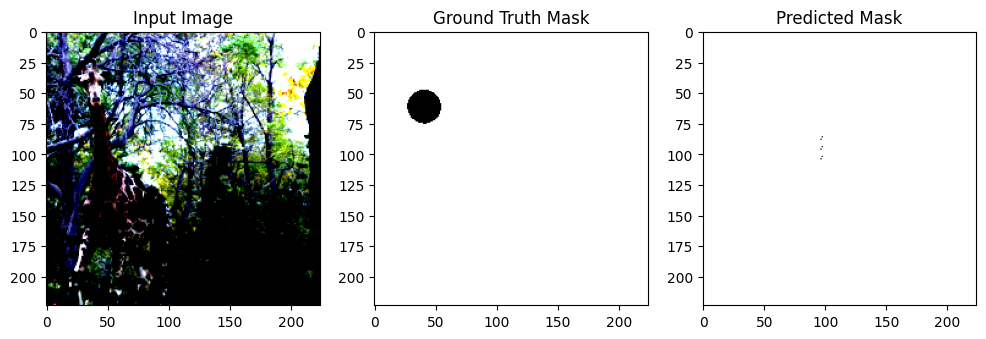

 19%|█▉        | 26/138 [01:00<05:48,  3.12s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9637812..2.64].


tensor(0.0719)


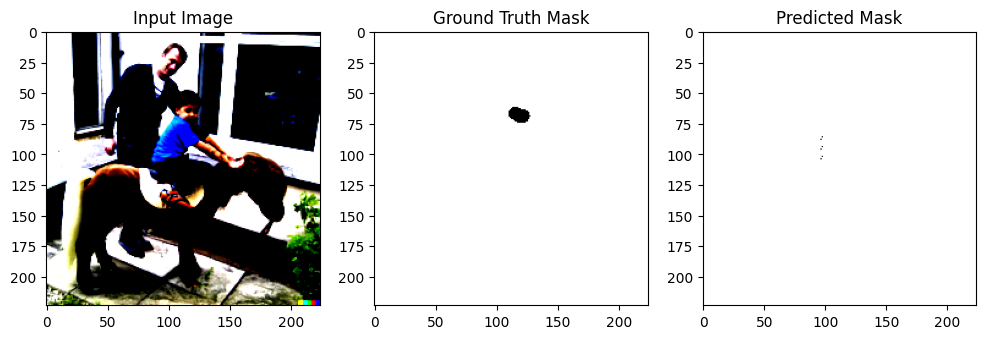

 20%|█▉        | 27/138 [01:00<04:20,  2.35s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.64].


tensor(0.0982)


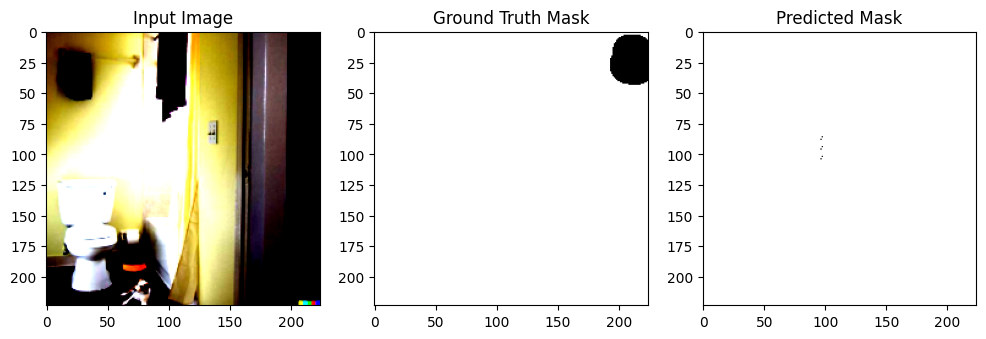

 20%|██        | 28/138 [01:01<03:17,  1.80s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.980906..2.64].


tensor(0.0763)


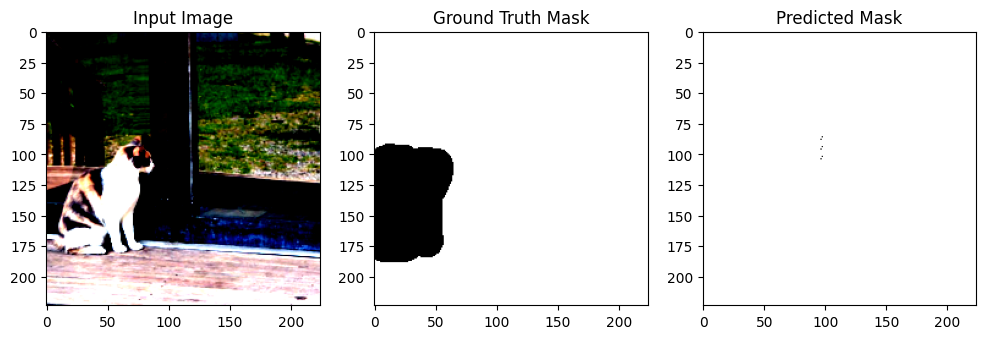

 21%|██        | 29/138 [01:01<02:36,  1.44s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.465708].


tensor(0.0797)


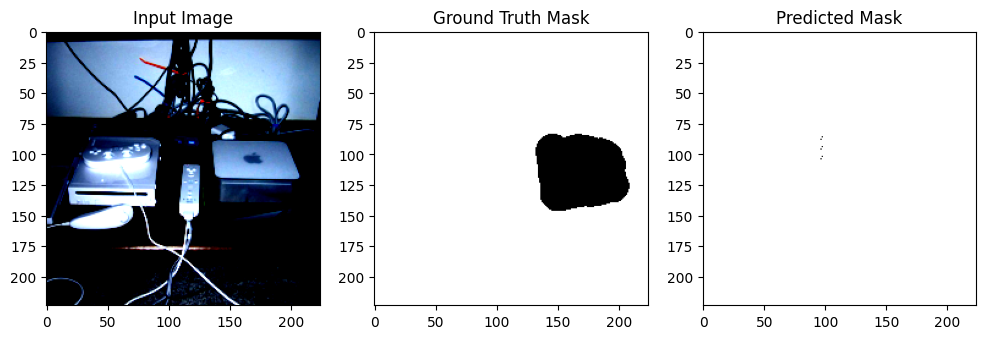

 22%|██▏       | 30/138 [01:02<02:07,  1.18s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.1087)


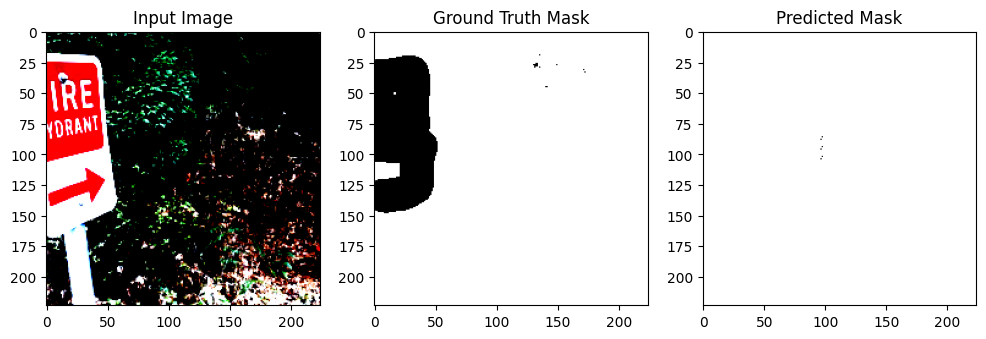

 22%|██▏       | 31/138 [01:03<01:48,  1.01s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.2739873].


tensor(0.0970)


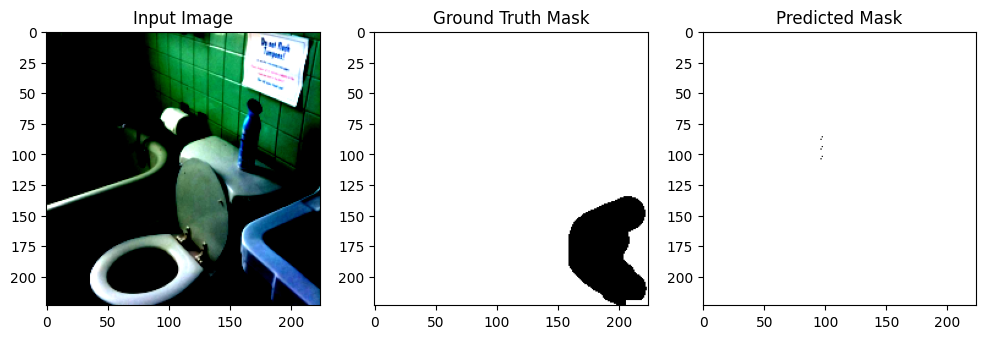

 23%|██▎       | 32/138 [01:03<01:32,  1.14it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..2.64].


tensor(0.0844)


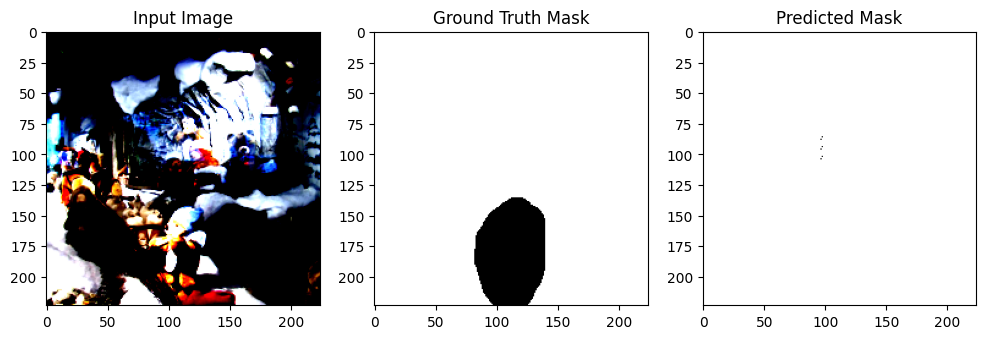

 24%|██▍       | 33/138 [01:14<06:57,  3.98s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9466565..2.64].


tensor(0.0952)


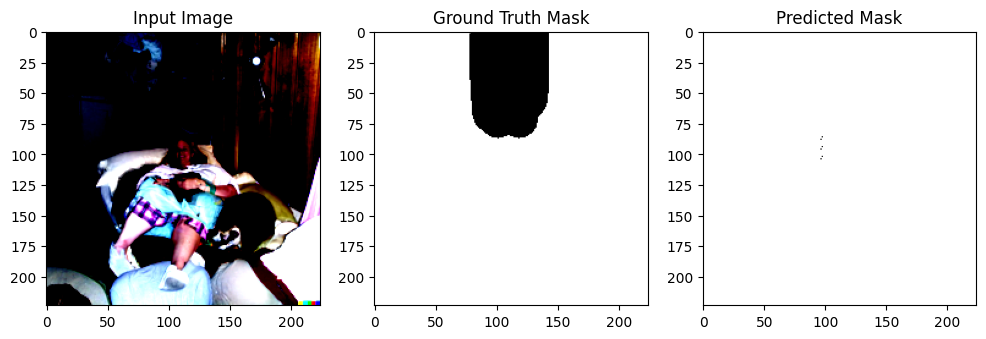

 25%|██▍       | 34/138 [01:15<05:06,  2.95s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.64].


tensor(0.0892)


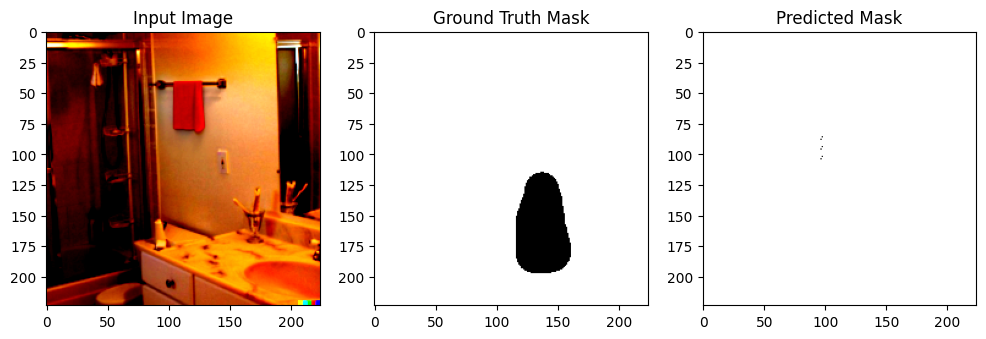

 25%|██▌       | 35/138 [01:16<03:54,  2.28s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0772)


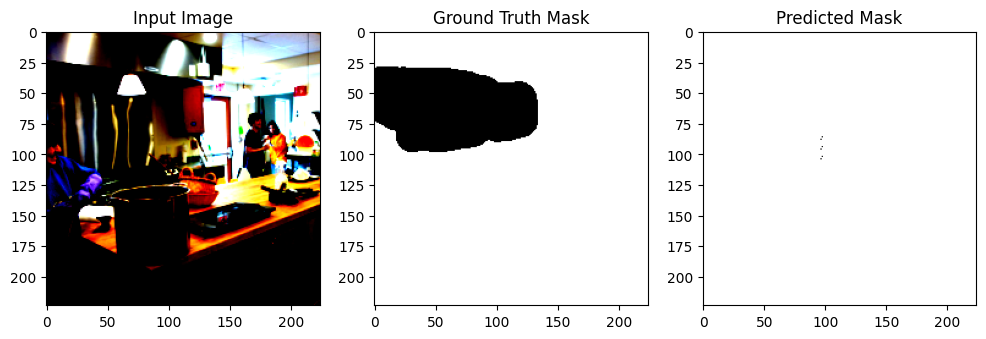

 26%|██▌       | 36/138 [01:16<02:59,  1.76s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


tensor(0.0636)


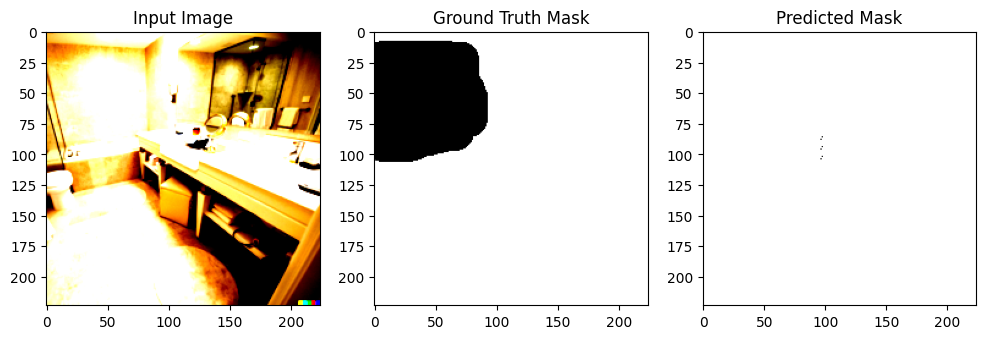

 27%|██▋       | 37/138 [01:17<02:19,  1.38s/it]

tensor(0.0835)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


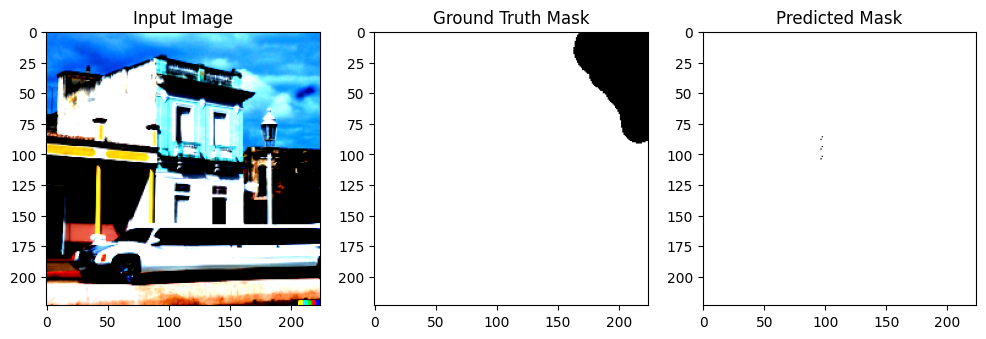

 28%|██▊       | 38/138 [01:18<02:03,  1.23s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.343704].


tensor(0.0955)


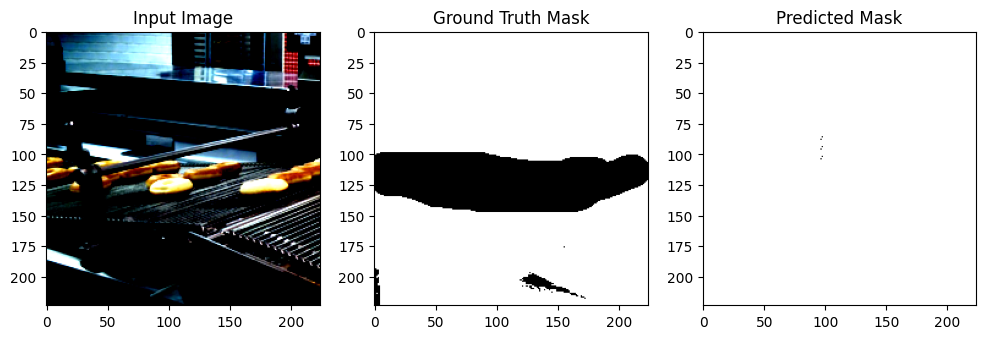

 28%|██▊       | 39/138 [01:18<01:40,  1.01s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.980906..2.64].


tensor(0.0684)


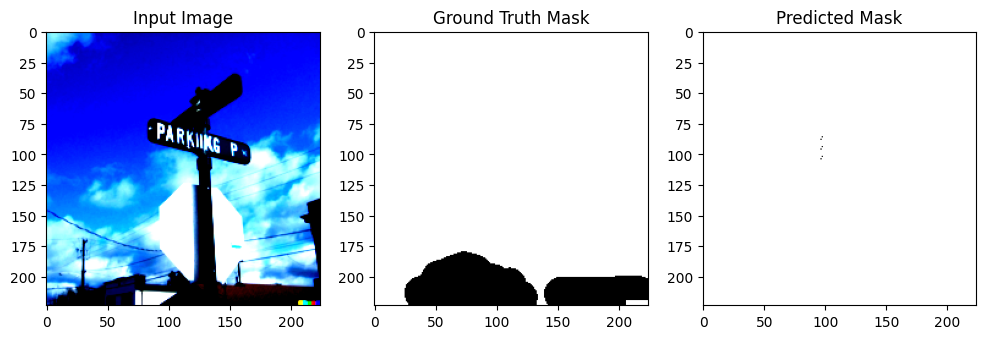

 29%|██▉       | 40/138 [01:19<01:24,  1.16it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0526)


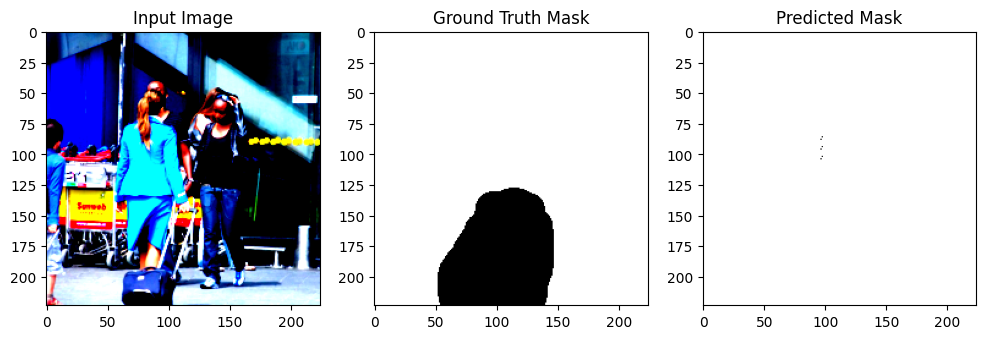

 30%|██▉       | 41/138 [01:30<06:25,  3.98s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0722)


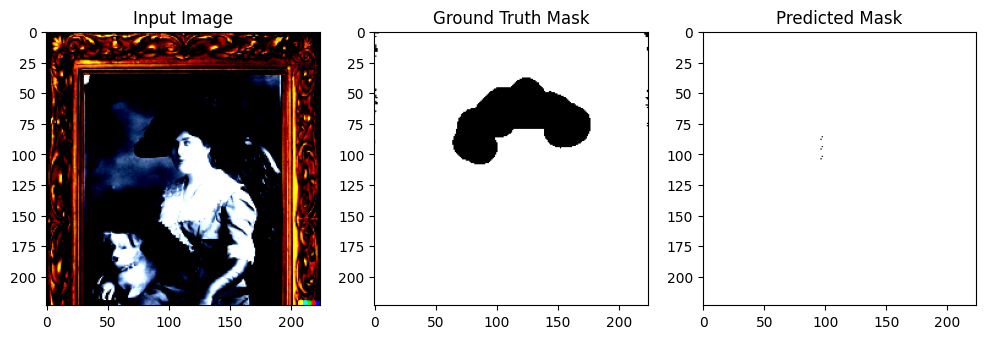

 30%|███       | 42/138 [01:30<04:44,  2.96s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


tensor(0.0932)


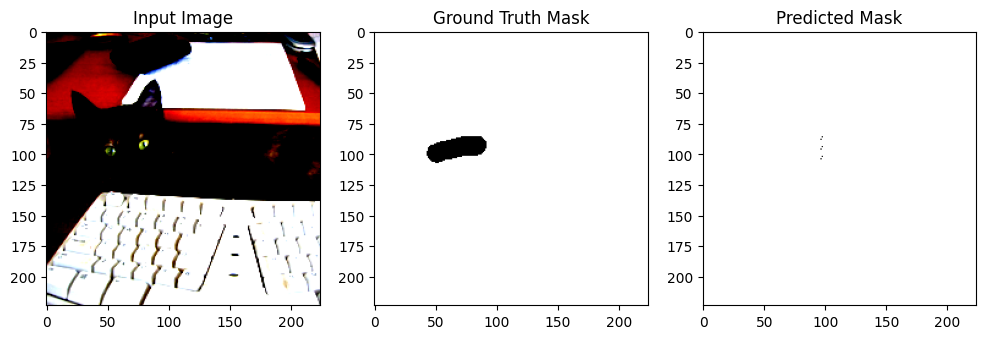

 31%|███       | 43/138 [01:31<03:30,  2.21s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0748)


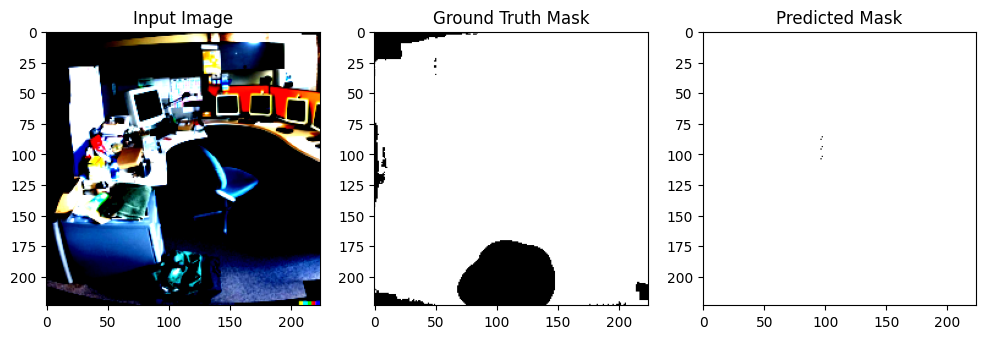

 32%|███▏      | 44/138 [01:31<02:41,  1.72s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].


tensor(0.0691)


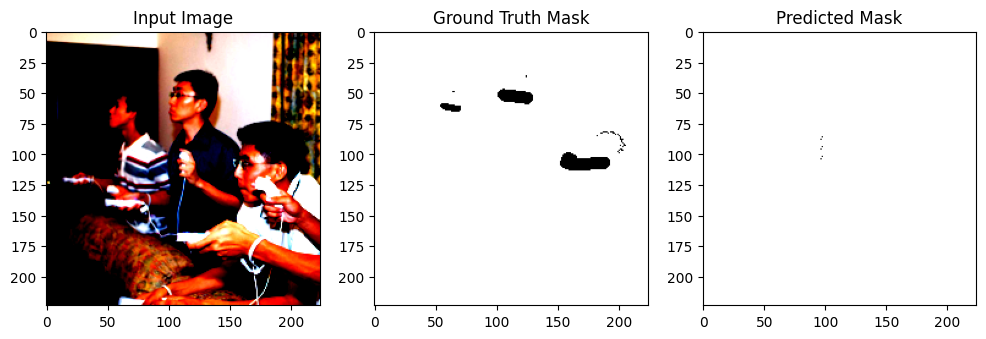

 33%|███▎      | 45/138 [01:32<02:06,  1.36s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.980906..2.622571].


tensor(0.0610)


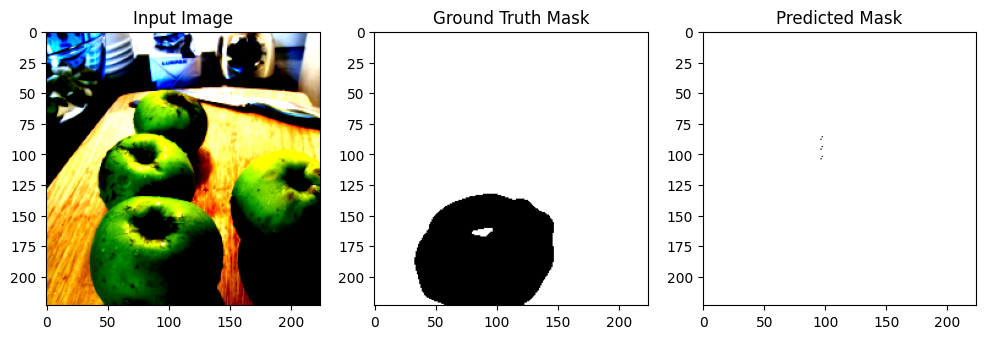

 33%|███▎      | 46/138 [01:33<01:43,  1.12s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0679)


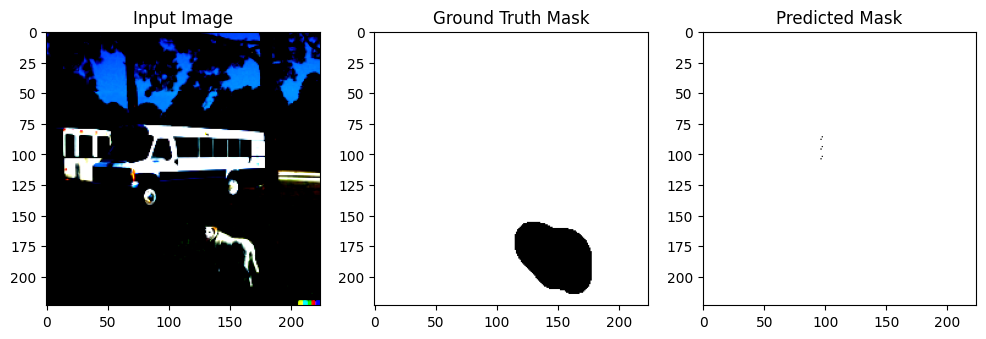

 34%|███▍      | 47/138 [01:33<01:26,  1.05it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.622571].


tensor(0.0639)


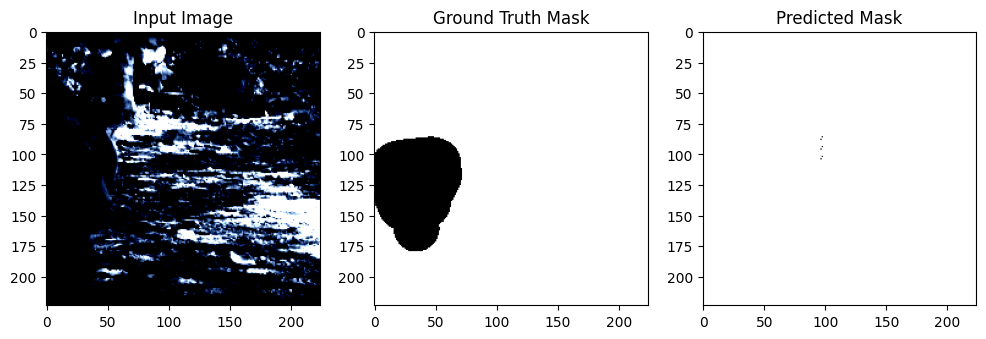

 35%|███▍      | 48/138 [01:34<01:13,  1.22it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.343704].


tensor(0.0796)


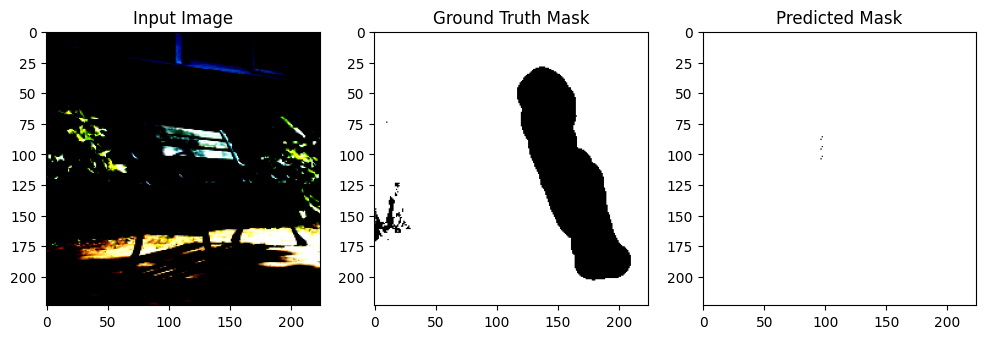

 36%|███▌      | 49/138 [01:45<05:54,  3.98s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7069099..2.2042704].


tensor(0.0720)


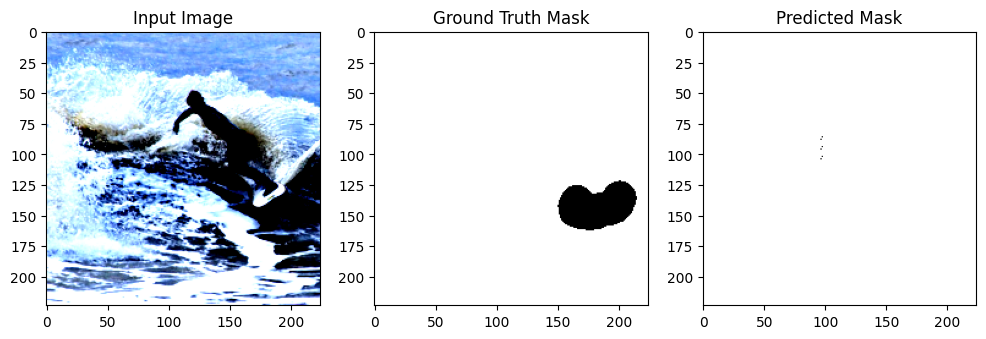

 36%|███▌      | 50/138 [01:46<04:22,  2.98s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.64].


tensor(0.0845)


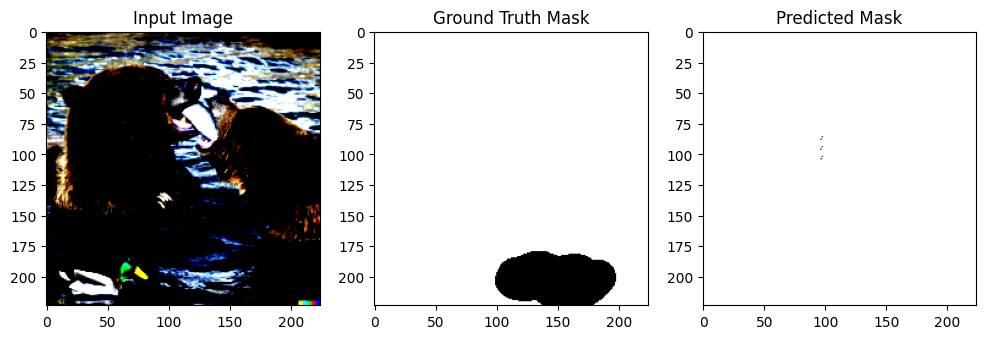

 37%|███▋      | 51/138 [01:47<03:24,  2.36s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


tensor(0.0750)


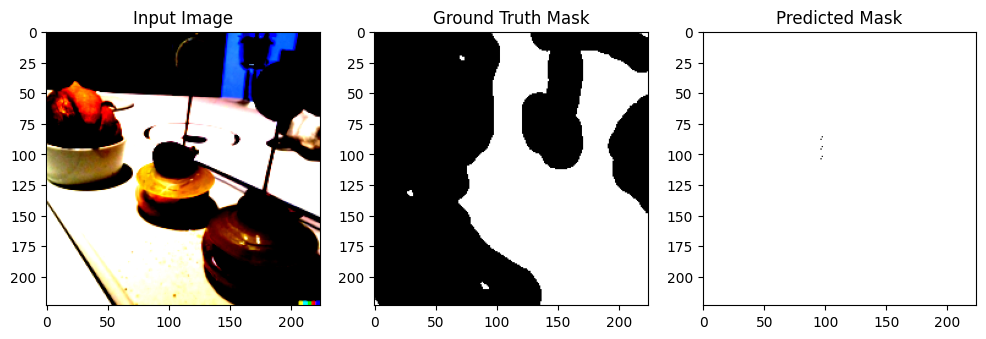

 38%|███▊      | 52/138 [01:47<02:35,  1.81s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0533)


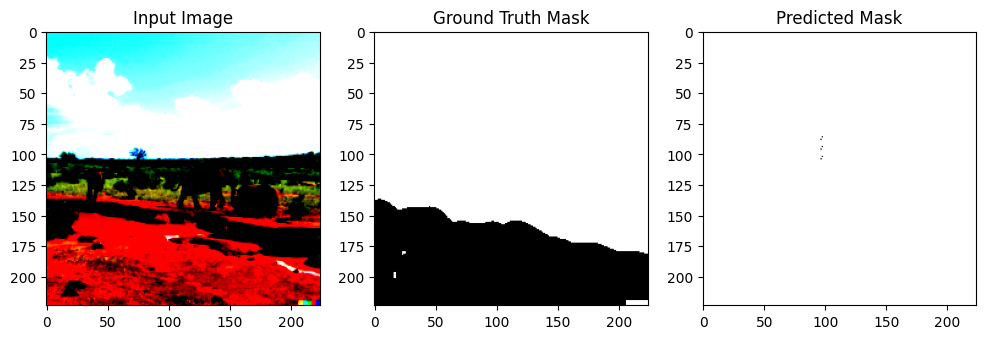

 38%|███▊      | 53/138 [01:48<02:04,  1.46s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0574)


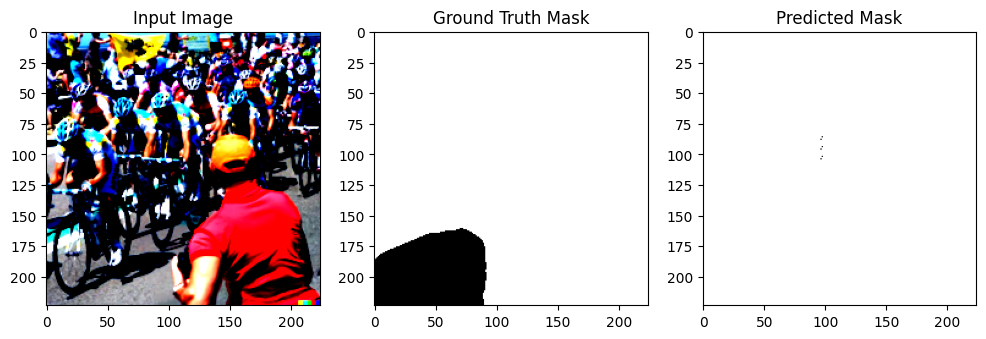

 39%|███▉      | 54/138 [01:48<01:38,  1.18s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.64].


tensor(0.1042)


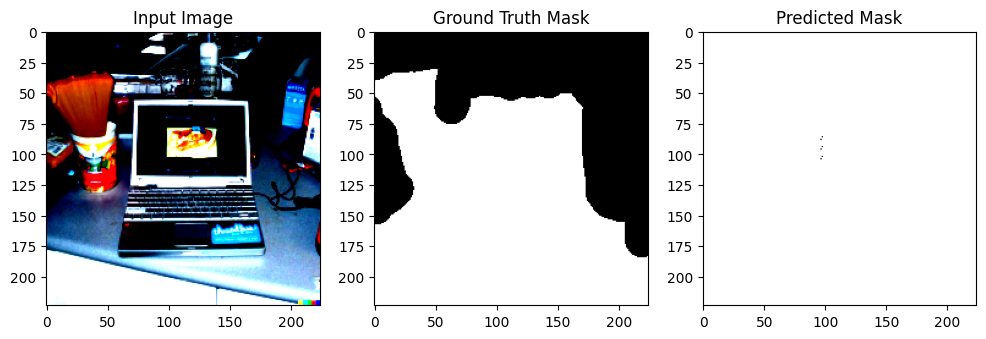

 40%|███▉      | 55/138 [01:49<01:22,  1.00it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.64].


tensor(0.0880)


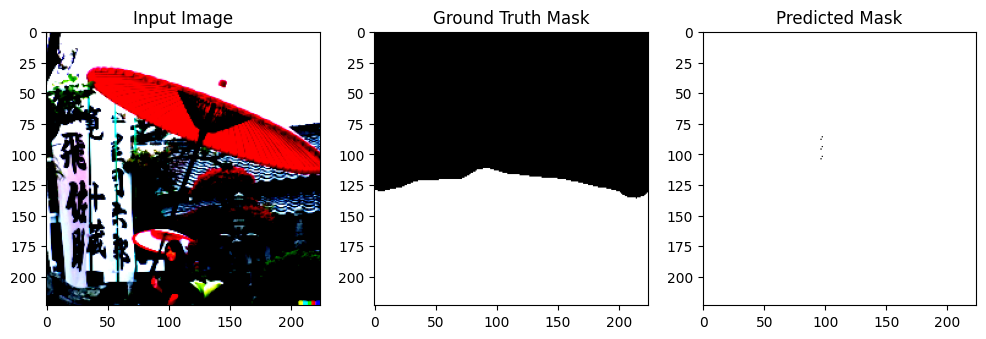

 41%|████      | 56/138 [01:49<01:11,  1.15it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0573)


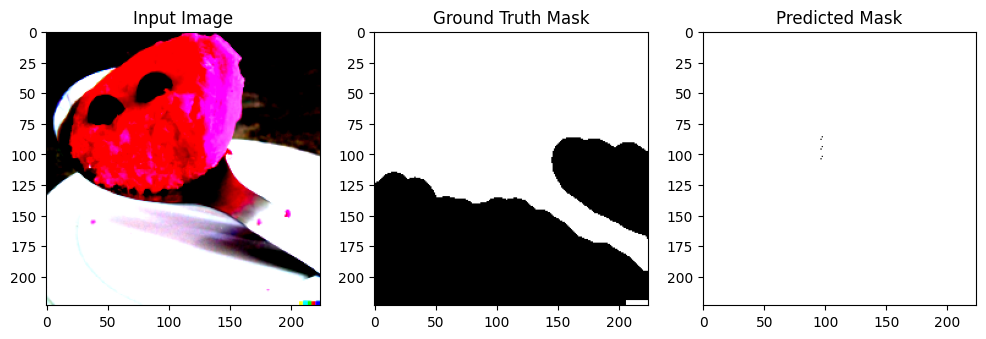

 41%|████▏     | 57/138 [02:00<05:11,  3.85s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0687)


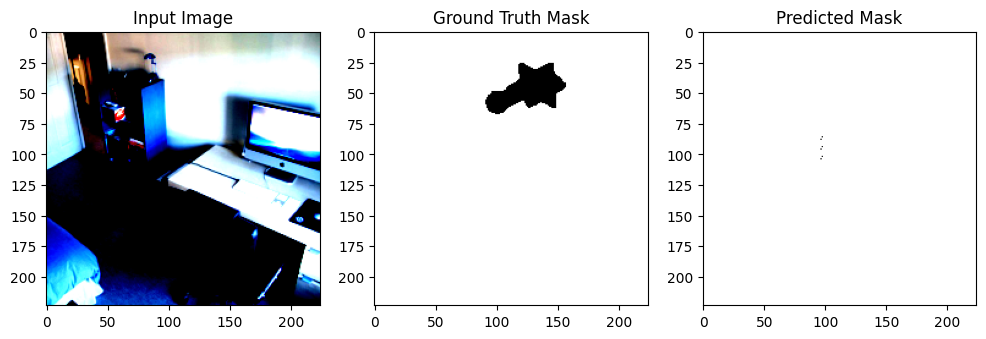

 42%|████▏     | 58/138 [02:01<03:49,  2.87s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9124069..2.622571].


tensor(0.0753)


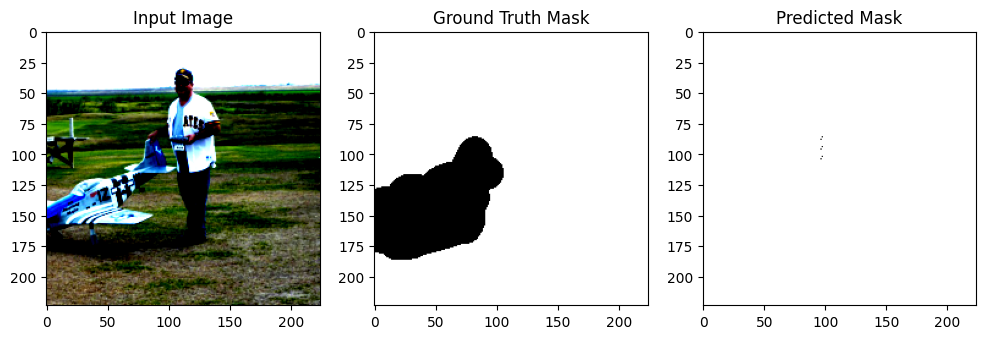

 43%|████▎     | 59/138 [02:01<02:51,  2.17s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0007002..2.2739873].


tensor(0.1114)


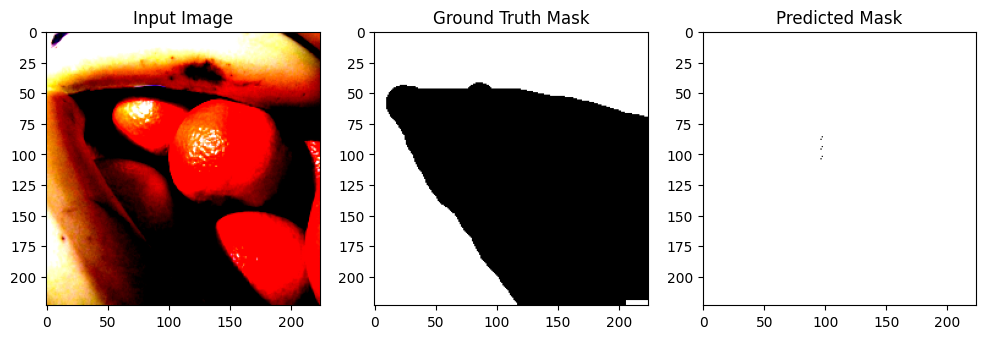

 43%|████▎     | 60/138 [02:02<02:11,  1.68s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0322802..2.622571].


tensor(0.1118)


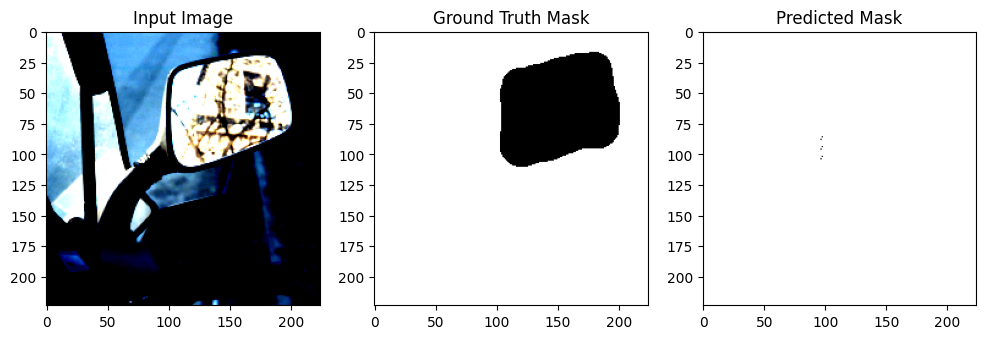

 44%|████▍     | 61/138 [02:02<01:43,  1.35s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0840)


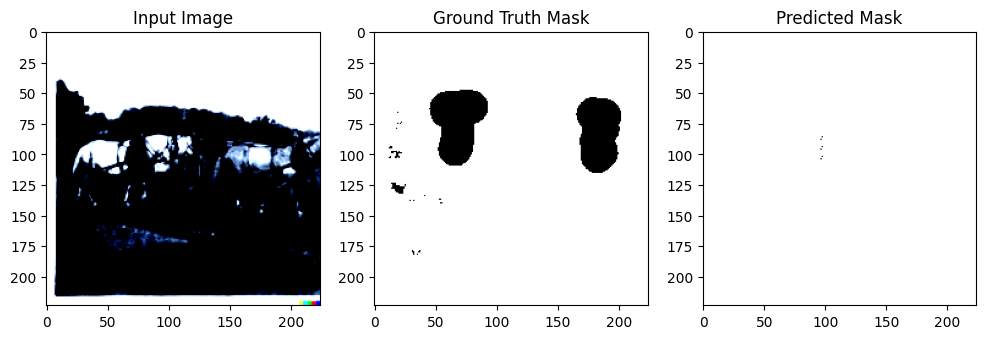

 45%|████▍     | 62/138 [02:03<01:24,  1.11s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0151556..2.2489083].


tensor(0.0909)


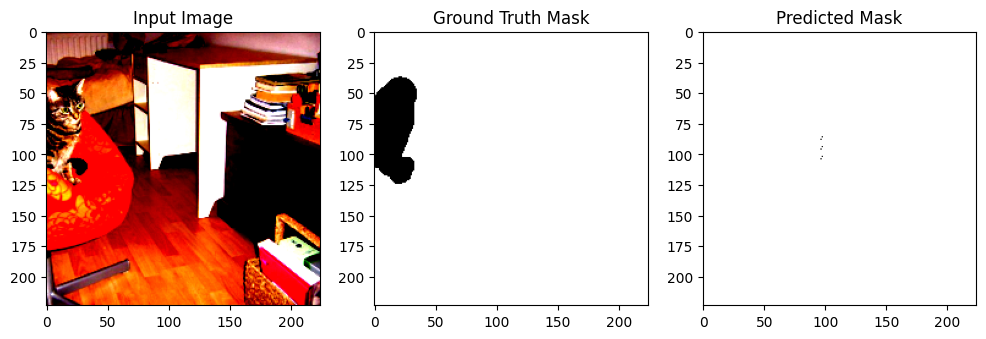

 46%|████▌     | 63/138 [02:04<01:10,  1.06it/s]

tensor(0.0869)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0357141..2.64].


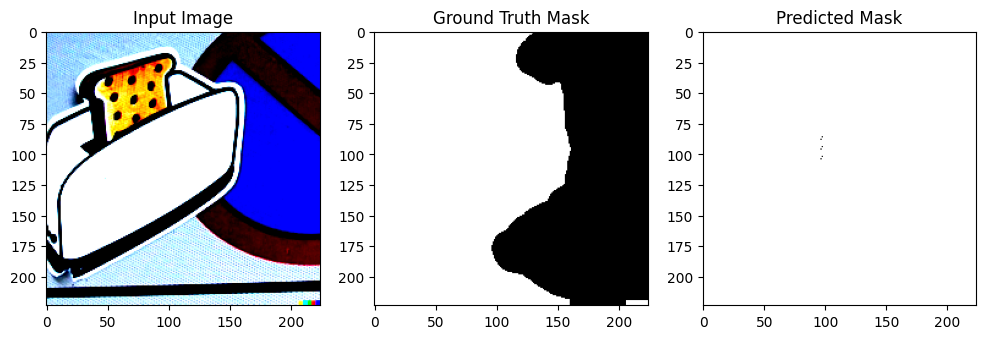

 46%|████▋     | 64/138 [02:05<01:10,  1.04it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9980307..2.64].


tensor(0.0733)


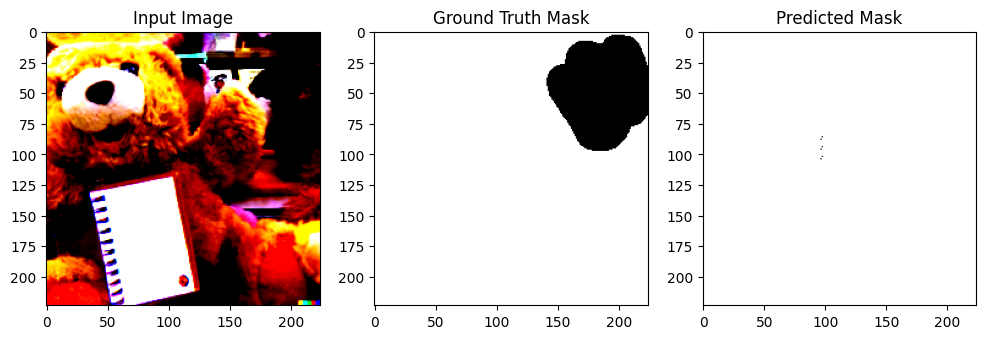

 47%|████▋     | 65/138 [02:15<04:47,  3.94s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0828)


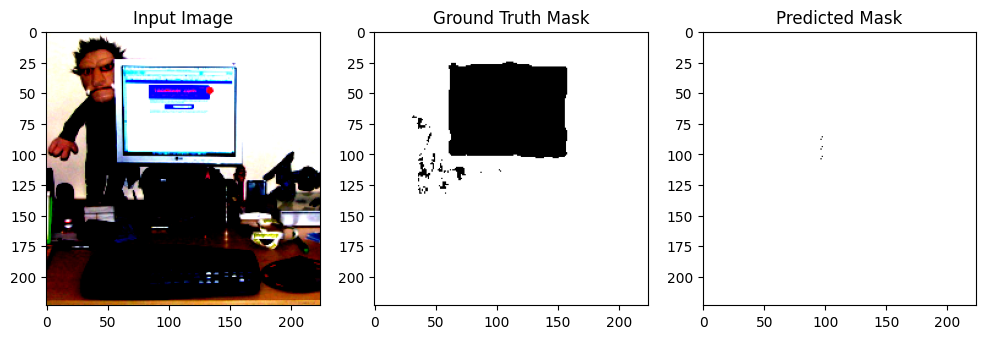

 48%|████▊     | 66/138 [02:16<03:31,  2.93s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.186841].


tensor(0.1000)


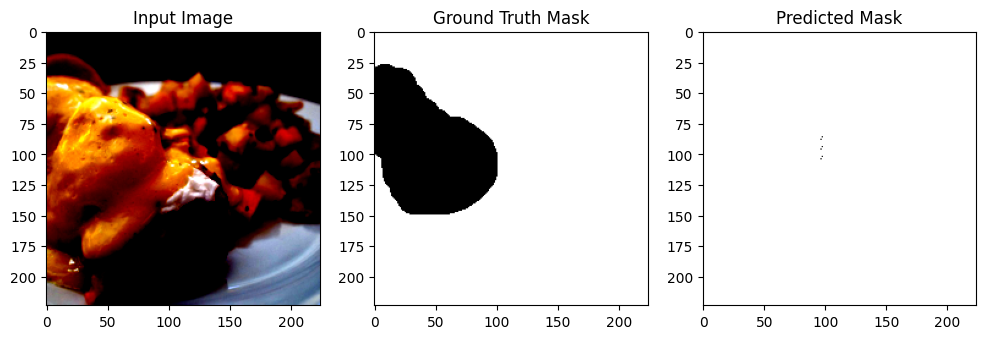

 49%|████▊     | 67/138 [02:17<02:37,  2.21s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.0262864].


tensor(0.0736)


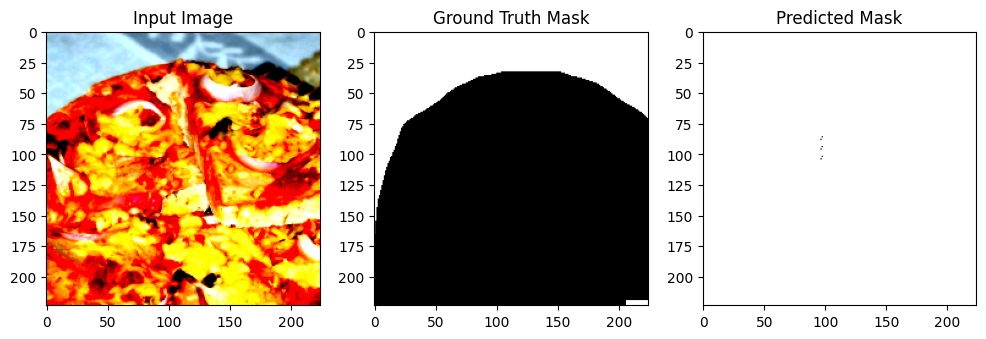

 49%|████▉     | 68/138 [02:17<01:59,  1.71s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


tensor(0.1054)


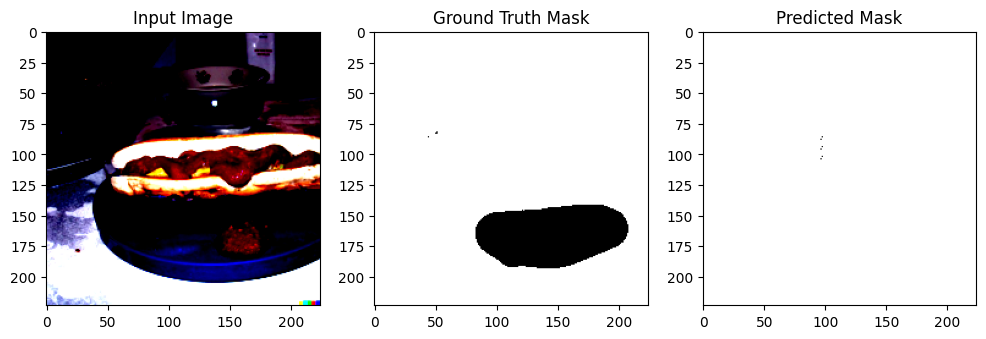

 50%|█████     | 69/138 [02:18<01:33,  1.36s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0902)


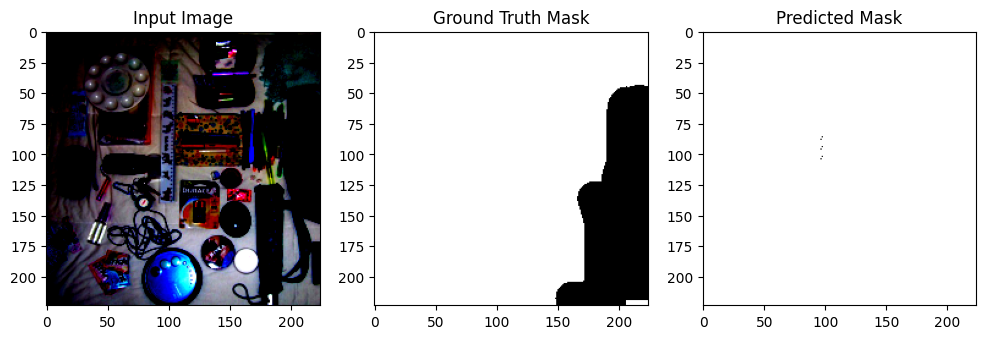

 51%|█████     | 70/138 [02:18<01:15,  1.12s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.64].


tensor(0.0524)


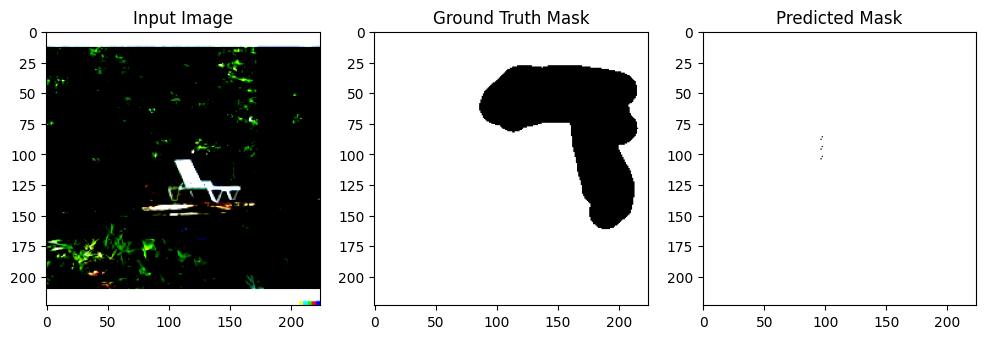

 51%|█████▏    | 71/138 [02:19<01:03,  1.06it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.980906..2.5702832].


tensor(0.0950)


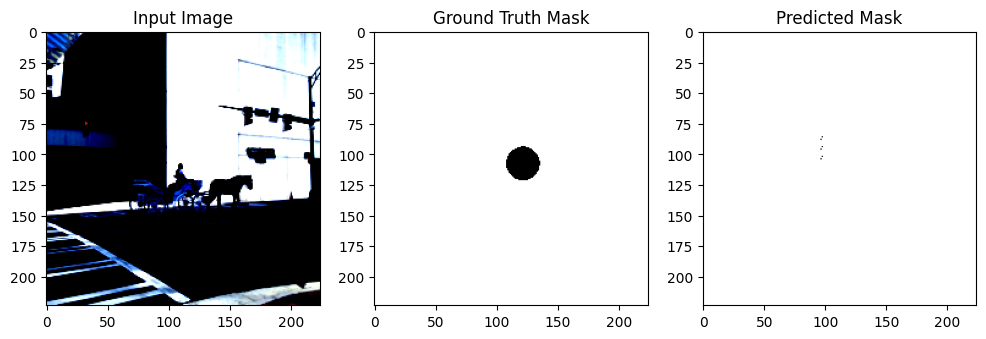

 52%|█████▏    | 72/138 [02:19<00:53,  1.22it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0182073..2.64].


tensor(0.0731)


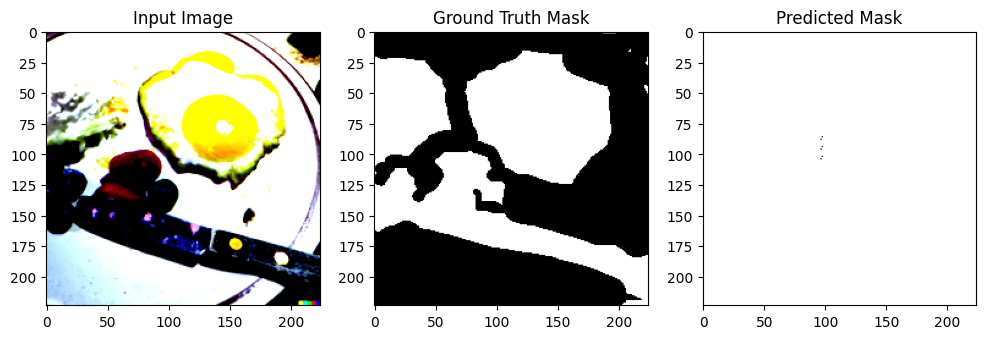

 53%|█████▎    | 73/138 [02:31<04:19,  3.99s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0552)


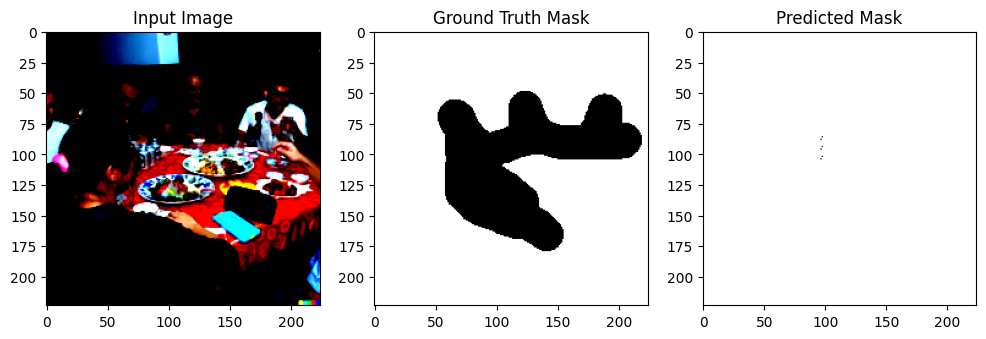

 54%|█████▎    | 74/138 [02:31<03:08,  2.95s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.622571].


tensor(0.0840)


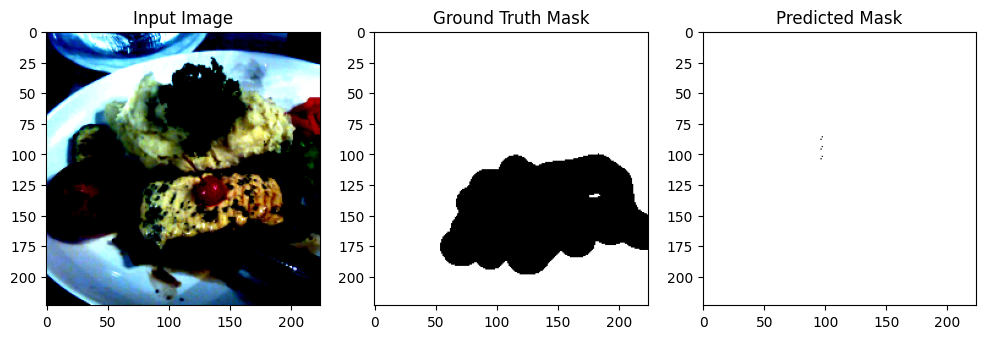

 54%|█████▍    | 75/138 [02:32<02:20,  2.23s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0151556..2.64].


tensor(0.0684)


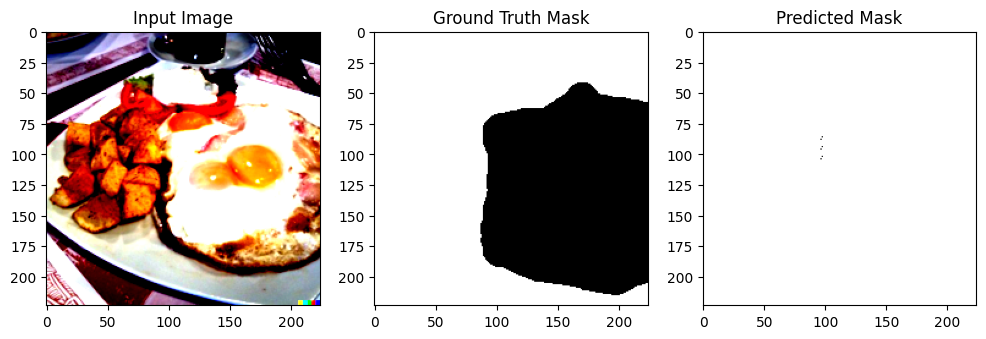

 55%|█████▌    | 76/138 [02:33<01:53,  1.83s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0151556..2.64].


tensor(0.1068)


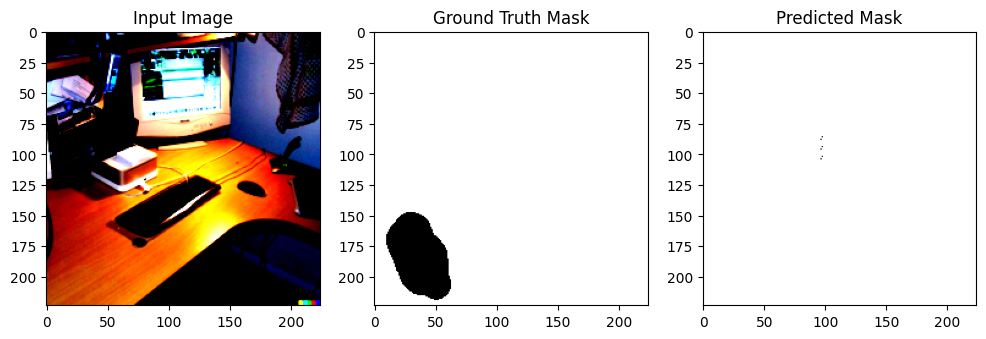

 56%|█████▌    | 77/138 [02:33<01:29,  1.46s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8952821..2.64].


tensor(0.0667)


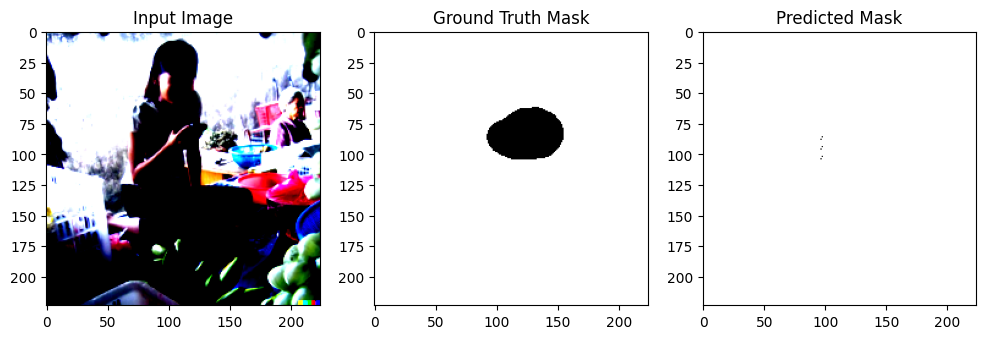

 57%|█████▋    | 78/138 [02:34<01:12,  1.21s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].


tensor(0.0922)


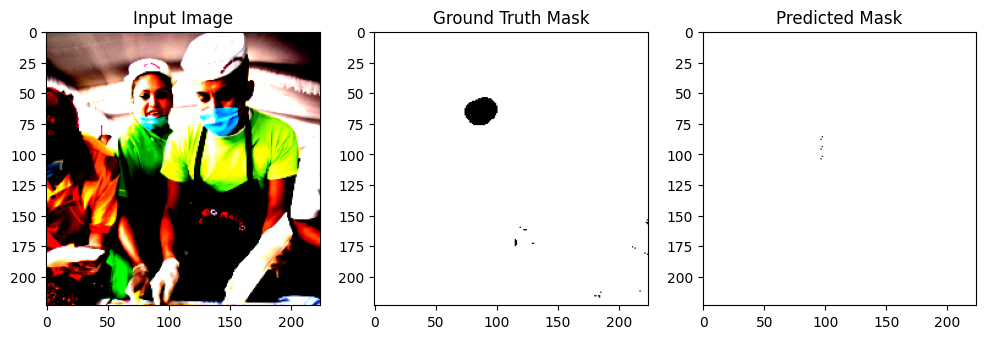

 57%|█████▋    | 79/138 [02:34<01:00,  1.02s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.64].


tensor(0.0787)


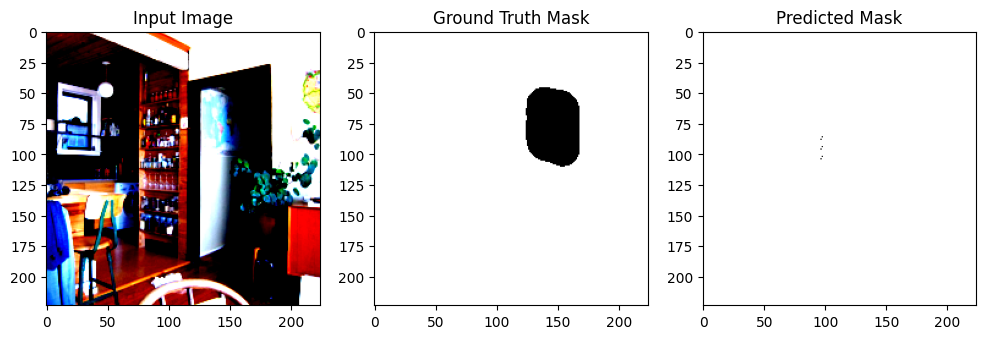

 58%|█████▊    | 80/138 [02:35<00:50,  1.14it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9124069..2.64].


tensor(0.0850)


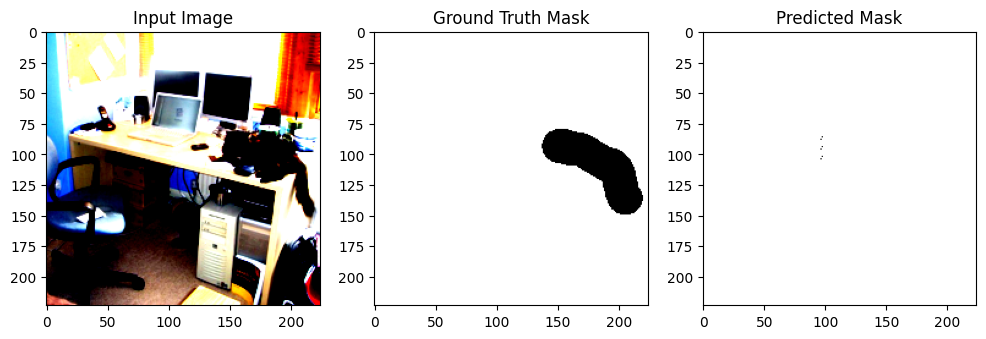

 59%|█████▊    | 81/138 [02:46<03:51,  4.07s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.1085)


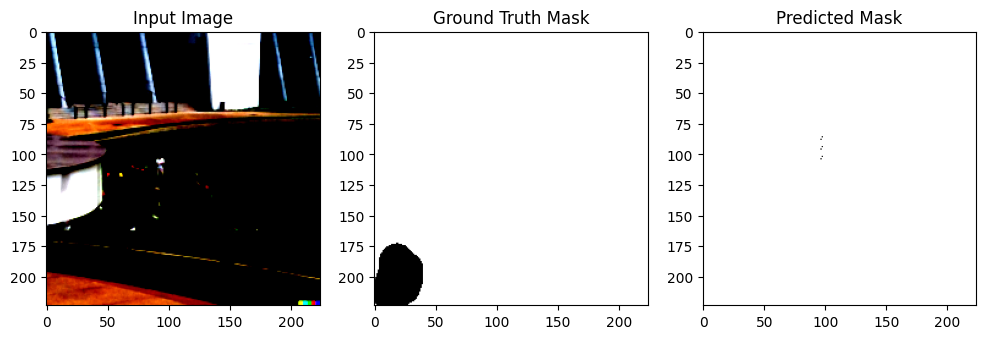

 59%|█████▉    | 82/138 [02:47<02:48,  3.00s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9481792..2.64].


tensor(0.0629)


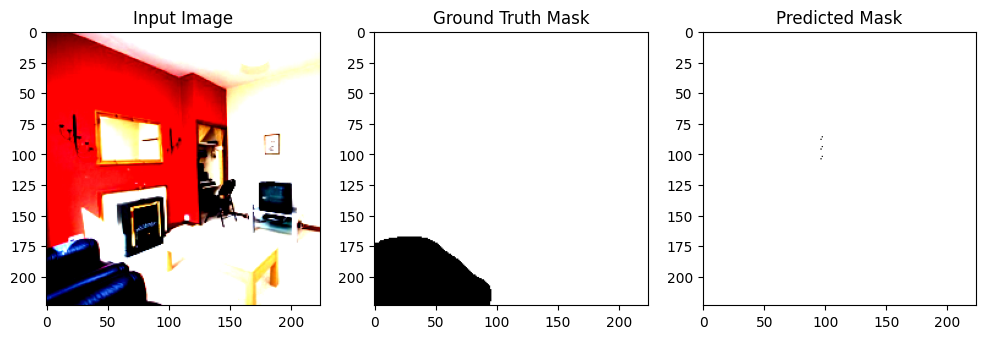

 60%|██████    | 83/138 [02:48<02:06,  2.30s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.4157891..2.2914162].


tensor(0.0519)


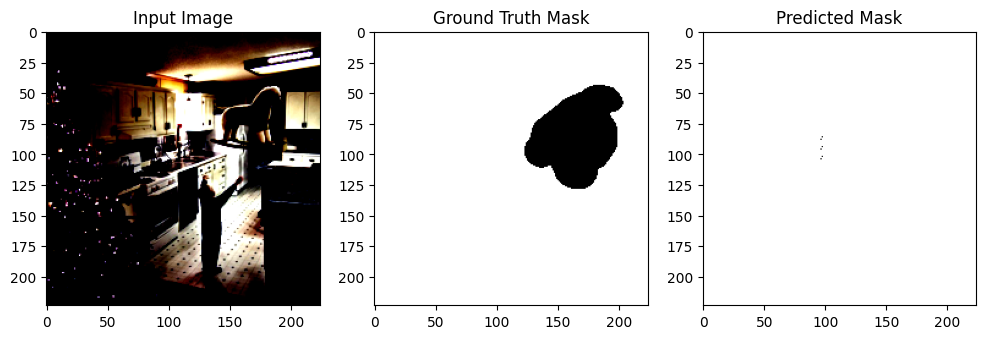

 61%|██████    | 84/138 [02:48<01:38,  1.83s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..2.2565577].


tensor(0.0890)


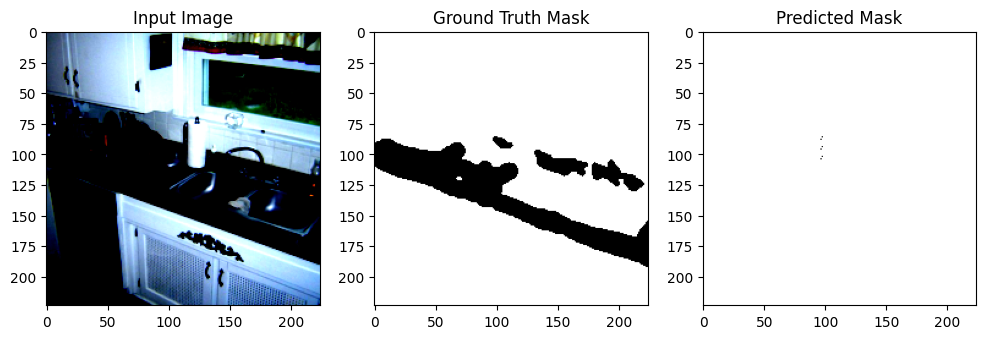

 62%|██████▏   | 85/138 [02:49<01:17,  1.47s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0789)


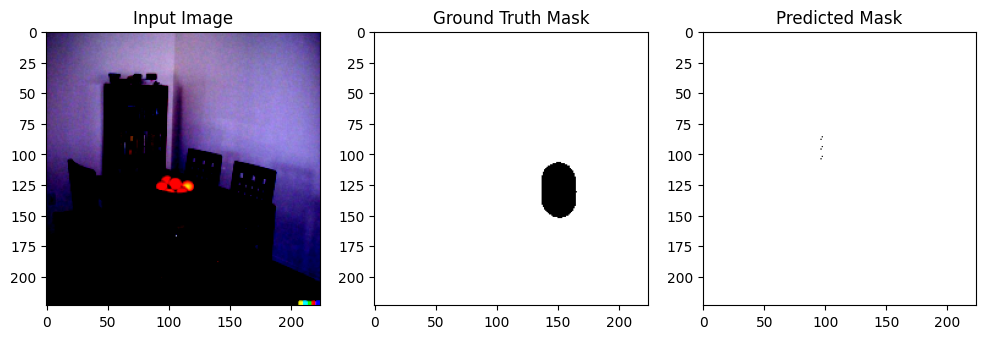

 62%|██████▏   | 86/138 [02:50<01:02,  1.21s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6212862..2.622571].


tensor(0.0688)


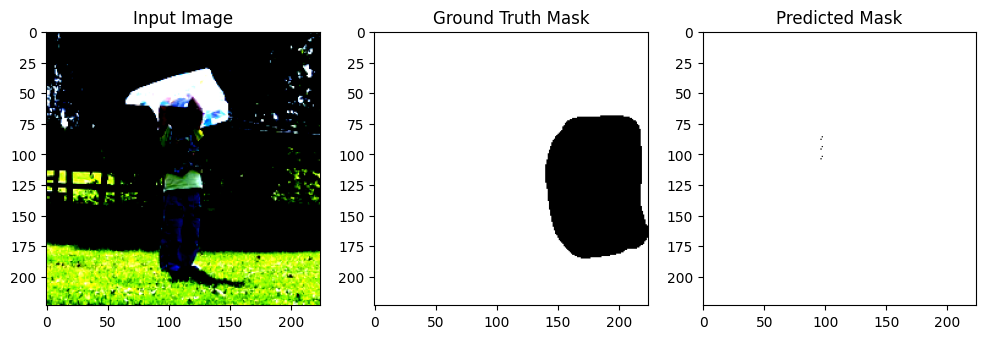

 63%|██████▎   | 87/138 [02:50<00:51,  1.00s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9481792..2.64].


tensor(0.0723)


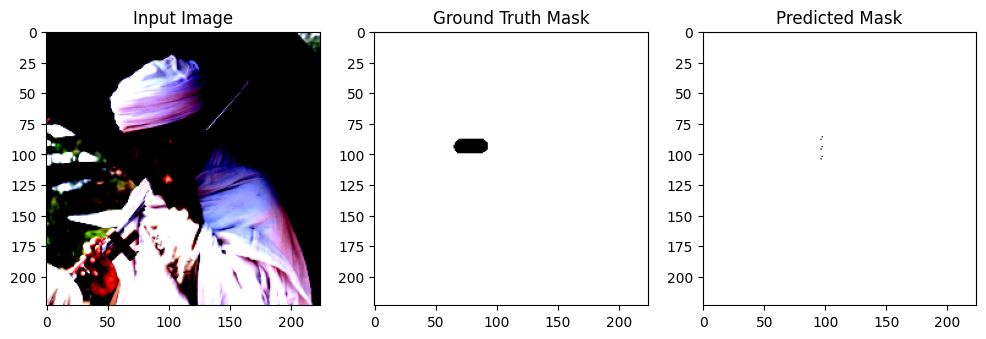

 64%|██████▍   | 88/138 [02:51<00:43,  1.15it/s]

tensor(0.0509)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].


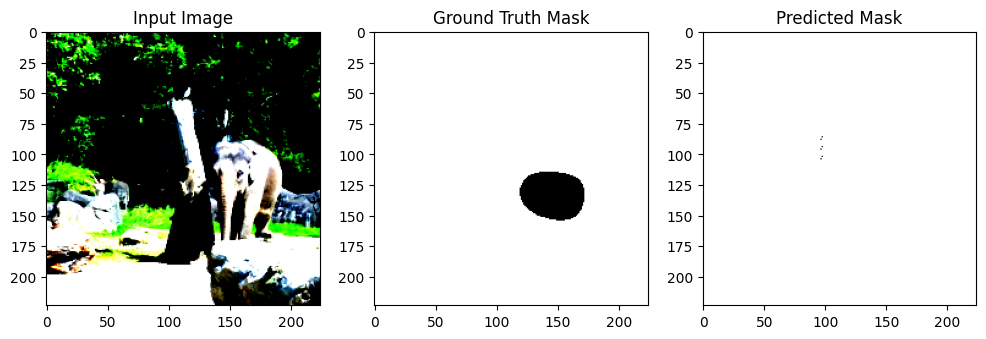

 64%|██████▍   | 89/138 [03:02<03:23,  4.15s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.2489083].


tensor(0.0670)


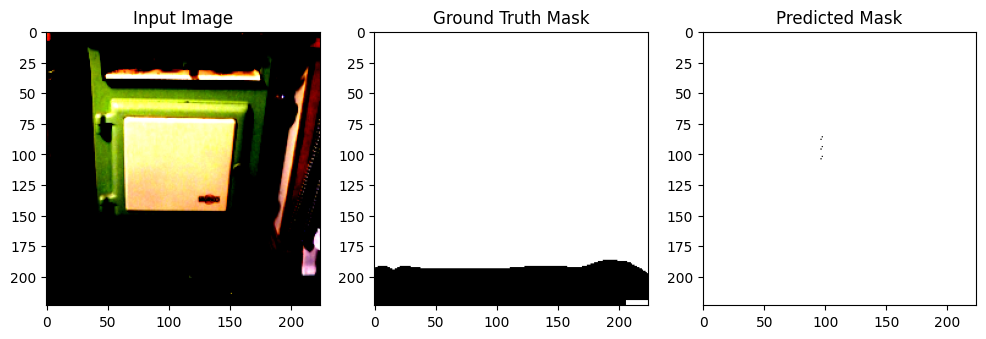

 65%|██████▌   | 90/138 [03:03<02:27,  3.06s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


tensor(0.0633)


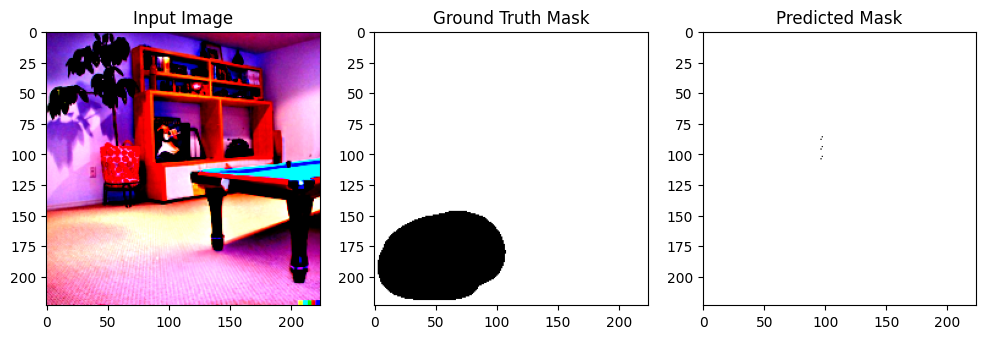

 66%|██████▌   | 91/138 [03:04<01:48,  2.31s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0683)


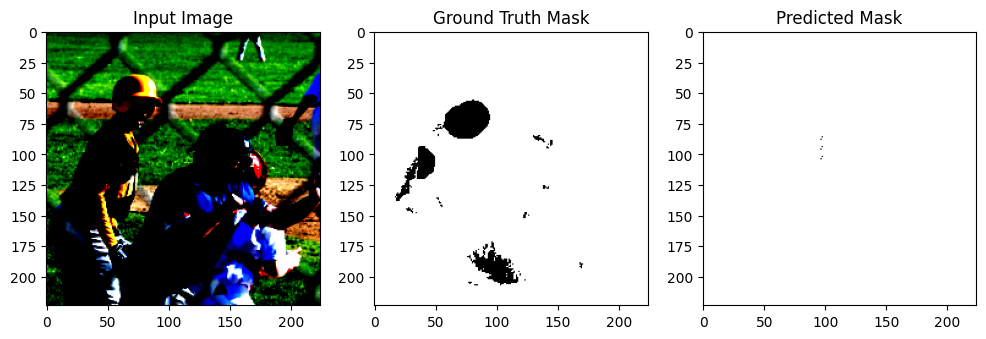

 67%|██████▋   | 92/138 [03:04<01:22,  1.79s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0698)


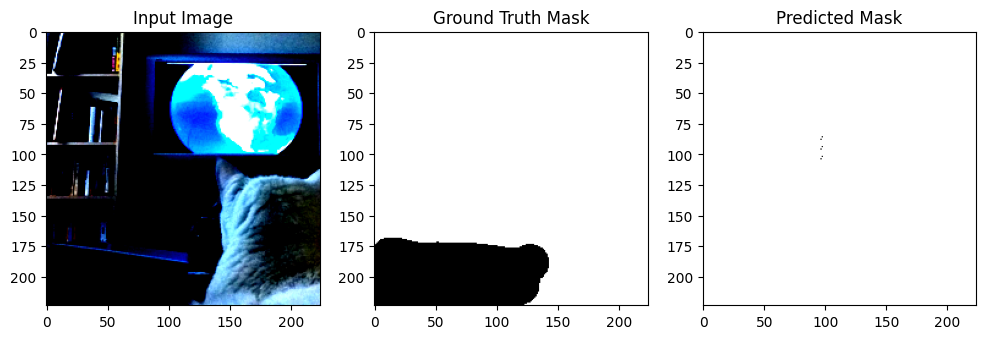

 67%|██████▋   | 93/138 [03:05<01:03,  1.41s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0558)


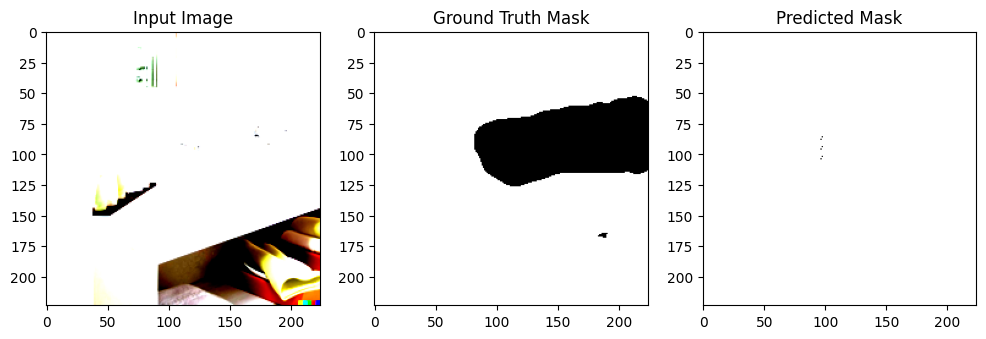

 68%|██████▊   | 94/138 [03:05<00:50,  1.16s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0357141..2.64].


tensor(0.0796)


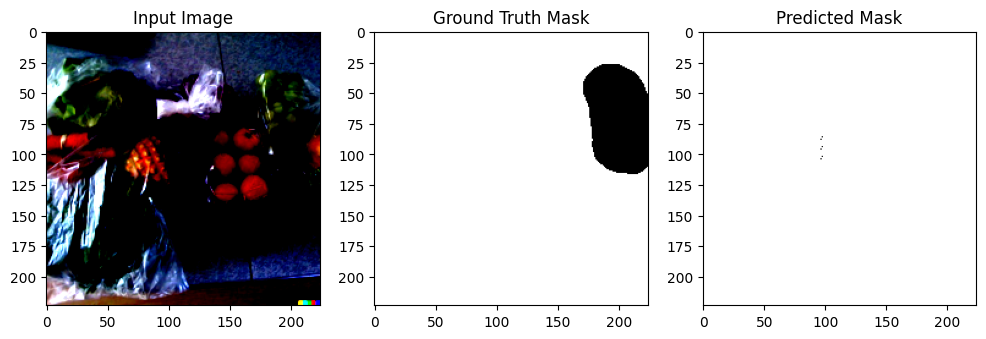

 69%|██████▉   | 95/138 [03:06<00:42,  1.02it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.5702832].


tensor(0.0824)


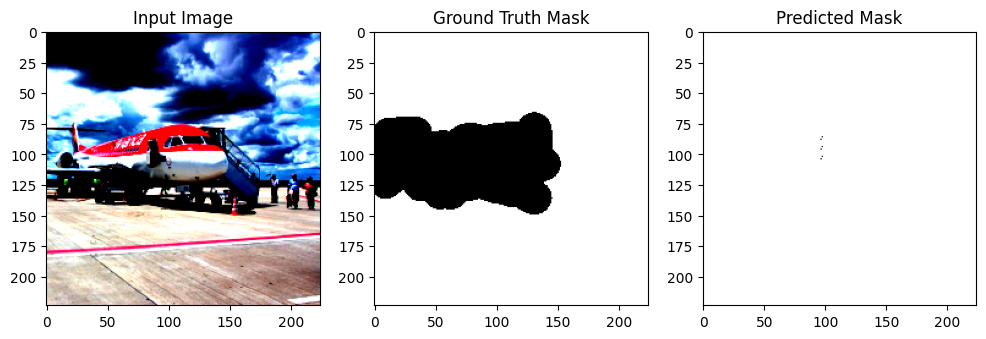

 70%|██████▉   | 96/138 [03:06<00:37,  1.13it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0737)


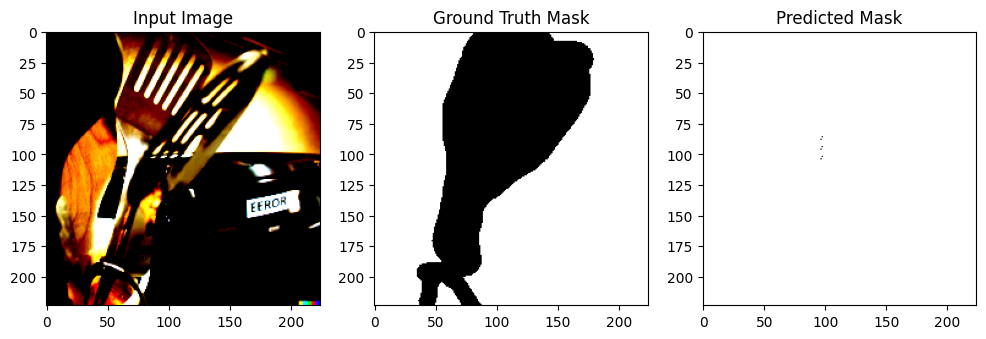

 70%|███████   | 97/138 [03:17<02:37,  3.85s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.64].


tensor(0.0634)


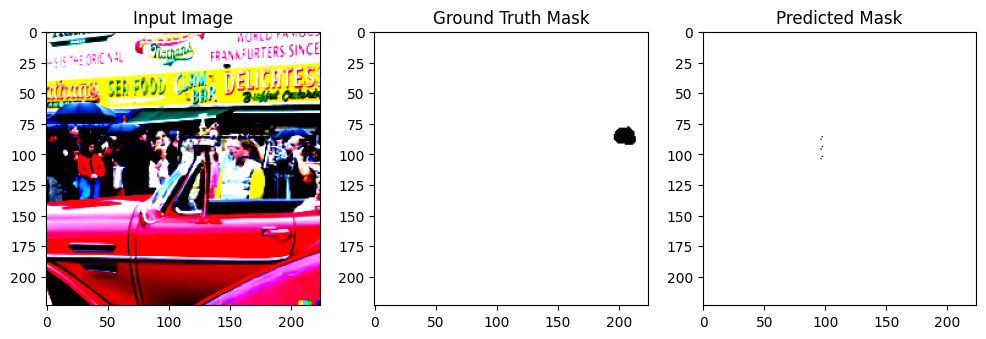

 71%|███████   | 98/138 [03:18<01:56,  2.92s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.64].


tensor(0.0706)


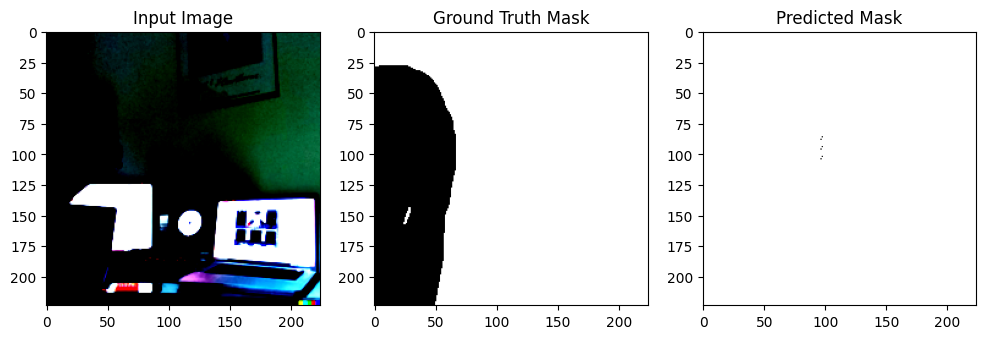

 72%|███████▏  | 99/138 [03:19<01:26,  2.22s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9980307..2.622571].


tensor(0.0533)


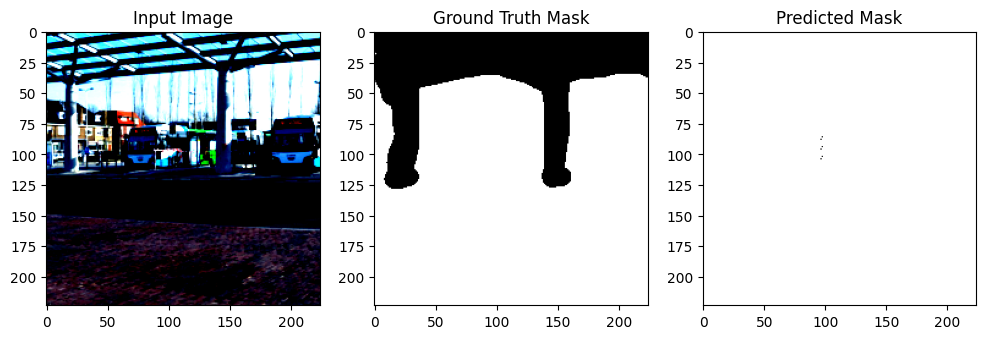

 72%|███████▏  | 100/138 [03:19<01:05,  1.72s/it]

tensor(0.0501)


 72%|███████▏  | 100/138 [03:32<01:20,  2.13s/it]


In [19]:
import torch
import matplotlib.pyplot as plt
from tqdm import tqdm

model = torch.load("/home/vamsi/nlp/DICE+BCE/dice_maskpredictor_100.pth")
model.eval() 

with torch.no_grad(): 
    for i, (text_embedding, img, gt_mask) in enumerate(tqdm(test_loader)):
        text_embedding = text_embedding.to(device) 
        img = img.to(device) 
        gt_mask = gt_mask.to(device) 

        pred_mask = model(img, text_embedding)

        pred_mask = (pred_mask > 0.5).float()
        
        img = img.cpu()
        gt_mask = gt_mask.cpu()
        pred_mask = pred_mask.cpu()
        
        def dice_loss(pred, target, smooth=1):
            intersection = (pred * target).sum()
            dice = (2. * intersection + smooth) / (pred.sum() + target.sum() + smooth)
            return 1 - dice
        
        print(dice_loss(pred_mask,gt_mask))
        
        if i < 100: 
            fig, axes = plt.subplots(1, 3, figsize=(12, 4))
            axes[0].imshow(img[0].permute(1, 2, 0))
            axes[0].set_title("Input Image")
            axes[1].imshow(gt_mask[0].squeeze(), cmap="gray") 
            axes[1].set_title("Ground Truth Mask")
            axes[2].imshow(pred_mask[0].squeeze(), cmap="gray") 
            axes[2].set_title("Predicted Mask")
            plt.show()
        if i==100:
            break


In [20]:
print(device)
model = torch.load("crossattention+dice_maskpredictor.pth").to(device)

cuda


/tmp/ipykernel_648597/2953688333.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load("crossattention+dice_maskpredictor.pth").to(device)


combined loss [ce+dice(bg-white)] 100-200 epochs

In [21]:
import torch.optim as optim
from tqdm import tqdm

def combined_loss(pred, target, smooth=1):
    bce = nn.BCELoss()(pred, target)  # Binary Cross Entropy Loss
    intersection = (pred * target).sum()
    dice = (2. * intersection + smooth) / (pred.sum() + target.sum() + smooth)
    return bce + (1 - dice) 

optimizer = optim.Adam(model.parameters(), lr=1e-3)
num_epochs = 100
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    for text_embedding, img, gt_mask in tqdm(train_loader):
        text_embedding = text_embedding.to(device)
        img = img.to(device)
        gt_mask = gt_mask.to(device)

        optimizer.zero_grad()
        pred_mask = model(img, text_embedding)
        loss = combined_loss(pred_mask, gt_mask)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    epoch_loss = running_loss / len(train_loader)
    torch.save(model, "crossattention+dice_maskpredictor_100-200.pth")
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}")


100%|██████████| 138/138 [04:12<00:00,  1.83s/it]


Epoch [1/100], Loss: 0.3099


100%|██████████| 138/138 [04:13<00:00,  1.84s/it]


Epoch [2/100], Loss: 0.3014


100%|██████████| 138/138 [04:13<00:00,  1.84s/it]


Epoch [3/100], Loss: 0.2968


100%|██████████| 138/138 [04:17<00:00,  1.87s/it]


Epoch [4/100], Loss: 0.2946


100%|██████████| 138/138 [04:12<00:00,  1.83s/it]


Epoch [5/100], Loss: 0.2987


100%|██████████| 138/138 [04:26<00:00,  1.93s/it]


Epoch [6/100], Loss: 0.2940


100%|██████████| 138/138 [04:33<00:00,  1.98s/it]


Epoch [7/100], Loss: 0.2936


100%|██████████| 138/138 [04:45<00:00,  2.07s/it]


Epoch [8/100], Loss: 0.2929


100%|██████████| 138/138 [04:37<00:00,  2.01s/it]


Epoch [9/100], Loss: 0.2861


100%|██████████| 138/138 [04:47<00:00,  2.08s/it]


Epoch [10/100], Loss: 0.2870


100%|██████████| 138/138 [04:42<00:00,  2.05s/it]


Epoch [11/100], Loss: 0.2810


100%|██████████| 138/138 [04:33<00:00,  1.98s/it]


Epoch [12/100], Loss: 0.2834


100%|██████████| 138/138 [04:38<00:00,  2.02s/it]


Epoch [13/100], Loss: 0.2783


100%|██████████| 138/138 [04:36<00:00,  2.00s/it]


Epoch [14/100], Loss: 0.2790


100%|██████████| 138/138 [04:32<00:00,  1.97s/it]


Epoch [15/100], Loss: 0.2774


100%|██████████| 138/138 [04:36<00:00,  2.00s/it]


Epoch [16/100], Loss: 0.2742


100%|██████████| 138/138 [04:33<00:00,  1.98s/it]


Epoch [17/100], Loss: 0.2708


100%|██████████| 138/138 [04:35<00:00,  2.00s/it]


Epoch [18/100], Loss: 0.2748


100%|██████████| 138/138 [04:34<00:00,  1.99s/it]


Epoch [19/100], Loss: 0.2687


100%|██████████| 138/138 [04:34<00:00,  1.99s/it]


Epoch [20/100], Loss: 0.2703


100%|██████████| 138/138 [04:33<00:00,  1.98s/it]


Epoch [21/100], Loss: 0.2685


100%|██████████| 138/138 [04:33<00:00,  1.98s/it]


Epoch [22/100], Loss: 0.2674


100%|██████████| 138/138 [04:15<00:00,  1.85s/it]


Epoch [23/100], Loss: 0.2604


100%|██████████| 138/138 [04:13<00:00,  1.83s/it]


Epoch [24/100], Loss: 0.2561


100%|██████████| 138/138 [04:14<00:00,  1.84s/it]


Epoch [25/100], Loss: 0.2579


100%|██████████| 138/138 [04:14<00:00,  1.84s/it]


Epoch [26/100], Loss: 0.2572


100%|██████████| 138/138 [04:15<00:00,  1.85s/it]


Epoch [27/100], Loss: 0.2545


100%|██████████| 138/138 [04:13<00:00,  1.84s/it]


Epoch [28/100], Loss: 0.2528


100%|██████████| 138/138 [04:12<00:00,  1.83s/it]


Epoch [29/100], Loss: 0.2504


100%|██████████| 138/138 [04:15<00:00,  1.85s/it]


Epoch [30/100], Loss: 0.2497


100%|██████████| 138/138 [04:10<00:00,  1.82s/it]


Epoch [31/100], Loss: 0.2576


100%|██████████| 138/138 [04:13<00:00,  1.83s/it]


Epoch [32/100], Loss: 0.2536


100%|██████████| 138/138 [04:12<00:00,  1.83s/it]


Epoch [33/100], Loss: 0.2507


100%|██████████| 138/138 [04:15<00:00,  1.85s/it]


Epoch [34/100], Loss: 0.2467


100%|██████████| 138/138 [04:13<00:00,  1.84s/it]


Epoch [35/100], Loss: 0.2448


100%|██████████| 138/138 [04:12<00:00,  1.83s/it]


Epoch [36/100], Loss: 0.2412


100%|██████████| 138/138 [04:15<00:00,  1.85s/it]


Epoch [37/100], Loss: 0.2362


100%|██████████| 138/138 [04:12<00:00,  1.83s/it]


Epoch [38/100], Loss: 0.2383


100%|██████████| 138/138 [04:16<00:00,  1.86s/it]


Epoch [39/100], Loss: 0.2405


100%|██████████| 138/138 [04:14<00:00,  1.84s/it]


Epoch [40/100], Loss: 0.2351


100%|██████████| 138/138 [04:15<00:00,  1.85s/it]


Epoch [41/100], Loss: 0.2350


100%|██████████| 138/138 [04:13<00:00,  1.84s/it]


Epoch [42/100], Loss: 0.2325


100%|██████████| 138/138 [04:15<00:00,  1.85s/it]


Epoch [43/100], Loss: 0.2248


100%|██████████| 138/138 [04:13<00:00,  1.84s/it]


Epoch [44/100], Loss: 0.2267


100%|██████████| 138/138 [04:11<00:00,  1.82s/it]


Epoch [45/100], Loss: 0.2300


100%|██████████| 138/138 [04:14<00:00,  1.85s/it]


Epoch [46/100], Loss: 0.2247


100%|██████████| 138/138 [04:10<00:00,  1.82s/it]


Epoch [47/100], Loss: 0.2189


100%|██████████| 138/138 [04:14<00:00,  1.84s/it]


Epoch [48/100], Loss: 0.2236


100%|██████████| 138/138 [04:12<00:00,  1.83s/it]


Epoch [49/100], Loss: 0.2202


100%|██████████| 138/138 [04:13<00:00,  1.84s/it]


Epoch [50/100], Loss: 0.2200


100%|██████████| 138/138 [04:16<00:00,  1.86s/it]


Epoch [51/100], Loss: 0.2172


100%|██████████| 138/138 [04:13<00:00,  1.83s/it]


Epoch [52/100], Loss: 0.2192


100%|██████████| 138/138 [04:15<00:00,  1.85s/it]


Epoch [53/100], Loss: 0.2172


100%|██████████| 138/138 [04:13<00:00,  1.84s/it]


Epoch [54/100], Loss: 0.2166


100%|██████████| 138/138 [04:16<00:00,  1.86s/it]


Epoch [55/100], Loss: 0.2185


100%|██████████| 138/138 [04:12<00:00,  1.83s/it]


Epoch [56/100], Loss: 0.2169


100%|██████████| 138/138 [04:11<00:00,  1.82s/it]


Epoch [57/100], Loss: 0.2241


100%|██████████| 138/138 [04:13<00:00,  1.84s/it]


Epoch [58/100], Loss: 0.2143


100%|██████████| 138/138 [04:12<00:00,  1.83s/it]


Epoch [59/100], Loss: 0.2117


100%|██████████| 138/138 [04:11<00:00,  1.82s/it]


Epoch [60/100], Loss: 0.2182


100%|██████████| 138/138 [04:14<00:00,  1.84s/it]


Epoch [61/100], Loss: 0.2150


100%|██████████| 138/138 [04:11<00:00,  1.82s/it]


Epoch [62/100], Loss: 0.2115


100%|██████████| 138/138 [04:12<00:00,  1.83s/it]


Epoch [63/100], Loss: 0.2141


100%|██████████| 138/138 [04:17<00:00,  1.86s/it]


Epoch [64/100], Loss: 0.2052


100%|██████████| 138/138 [04:13<00:00,  1.83s/it]


Epoch [65/100], Loss: 0.2026


100%|██████████| 138/138 [04:17<00:00,  1.87s/it]


Epoch [66/100], Loss: 0.2013


100%|██████████| 138/138 [04:12<00:00,  1.83s/it]


Epoch [67/100], Loss: 0.2057


100%|██████████| 138/138 [04:14<00:00,  1.84s/it]


Epoch [68/100], Loss: 0.1991


100%|██████████| 138/138 [04:14<00:00,  1.84s/it]


Epoch [69/100], Loss: 0.1902


100%|██████████| 138/138 [04:12<00:00,  1.83s/it]


Epoch [70/100], Loss: 0.1954


100%|██████████| 138/138 [04:15<00:00,  1.85s/it]


Epoch [71/100], Loss: 0.1943


100%|██████████| 138/138 [04:13<00:00,  1.84s/it]


Epoch [72/100], Loss: 0.2040


100%|██████████| 138/138 [04:15<00:00,  1.85s/it]


Epoch [73/100], Loss: 0.1969


100%|██████████| 138/138 [04:14<00:00,  1.85s/it]


Epoch [74/100], Loss: 0.1965


100%|██████████| 138/138 [04:12<00:00,  1.83s/it]


Epoch [75/100], Loss: 0.1897


100%|██████████| 138/138 [04:16<00:00,  1.86s/it]


Epoch [76/100], Loss: 0.1938


100%|██████████| 138/138 [04:13<00:00,  1.84s/it]


Epoch [77/100], Loss: 0.1903


100%|██████████| 138/138 [04:15<00:00,  1.85s/it]


Epoch [78/100], Loss: 0.1925


100%|██████████| 138/138 [04:15<00:00,  1.85s/it]


Epoch [79/100], Loss: 0.1942


100%|██████████| 138/138 [04:14<00:00,  1.85s/it]


Epoch [80/100], Loss: 0.1887


100%|██████████| 138/138 [04:11<00:00,  1.83s/it]


Epoch [81/100], Loss: 0.1841


100%|██████████| 138/138 [04:15<00:00,  1.85s/it]


Epoch [82/100], Loss: 0.1907


100%|██████████| 138/138 [04:16<00:00,  1.86s/it]


Epoch [83/100], Loss: 0.1864


100%|██████████| 138/138 [04:16<00:00,  1.86s/it]


Epoch [84/100], Loss: 0.1873


100%|██████████| 138/138 [04:15<00:00,  1.85s/it]


Epoch [85/100], Loss: 0.1842


100%|██████████| 138/138 [04:15<00:00,  1.85s/it]


Epoch [86/100], Loss: 0.1862


100%|██████████| 138/138 [04:17<00:00,  1.87s/it]


Epoch [87/100], Loss: 0.1773


100%|██████████| 138/138 [04:12<00:00,  1.83s/it]


Epoch [88/100], Loss: 0.1756


100%|██████████| 138/138 [04:17<00:00,  1.86s/it]


Epoch [89/100], Loss: 0.1842


100%|██████████| 138/138 [04:14<00:00,  1.84s/it]


Epoch [90/100], Loss: 0.1760


100%|██████████| 138/138 [04:14<00:00,  1.84s/it]


Epoch [91/100], Loss: 0.1771


100%|██████████| 138/138 [04:15<00:00,  1.85s/it]


Epoch [92/100], Loss: 0.1801


100%|██████████| 138/138 [04:13<00:00,  1.84s/it]


Epoch [93/100], Loss: 0.1778


100%|██████████| 138/138 [04:14<00:00,  1.84s/it]


Epoch [94/100], Loss: 0.1737


100%|██████████| 138/138 [04:17<00:00,  1.86s/it]


Epoch [95/100], Loss: 0.1749


100%|██████████| 138/138 [04:12<00:00,  1.83s/it]


Epoch [96/100], Loss: 0.1709


100%|██████████| 138/138 [04:12<00:00,  1.83s/it]


Epoch [97/100], Loss: 0.1731


100%|██████████| 138/138 [04:16<00:00,  1.86s/it]


Epoch [98/100], Loss: 0.1771


100%|██████████| 138/138 [04:13<00:00,  1.84s/it]


Epoch [99/100], Loss: 0.1860


100%|██████████| 138/138 [04:12<00:00,  1.83s/it]


Epoch [100/100], Loss: 0.1703


/tmp/ipykernel_648597/3789648074.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load("crossattention+dice_maskpredictor_100-200.pth")
  0%|          | 0/1

tensor(0.0261)


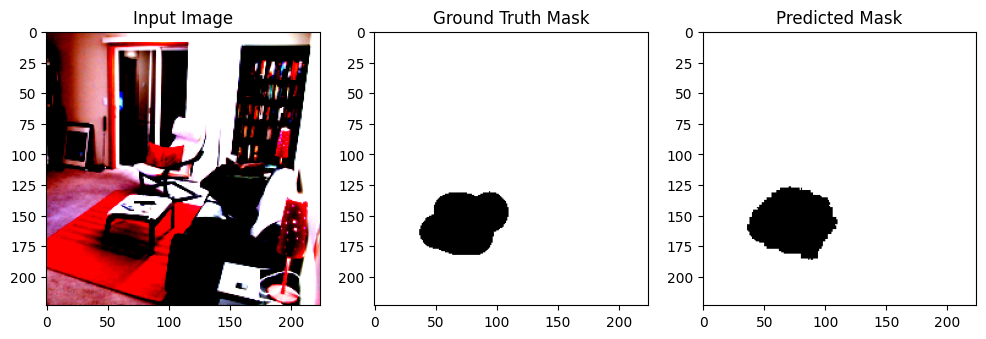

  1%|          | 1/138 [00:15<34:22, 15.05s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0166)


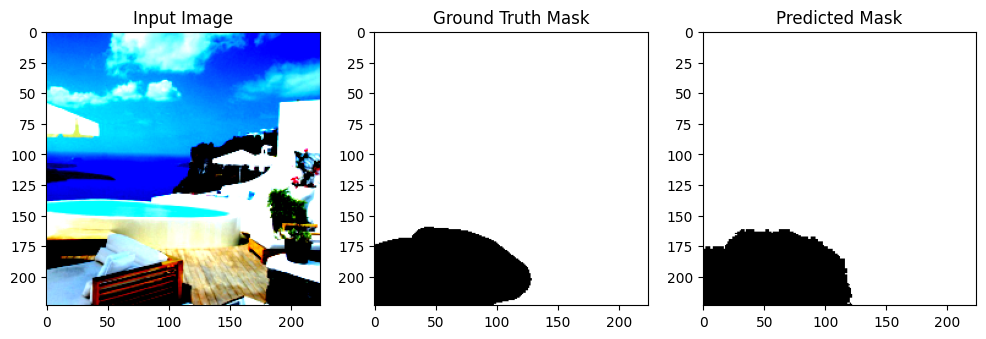

  1%|▏         | 2/138 [00:15<14:42,  6.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0169)


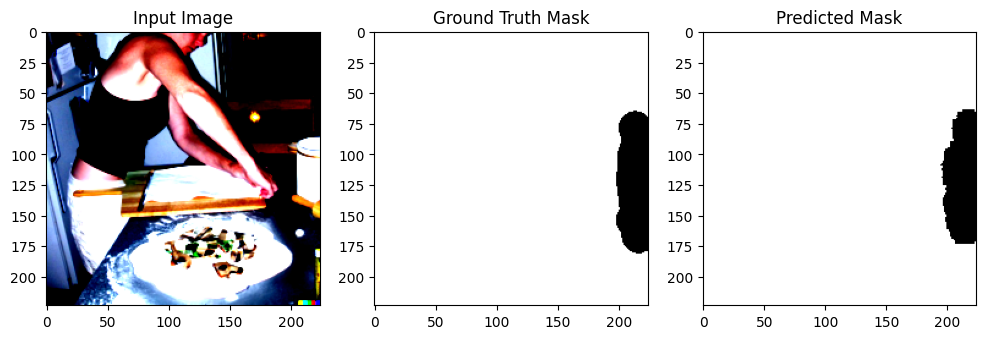

  2%|▏         | 3/138 [00:16<08:24,  3.74s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0204)


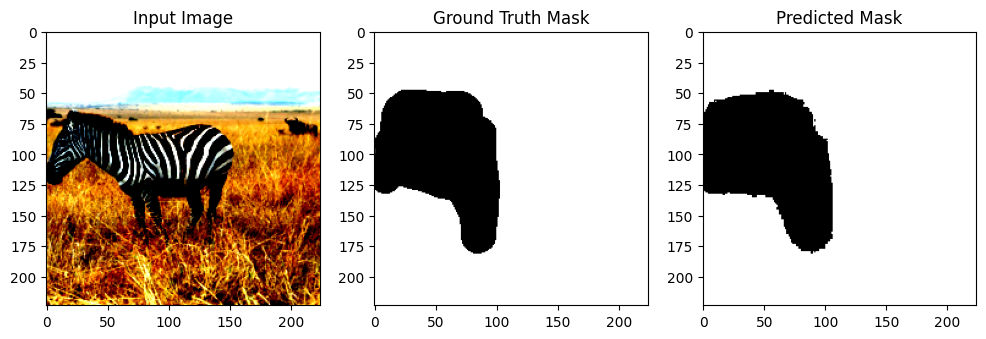

  3%|▎         | 4/138 [00:16<05:35,  2.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9980307..2.64].


tensor(0.0200)


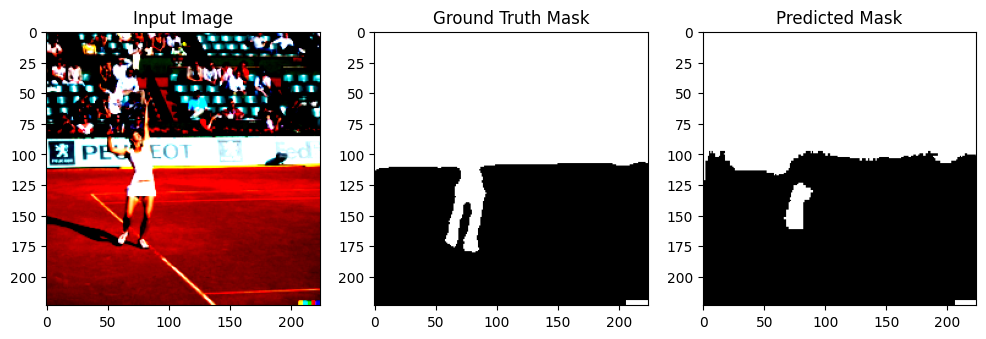

  4%|▎         | 5/138 [00:17<04:07,  1.86s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0367)


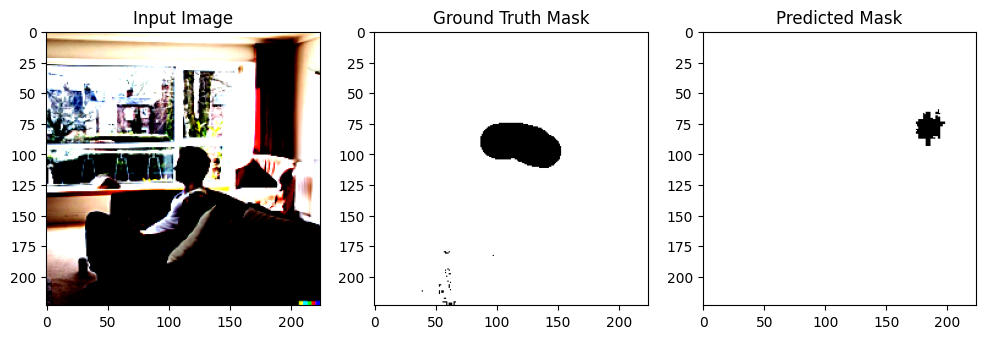

  4%|▍         | 6/138 [00:17<03:05,  1.41s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0357141..2.64].


tensor(0.0237)


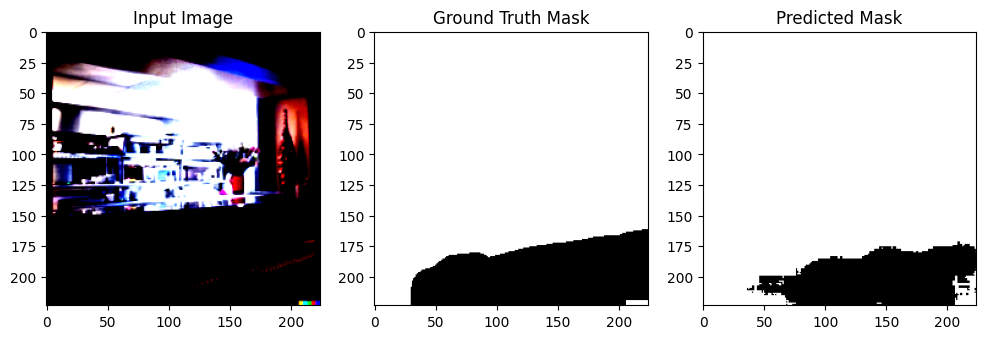

  5%|▌         | 7/138 [00:19<03:23,  1.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6384109..2.64].


tensor(0.0248)


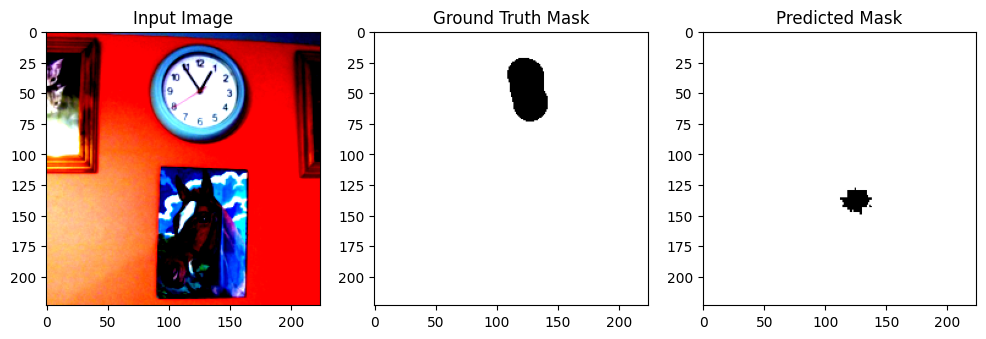

  6%|▌         | 8/138 [00:20<02:44,  1.26s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].


tensor(0.0187)


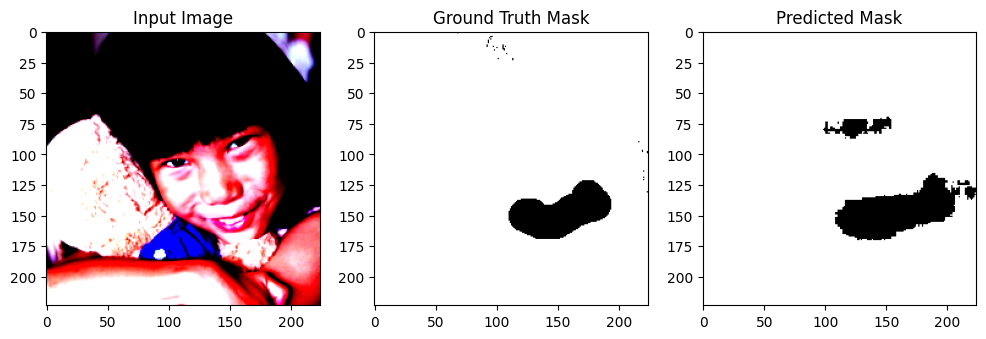

  7%|▋         | 9/138 [00:29<08:03,  3.75s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


tensor(0.0172)


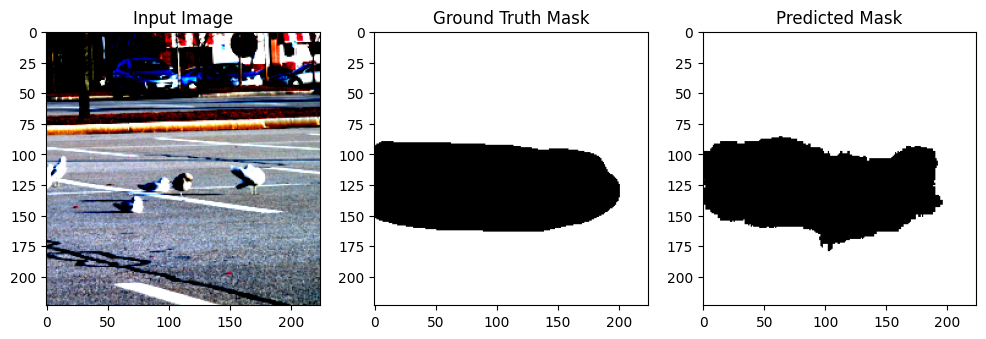

  7%|▋         | 10/138 [00:30<05:48,  2.72s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0147)


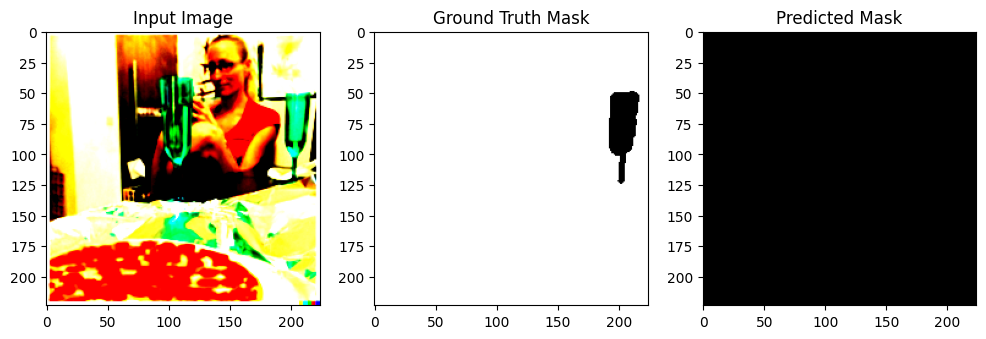

  8%|▊         | 11/138 [00:30<04:18,  2.03s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0183)


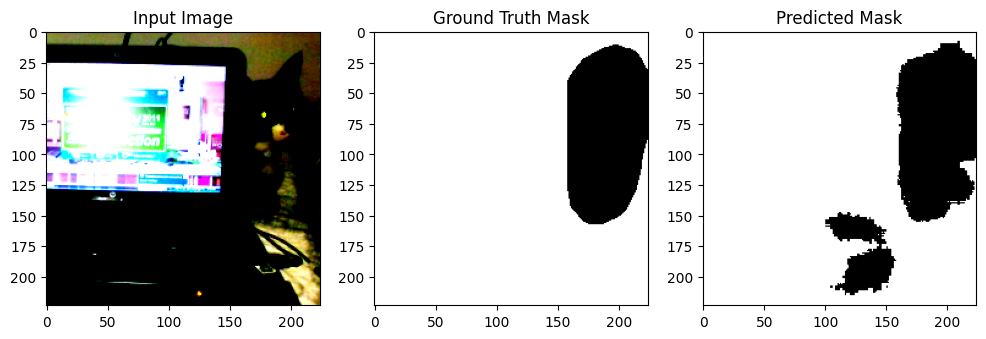

  9%|▊         | 12/138 [00:31<03:27,  1.65s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


tensor(0.0209)


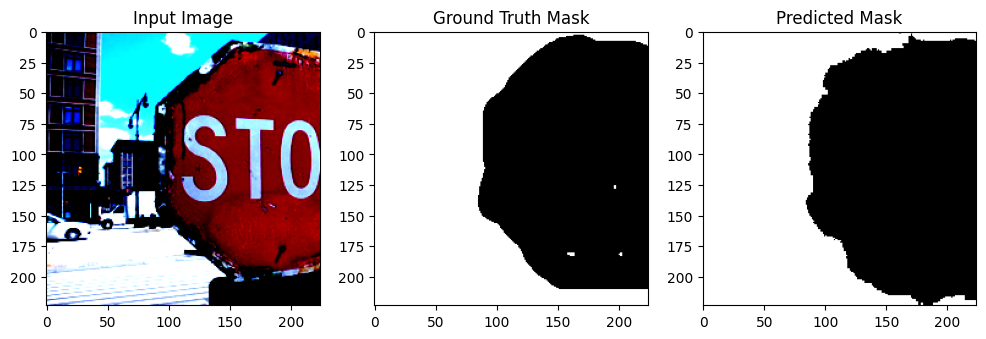

  9%|▉         | 13/138 [00:31<02:46,  1.34s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0322802..2.64].


tensor(0.0226)


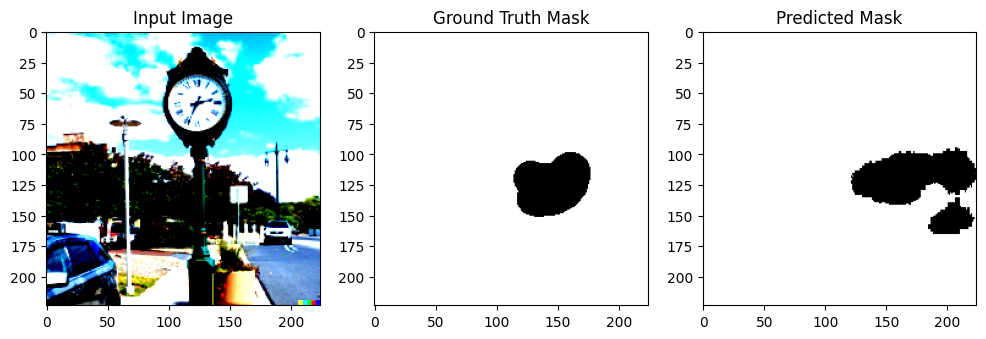

 10%|█         | 14/138 [00:32<02:28,  1.20s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9637812..2.5702832].


tensor(0.0258)


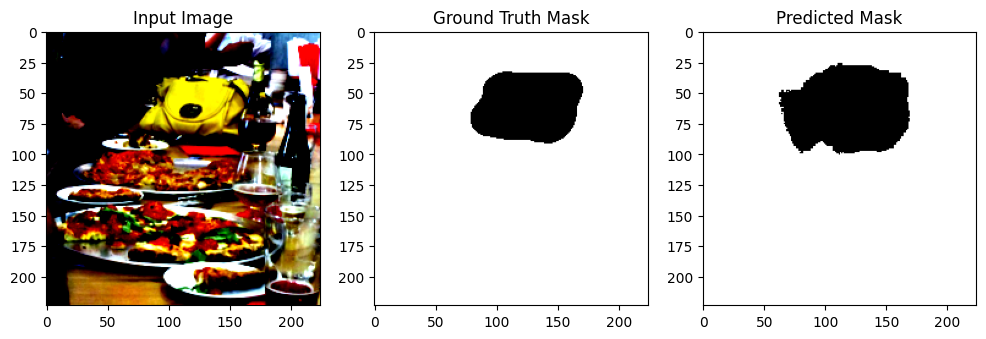

 11%|█         | 15/138 [00:33<02:12,  1.07s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.64].


tensor(0.0206)


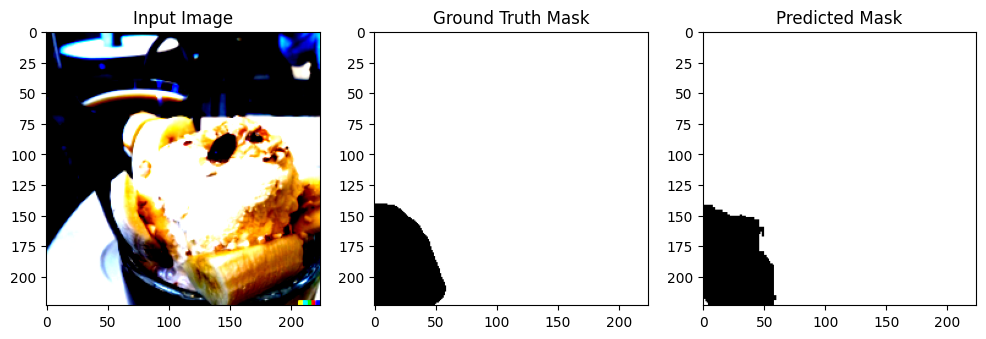

 12%|█▏        | 16/138 [00:34<02:07,  1.04s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9980307..2.64].


tensor(0.0183)


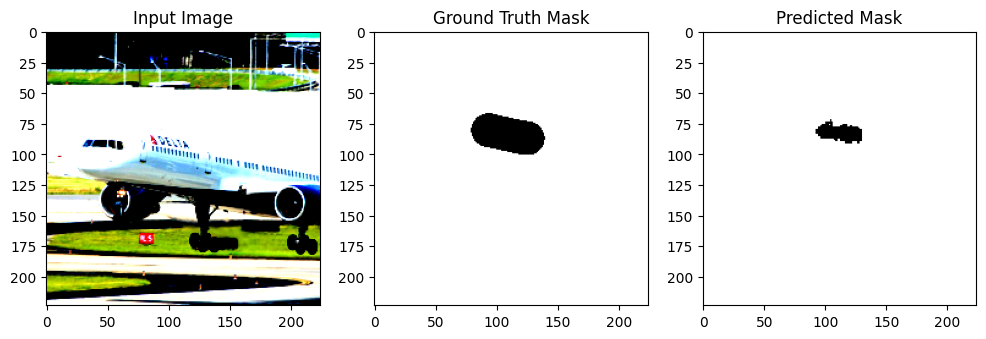

 12%|█▏        | 17/138 [00:47<09:10,  4.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0171)


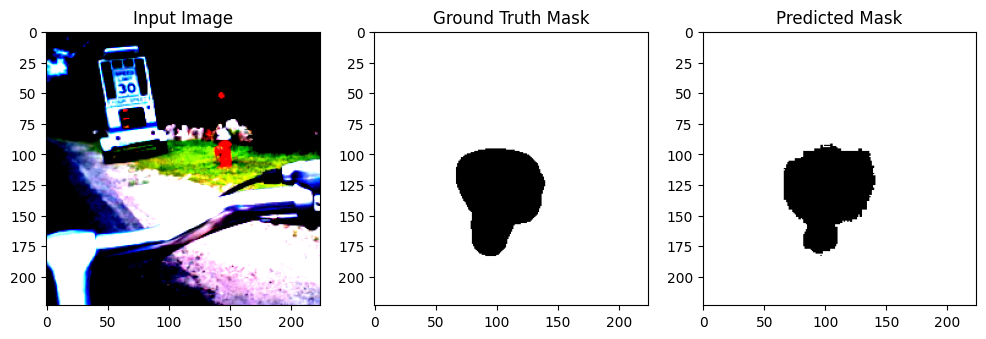

 13%|█▎        | 18/138 [00:47<06:49,  3.41s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0242)


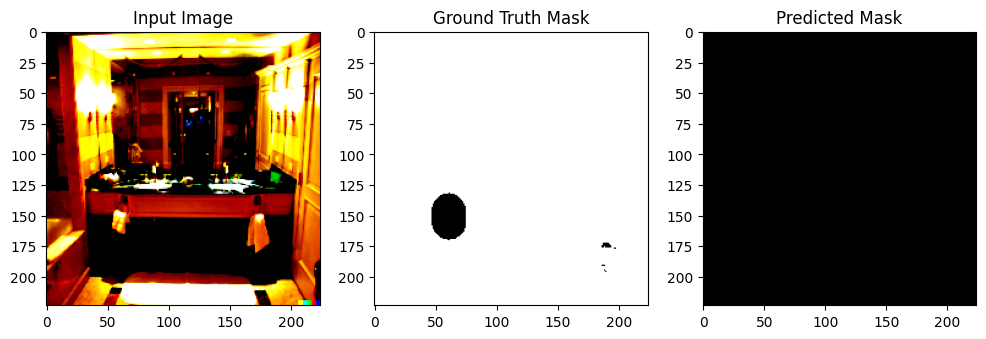

 14%|█▍        | 19/138 [00:49<05:46,  2.91s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


tensor(0.0179)


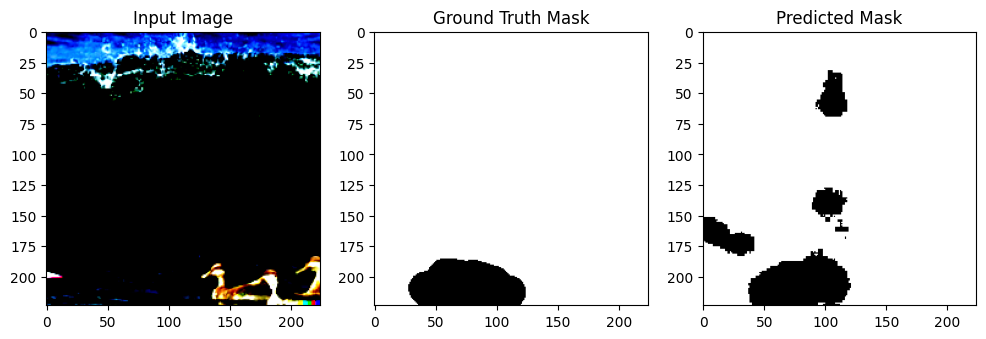

 14%|█▍        | 20/138 [00:50<04:29,  2.29s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0159)


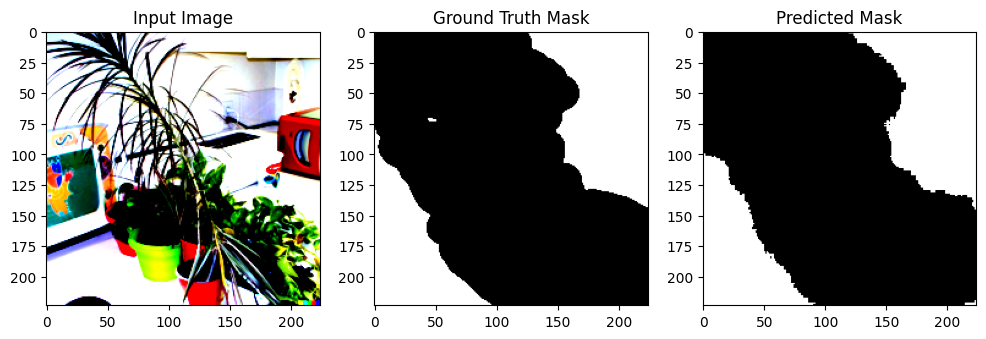

 15%|█▌        | 21/138 [00:51<03:30,  1.80s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8556864].


tensor(0.0208)


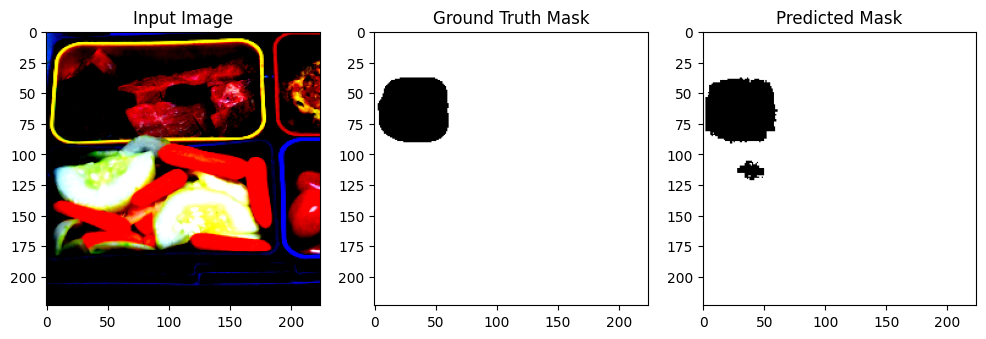

 16%|█▌        | 22/138 [00:51<02:45,  1.43s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0182)


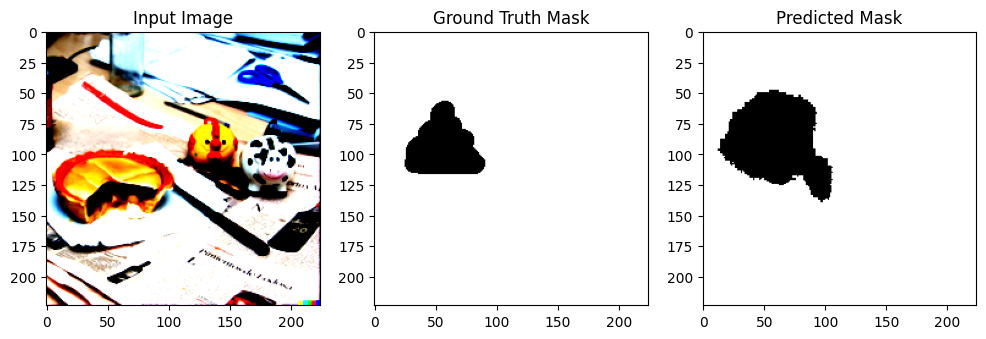

 17%|█▋        | 23/138 [00:52<02:17,  1.19s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0181)


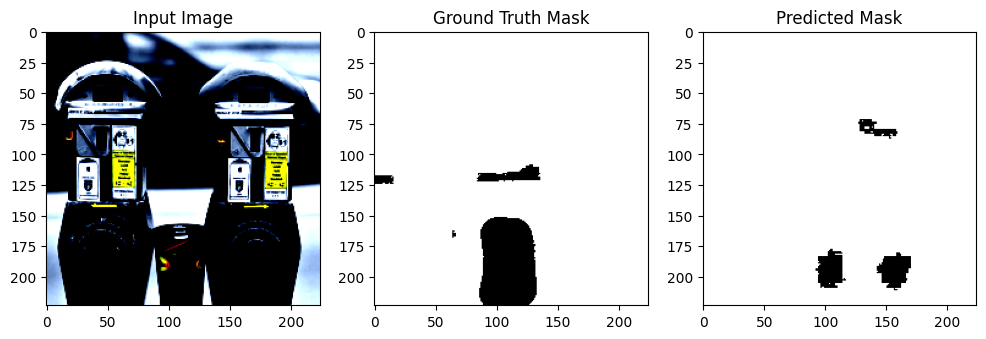

 17%|█▋        | 24/138 [00:52<01:54,  1.01s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0155)


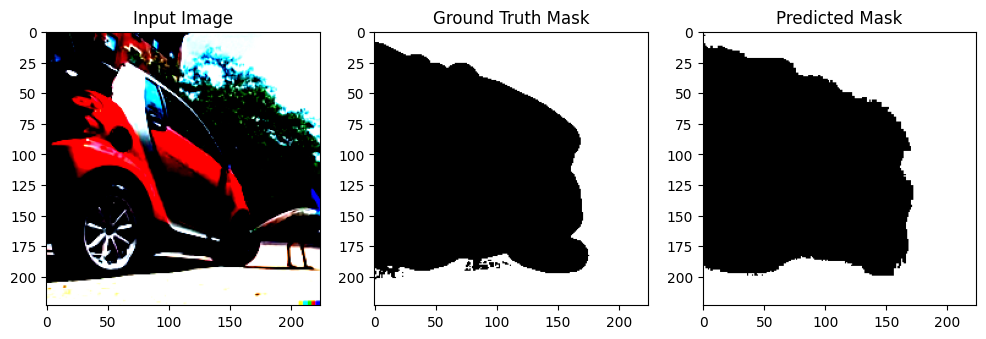

 18%|█▊        | 25/138 [01:04<08:00,  4.25s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9980307..2.64].


tensor(0.0198)


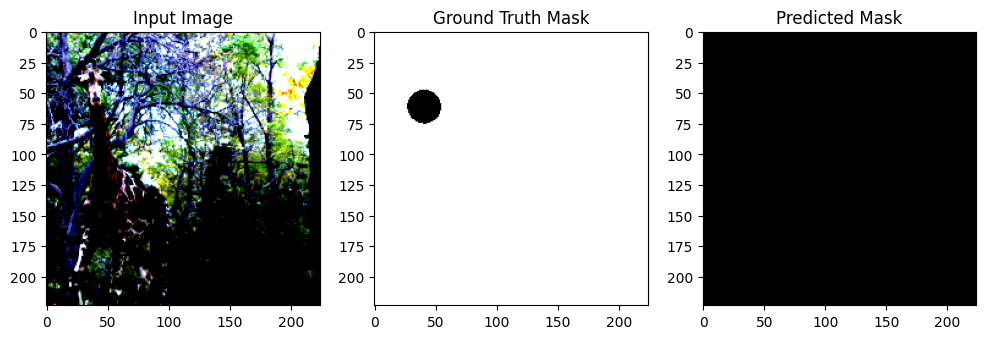

 19%|█▉        | 26/138 [01:05<05:50,  3.13s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9637812..2.64].


tensor(0.0204)


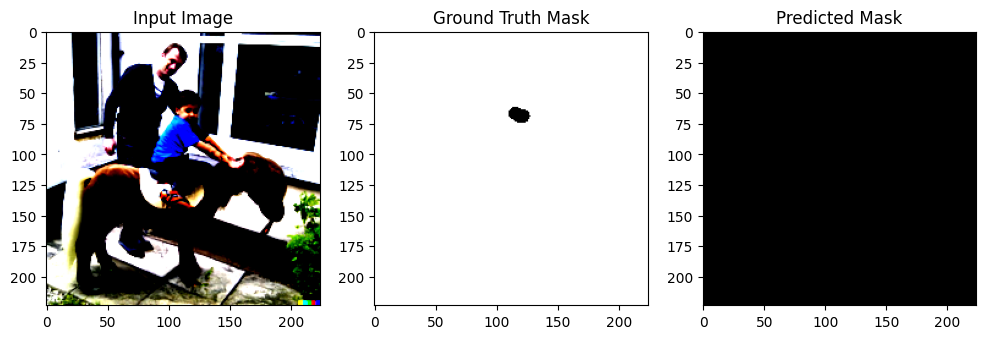

 20%|█▉        | 27/138 [01:06<04:26,  2.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.64].


tensor(0.0184)


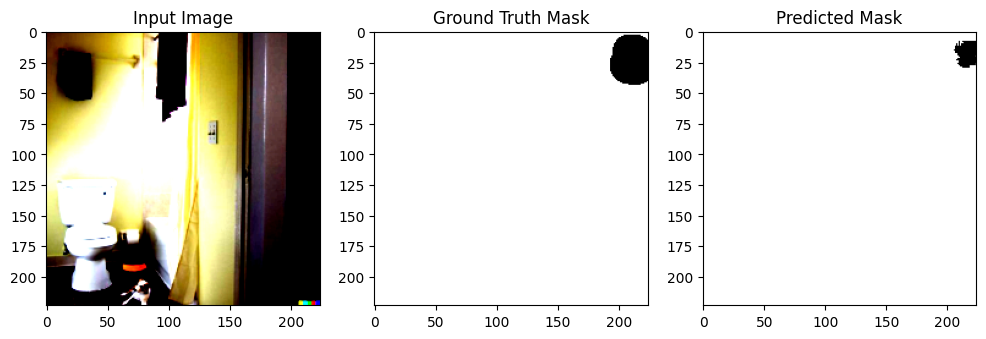

 20%|██        | 28/138 [01:06<03:25,  1.87s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.980906..2.64].


tensor(0.0124)


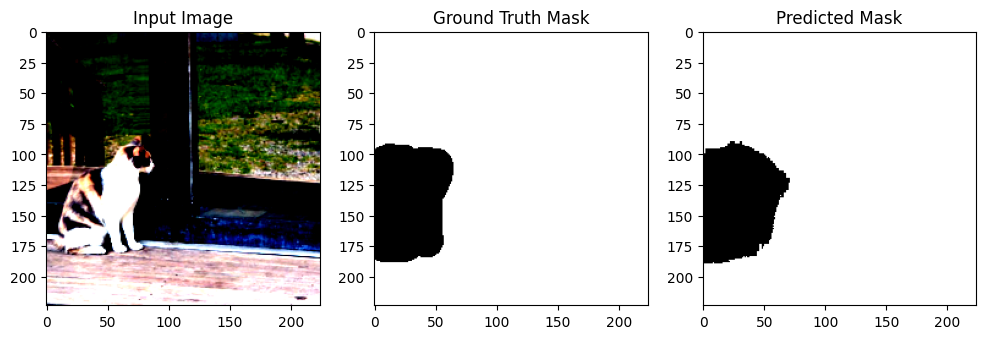

 21%|██        | 29/138 [01:07<02:47,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.465708].


tensor(0.0167)


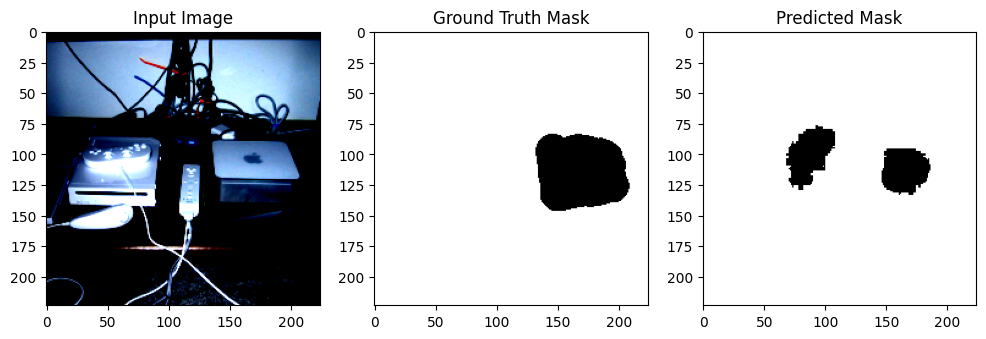

 22%|██▏       | 30/138 [01:08<02:16,  1.26s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0163)


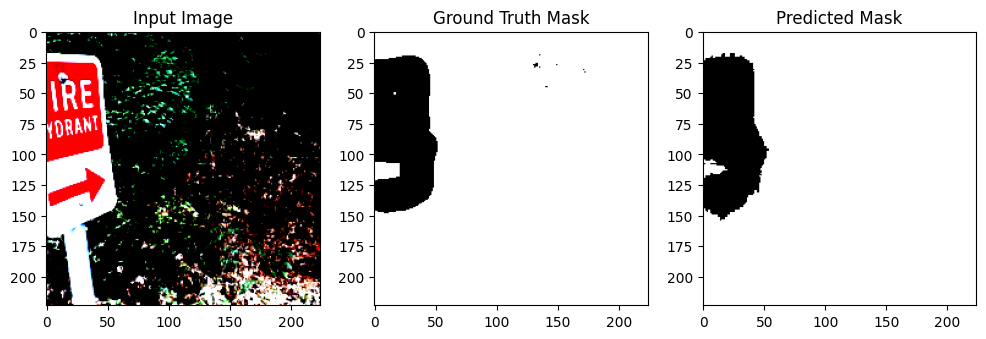

 22%|██▏       | 31/138 [01:08<01:56,  1.09s/it]

tensor(0.0178)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.2739873].


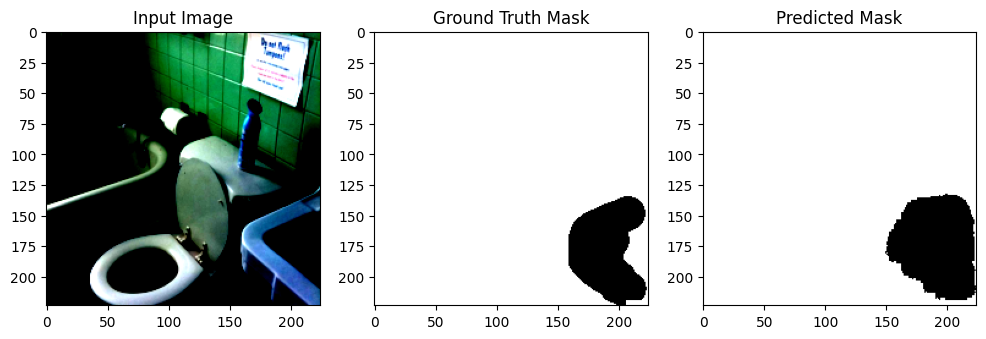

 23%|██▎       | 32/138 [01:09<01:58,  1.12s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..2.64].


tensor(0.0212)


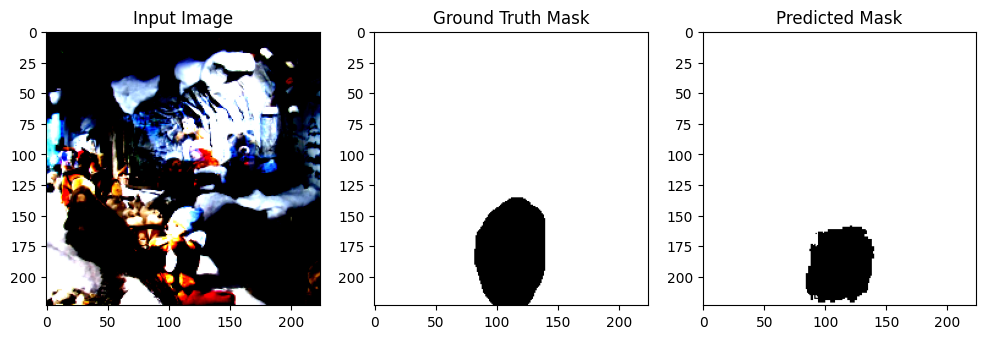

 24%|██▍       | 33/138 [01:22<07:53,  4.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9466565..2.64].


tensor(0.0190)


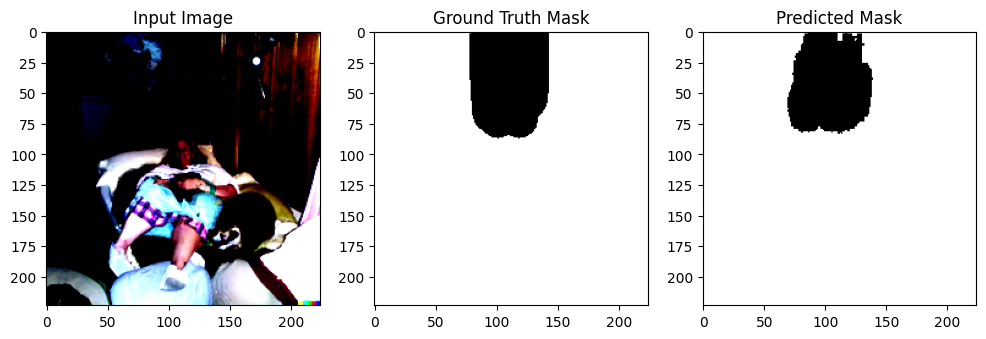

 25%|██▍       | 34/138 [01:22<05:44,  3.31s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.64].


tensor(0.0234)


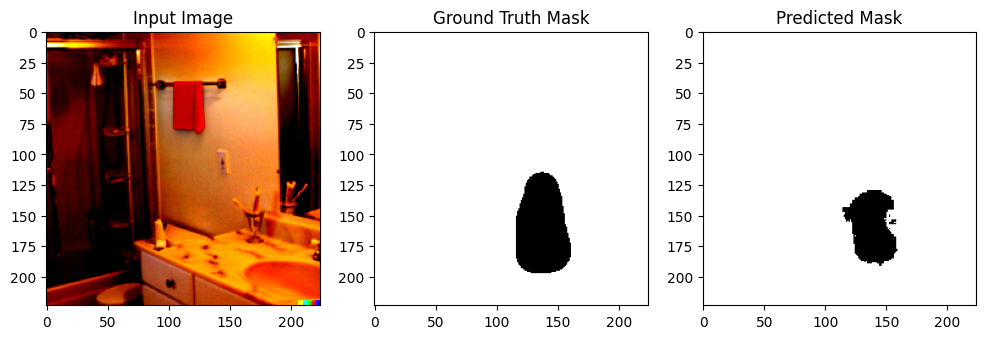

 25%|██▌       | 35/138 [01:23<04:18,  2.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0160)


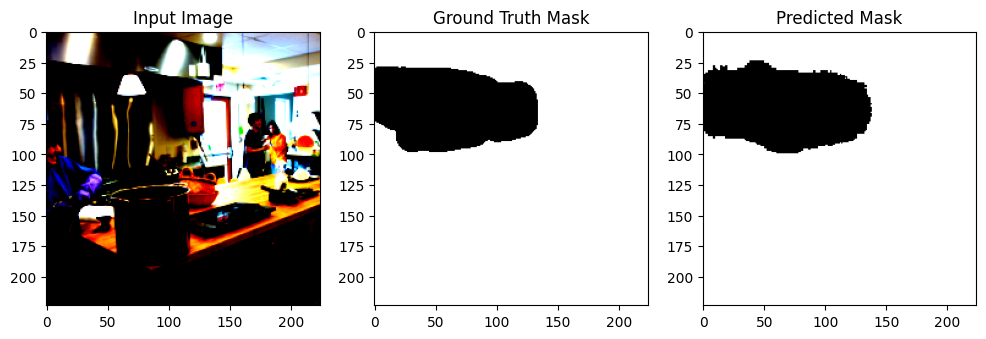

 26%|██▌       | 36/138 [01:24<03:17,  1.94s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


tensor(0.0188)


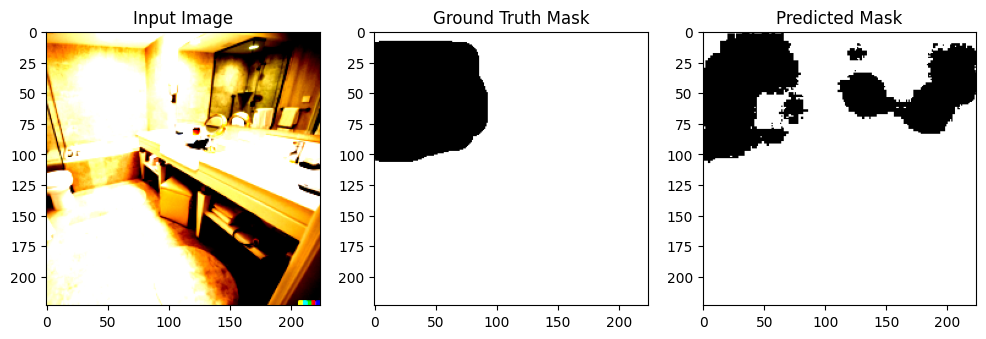

 27%|██▋       | 37/138 [01:24<02:33,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0225)


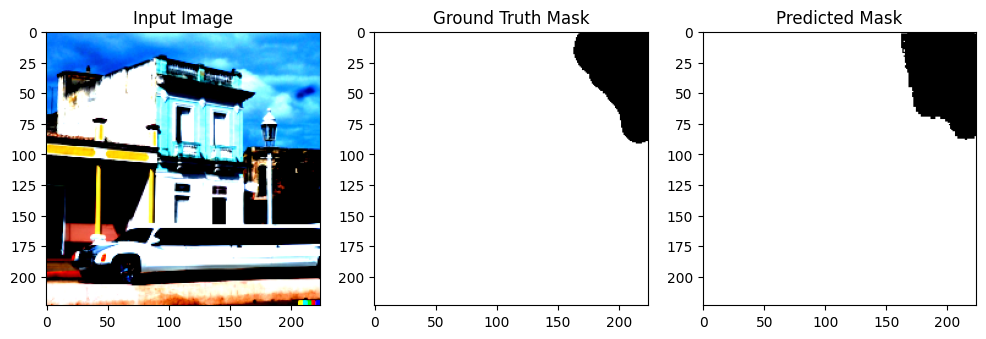

 28%|██▊       | 38/138 [01:25<02:04,  1.24s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.343704].


tensor(0.0168)


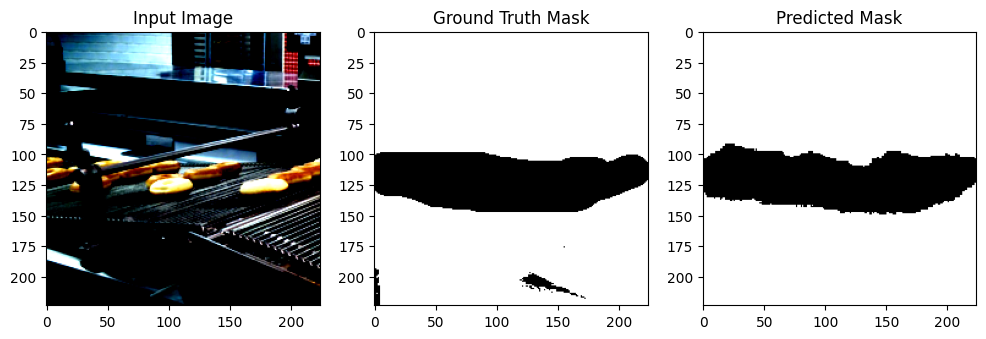

 28%|██▊       | 39/138 [01:25<01:41,  1.02s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.980906..2.64].


tensor(0.0166)


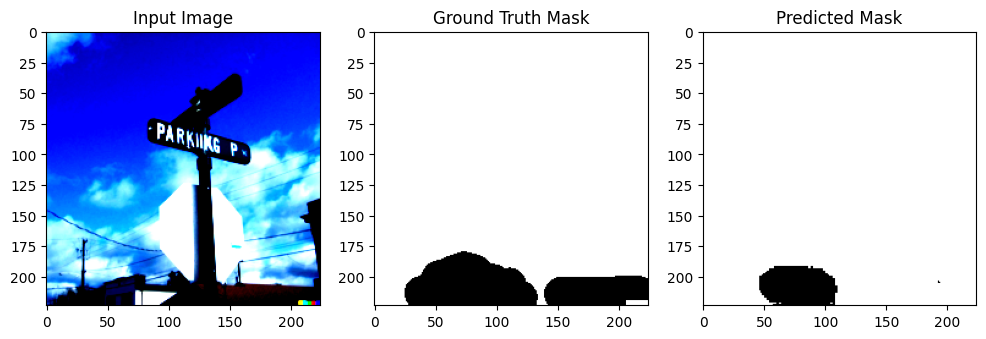

 29%|██▉       | 40/138 [01:26<01:25,  1.15it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0168)


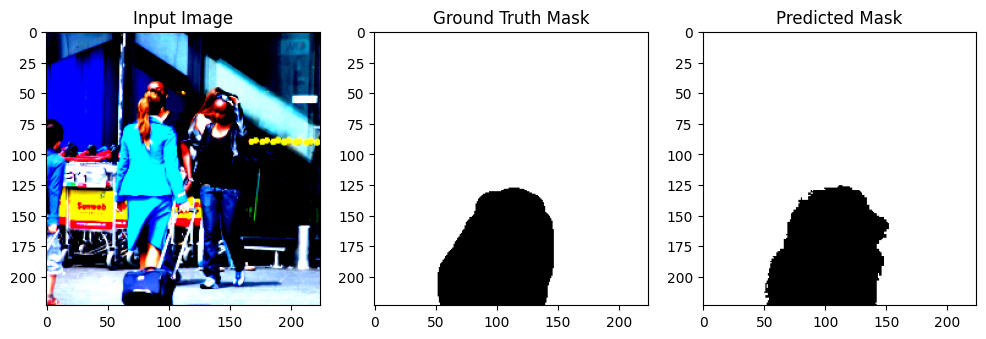

 30%|██▉       | 41/138 [01:38<07:01,  4.35s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0195)


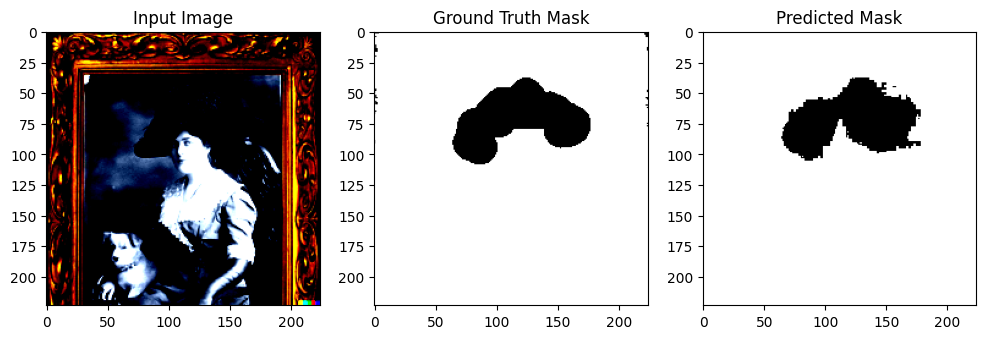

 30%|███       | 42/138 [01:39<05:09,  3.22s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


tensor(0.0200)


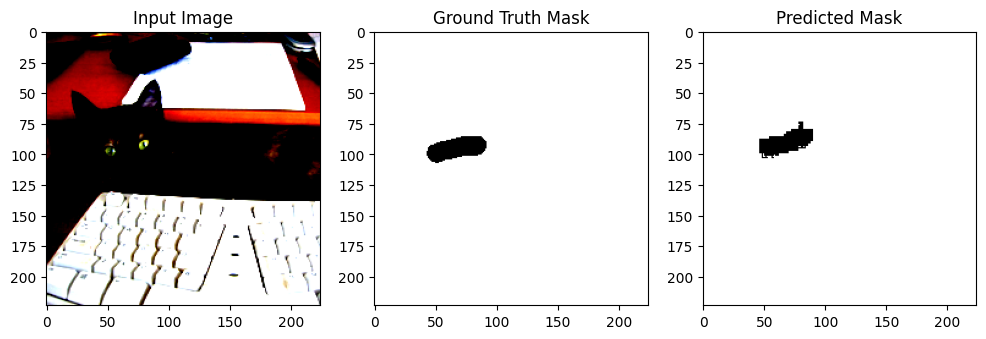

 31%|███       | 43/138 [01:39<03:53,  2.46s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0204)


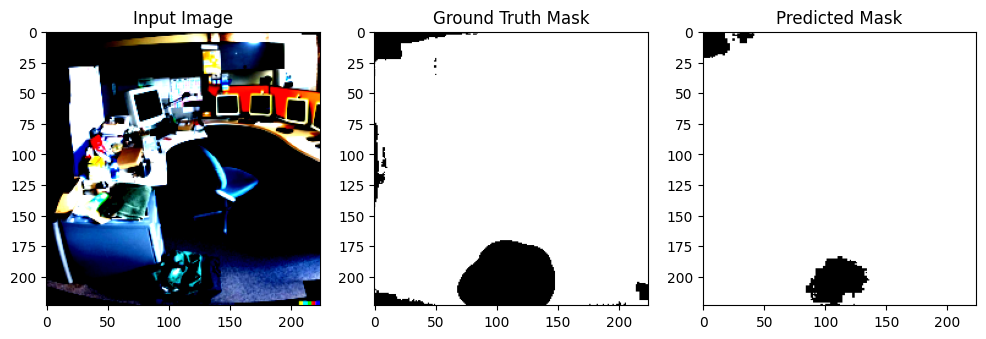

 32%|███▏      | 44/138 [01:40<03:08,  2.01s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].


tensor(0.0190)


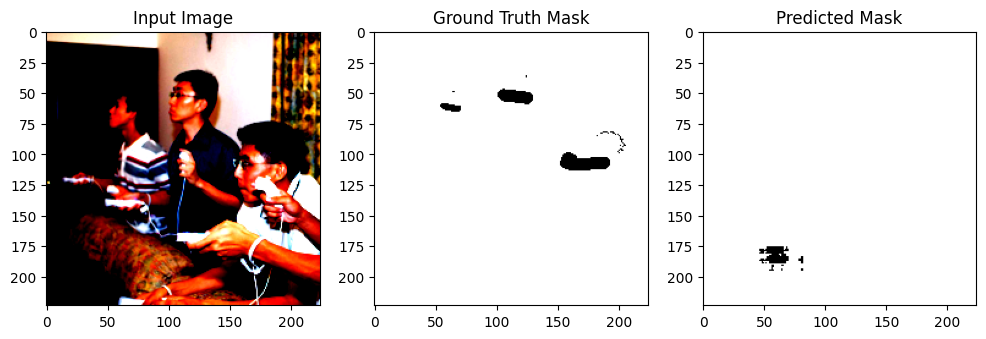

 33%|███▎      | 45/138 [01:41<02:25,  1.57s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.980906..2.622571].


tensor(0.0210)


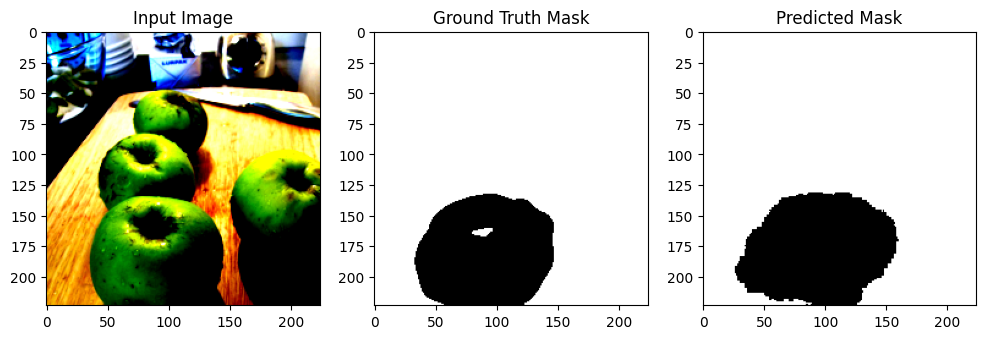

 33%|███▎      | 46/138 [01:42<01:57,  1.28s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0232)


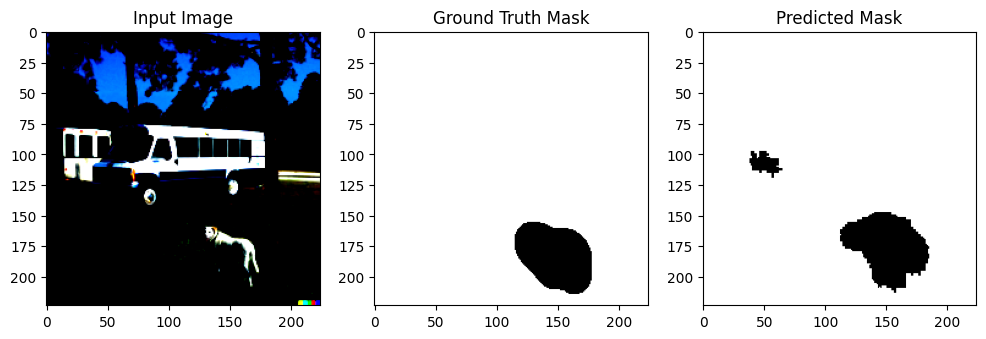

 34%|███▍      | 47/138 [01:42<01:39,  1.09s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.622571].


tensor(0.0109)


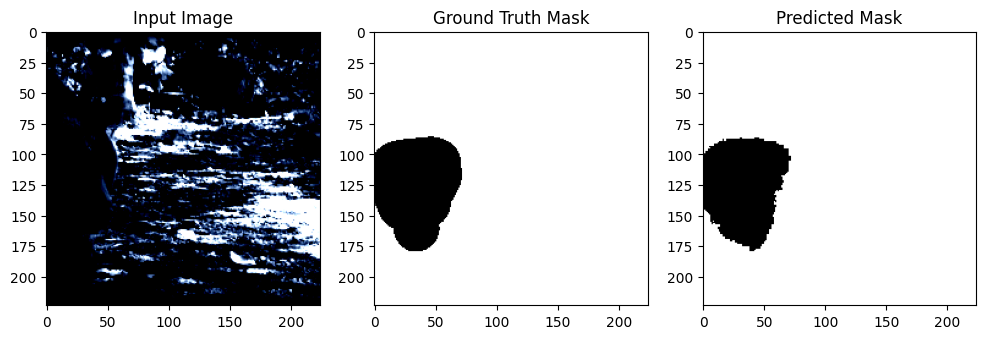

 35%|███▍      | 48/138 [01:43<01:25,  1.05it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.343704].


tensor(0.0163)


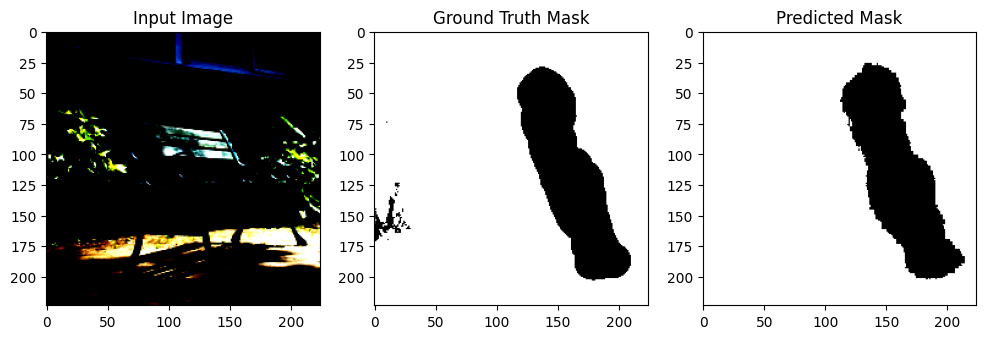

 36%|███▌      | 49/138 [01:55<06:15,  4.22s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7069099..2.2042704].


tensor(0.0248)


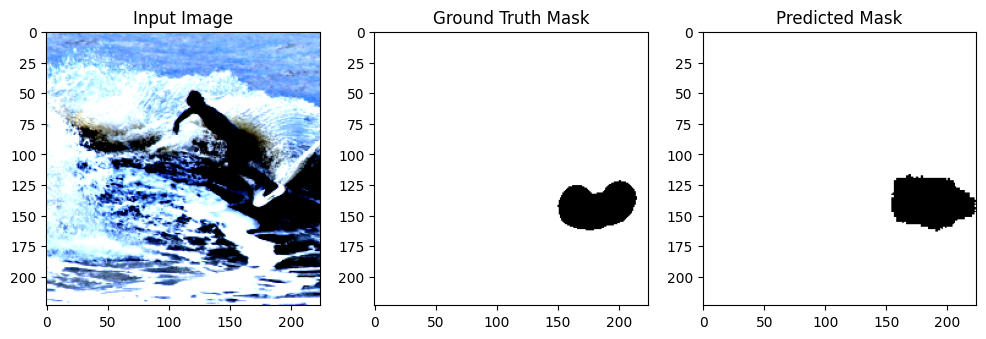

 36%|███▌      | 50/138 [01:55<04:37,  3.16s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.64].


tensor(0.0235)


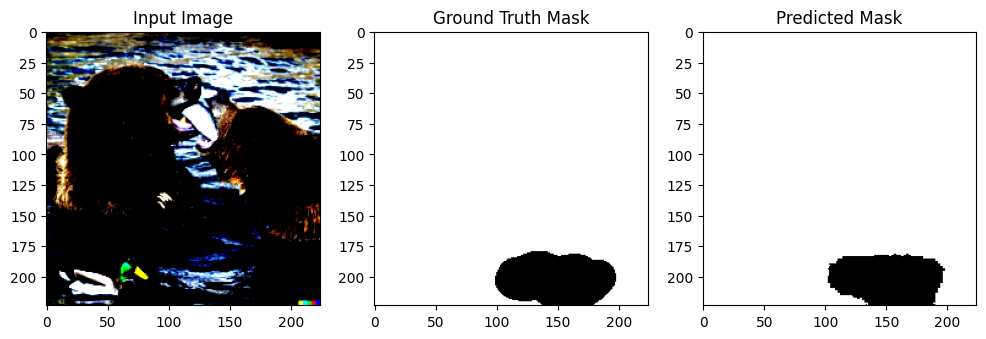

 37%|███▋      | 51/138 [01:56<03:28,  2.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


tensor(0.0284)


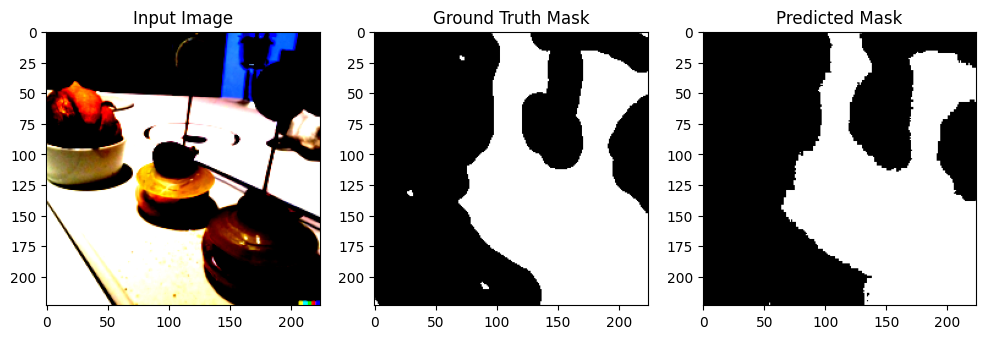

 38%|███▊      | 52/138 [01:57<02:41,  1.88s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0190)


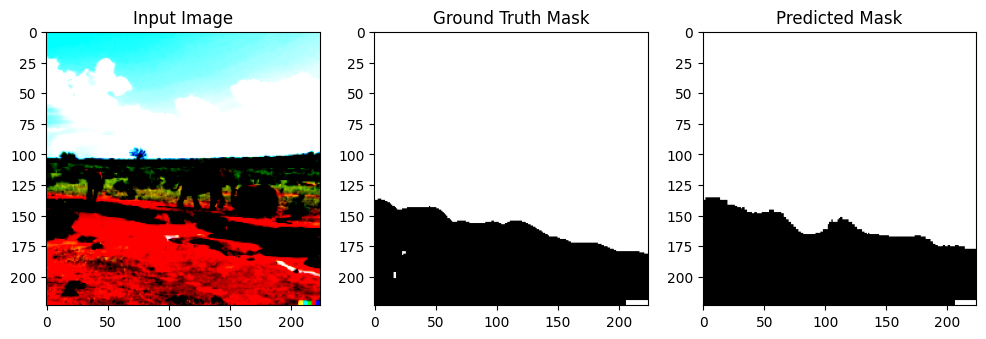

 38%|███▊      | 53/138 [01:57<02:07,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0175)


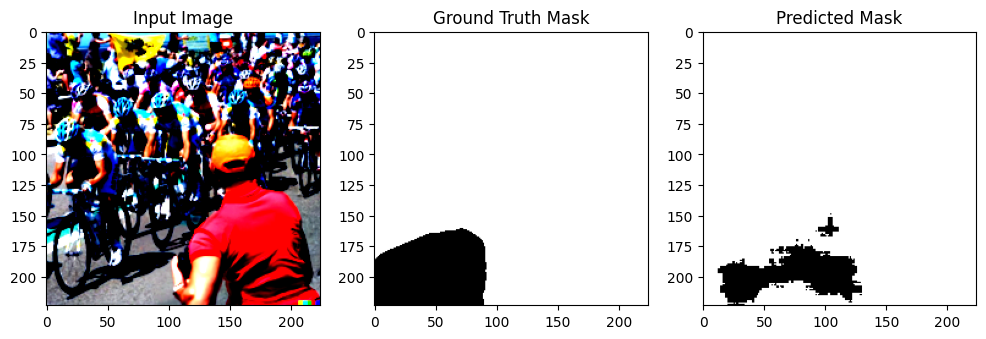

 39%|███▉      | 54/138 [01:58<01:44,  1.24s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.64].


tensor(0.0166)


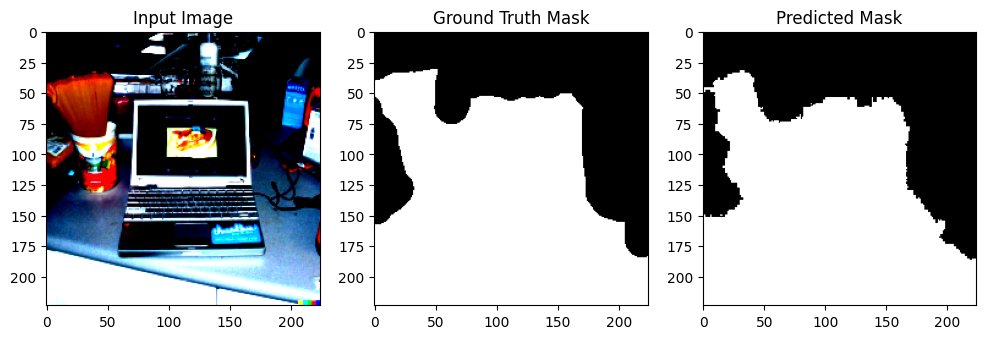

 40%|███▉      | 55/138 [01:59<01:27,  1.05s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.64].


tensor(0.0222)


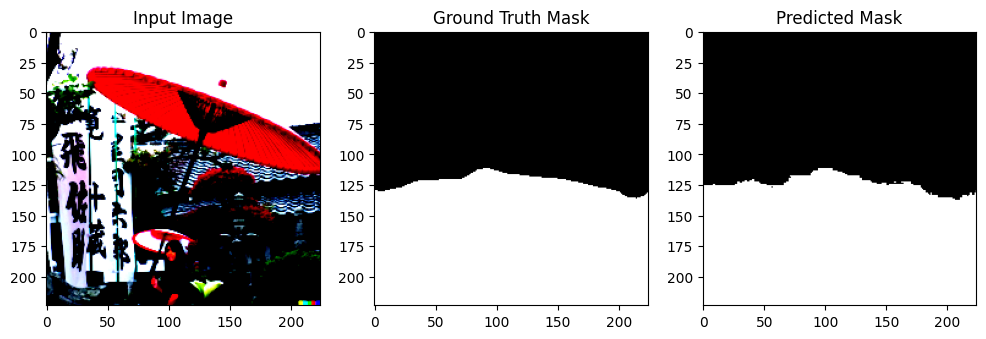

 41%|████      | 56/138 [01:59<01:15,  1.08it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0202)


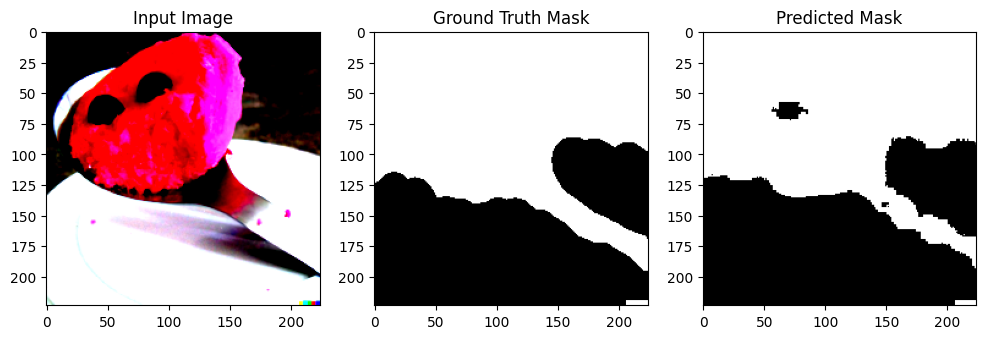

 41%|████▏     | 57/138 [02:11<05:45,  4.27s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0312)


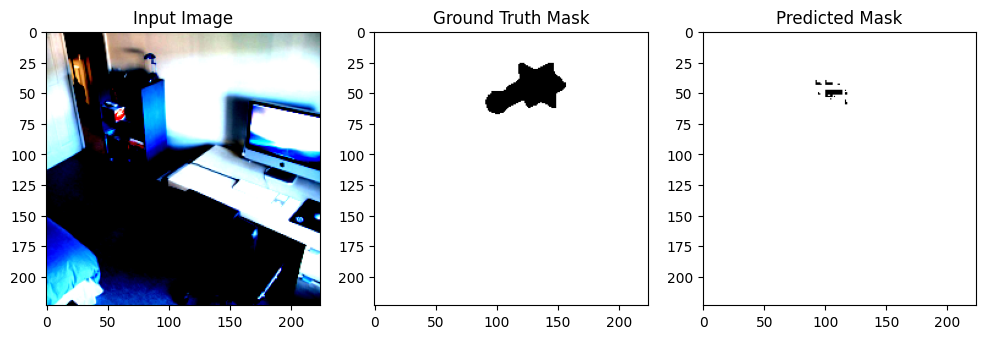

 42%|████▏     | 58/138 [02:12<04:12,  3.16s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9124069..2.622571].


tensor(0.0163)


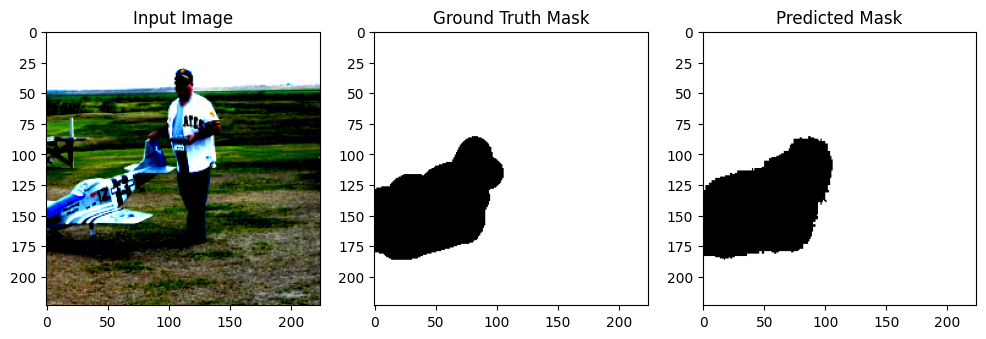

 43%|████▎     | 59/138 [02:12<03:07,  2.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0007002..2.2739873].


tensor(0.0172)


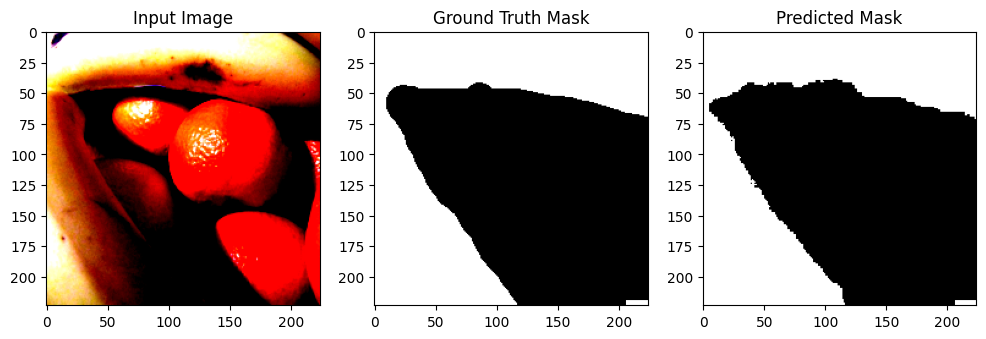

 43%|████▎     | 60/138 [02:13<02:24,  1.85s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0322802..2.622571].


tensor(0.0254)


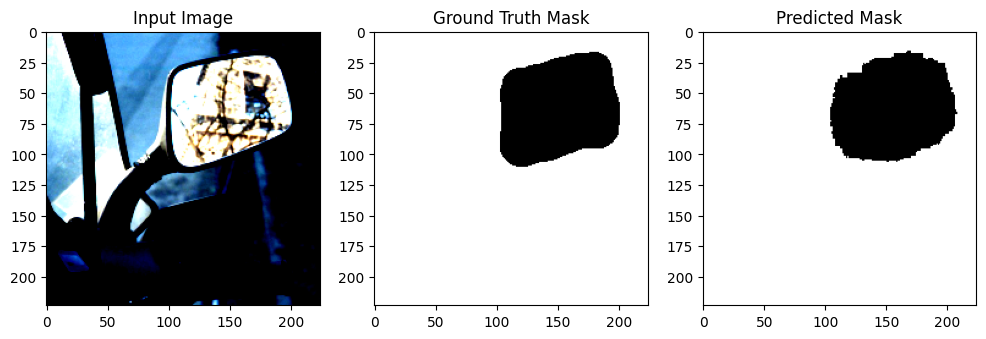

 44%|████▍     | 61/138 [02:14<01:55,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0221)


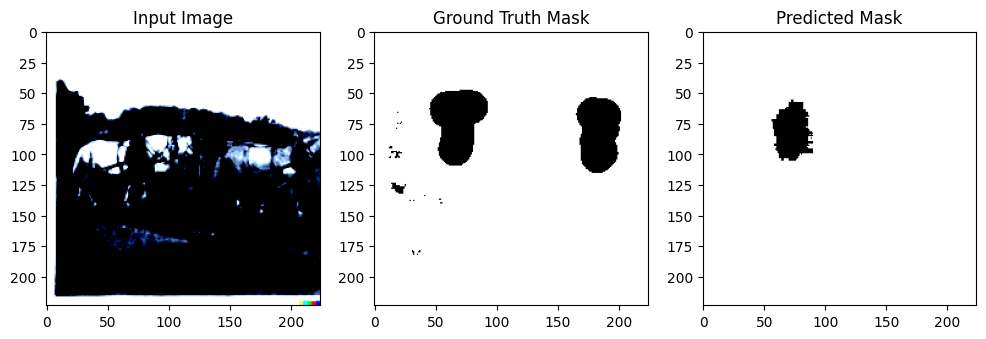

 45%|████▍     | 62/138 [02:14<01:31,  1.20s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0151556..2.2489083].


tensor(0.0183)


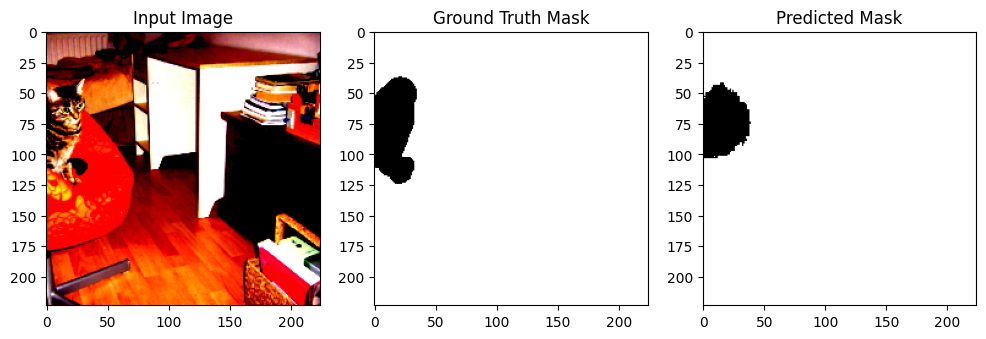

 46%|████▌     | 63/138 [02:15<01:19,  1.06s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0357141..2.64].


tensor(0.0175)


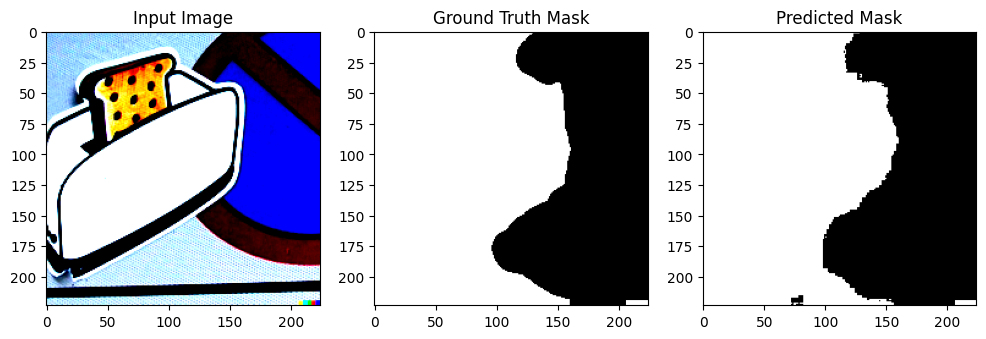

 46%|████▋     | 64/138 [02:16<01:09,  1.06it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9980307..2.64].


tensor(0.0190)


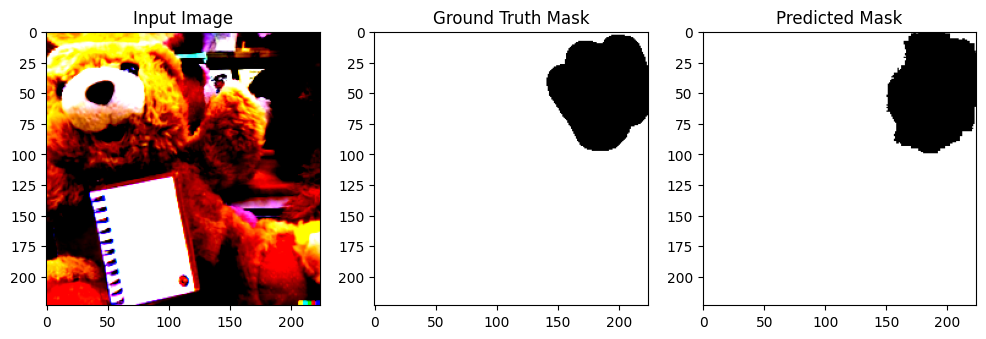

 47%|████▋     | 65/138 [02:27<04:58,  4.09s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0228)


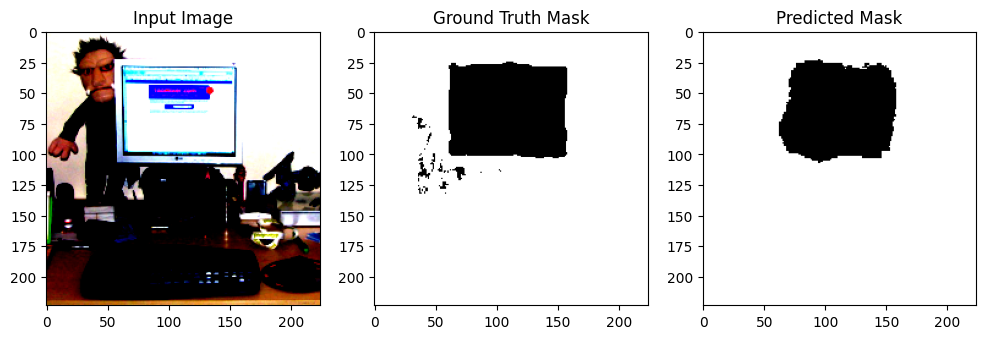

 48%|████▊     | 66/138 [02:28<03:45,  3.13s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.186841].


tensor(0.0200)


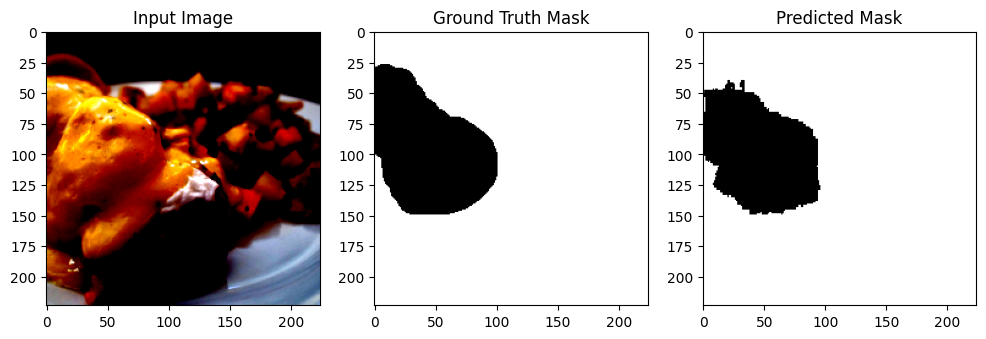

 49%|████▊     | 67/138 [02:28<02:47,  2.36s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.0262864].


tensor(0.0238)


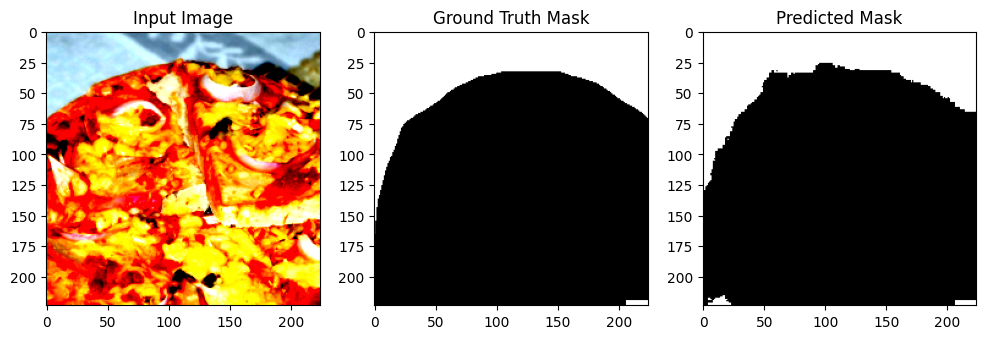

 49%|████▉     | 68/138 [02:29<02:09,  1.85s/it]

tensor(0.0243)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


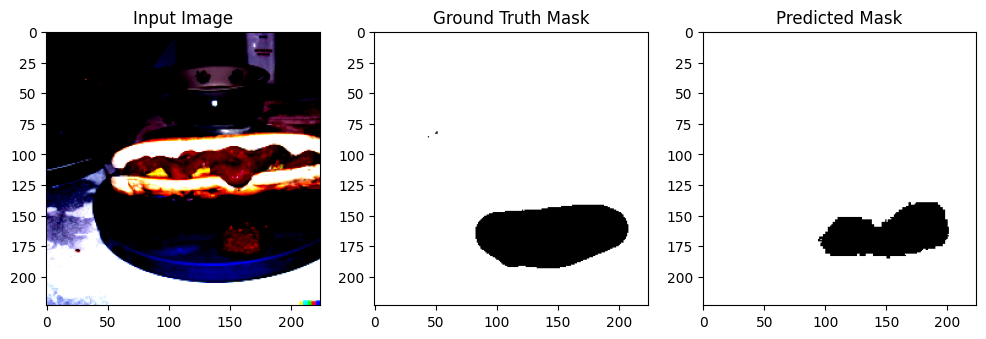

 50%|█████     | 69/138 [02:30<01:52,  1.63s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0216)


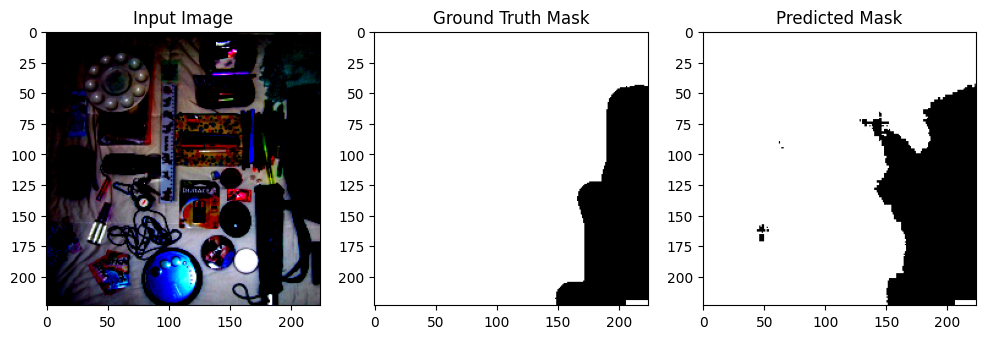

 51%|█████     | 70/138 [02:31<01:32,  1.37s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.64].


tensor(0.0274)


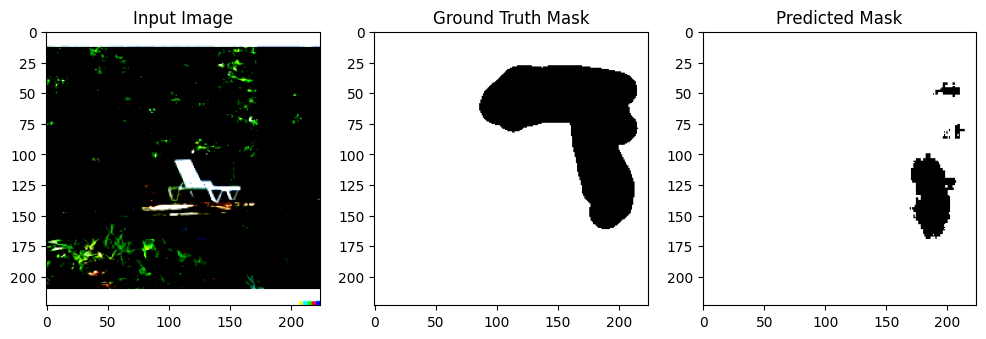

 51%|█████▏    | 71/138 [02:32<01:15,  1.13s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.980906..2.5702832].


tensor(0.0203)


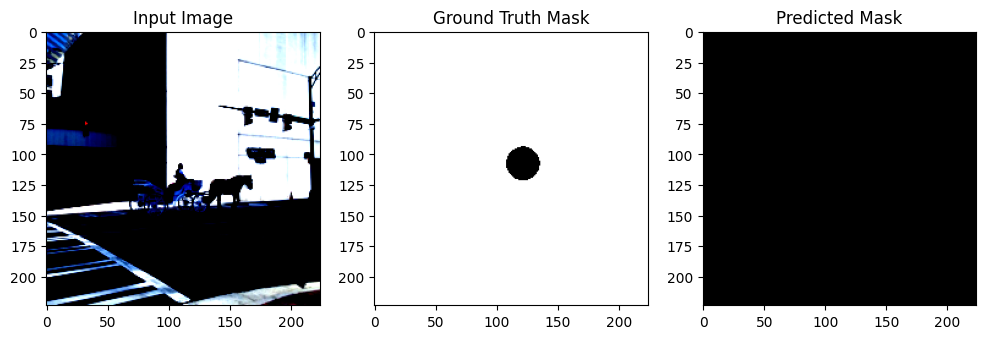

 52%|█████▏    | 72/138 [02:32<01:04,  1.03it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0182073..2.64].


tensor(0.0176)


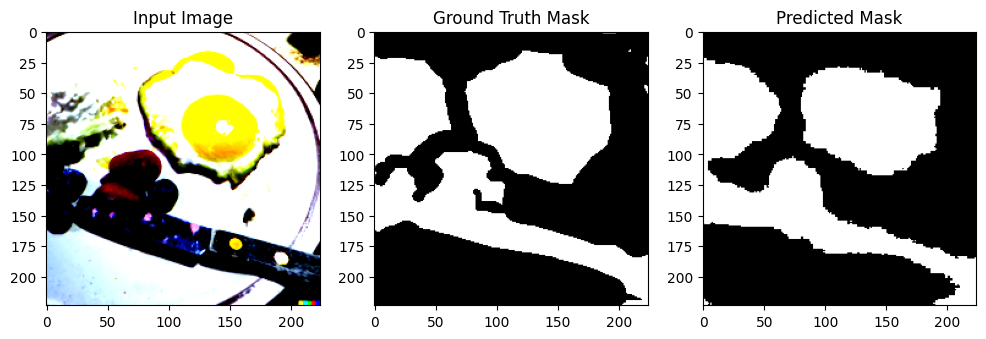

 53%|█████▎    | 73/138 [02:44<04:29,  4.14s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0226)


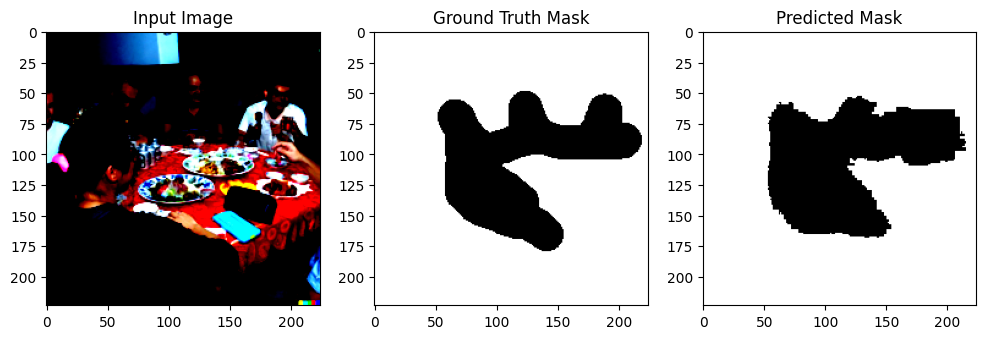

 54%|█████▎    | 74/138 [02:45<03:21,  3.15s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.622571].


tensor(0.0160)


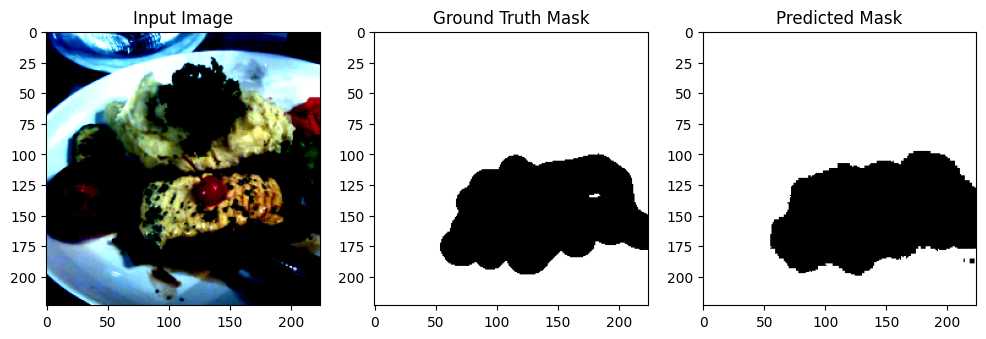

 54%|█████▍    | 75/138 [02:45<02:29,  2.37s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0151556..2.64].


tensor(0.0164)


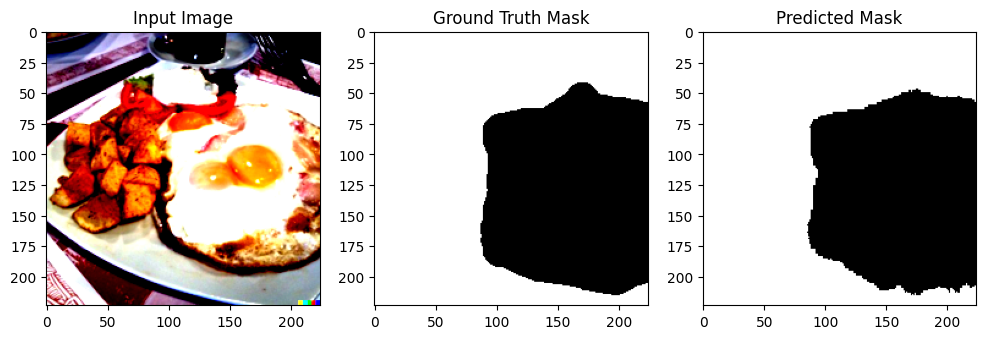

 55%|█████▌    | 76/138 [02:46<01:52,  1.81s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0151556..2.64].


tensor(0.0242)


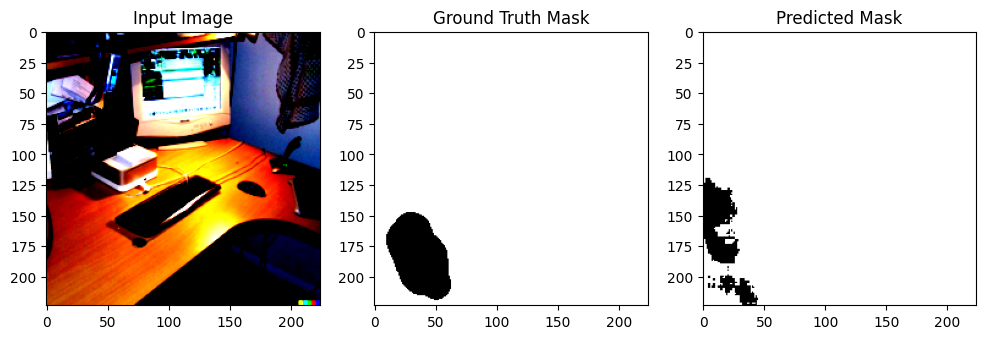

 56%|█████▌    | 77/138 [02:46<01:26,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8952821..2.64].


tensor(0.0180)


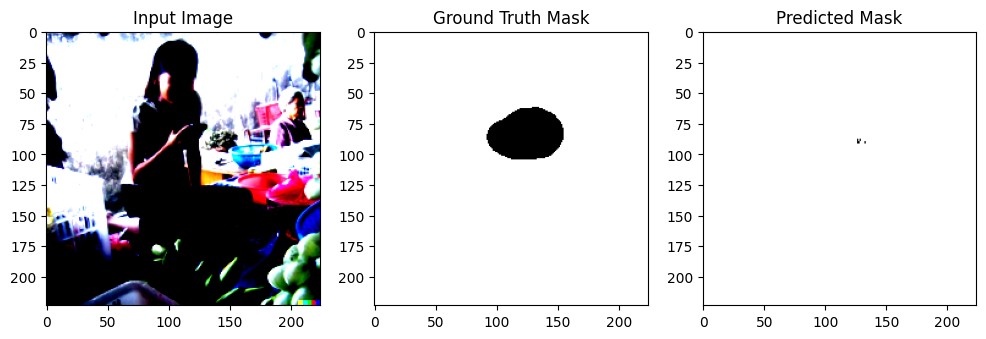

 57%|█████▋    | 78/138 [02:47<01:11,  1.19s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].


tensor(0.0228)


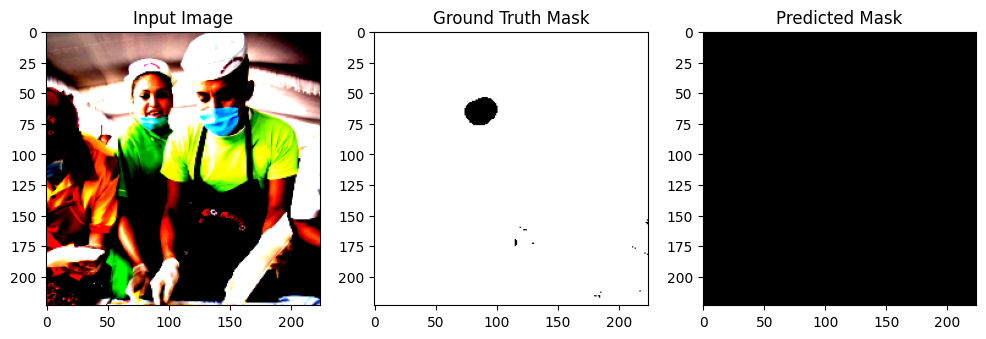

 57%|█████▋    | 79/138 [02:47<00:58,  1.00it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.64].


tensor(0.0169)


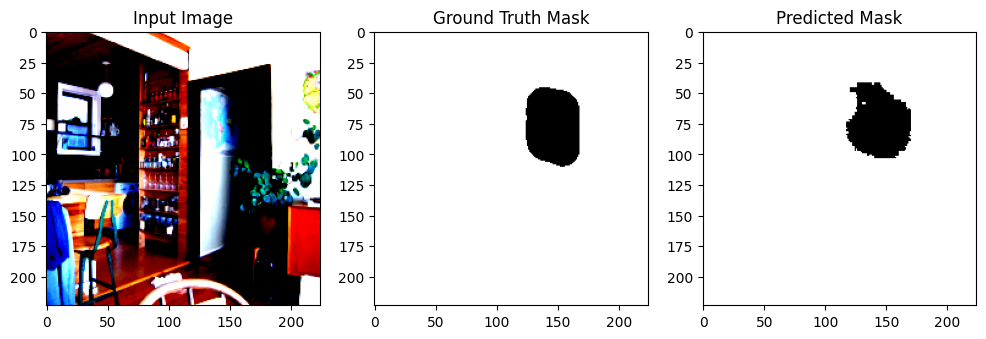

 58%|█████▊    | 80/138 [02:48<00:51,  1.12it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9124069..2.64].


tensor(0.0219)


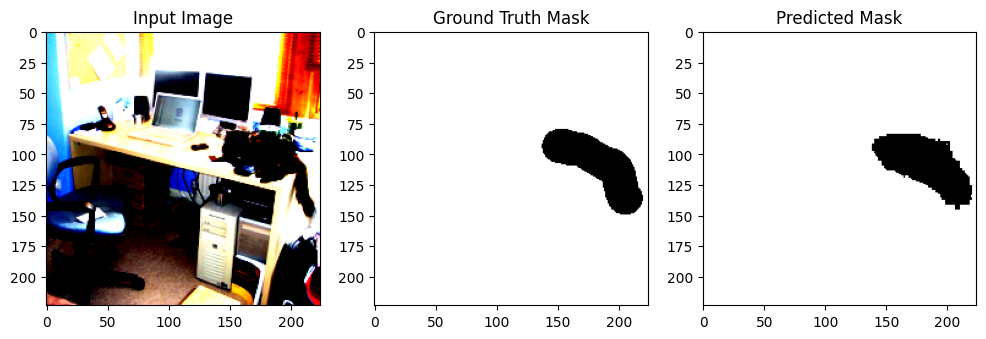

 59%|█████▊    | 81/138 [03:00<04:05,  4.30s/it]

tensor(0.0170)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


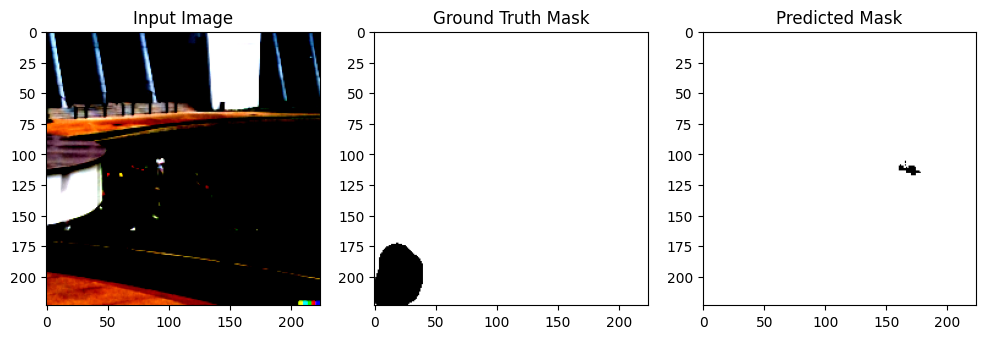

 59%|█████▉    | 82/138 [03:02<03:15,  3.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9481792..2.64].


tensor(0.0192)


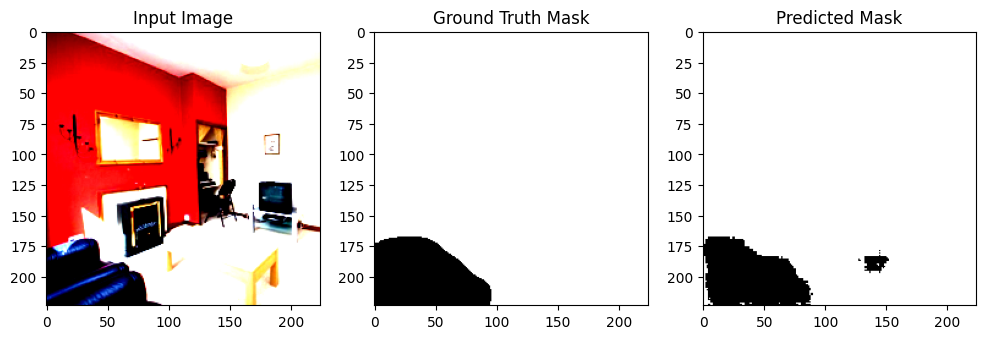

 60%|██████    | 83/138 [03:03<02:26,  2.66s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.4157891..2.2914162].


tensor(0.0189)


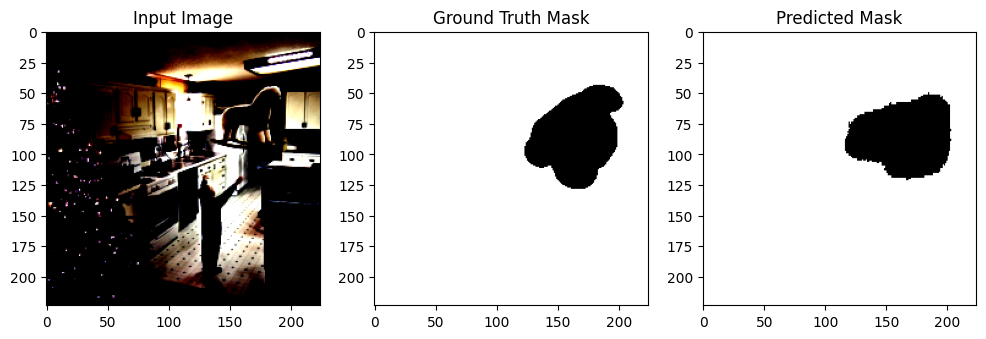

 61%|██████    | 84/138 [03:03<01:54,  2.12s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..2.2565577].


tensor(0.0244)


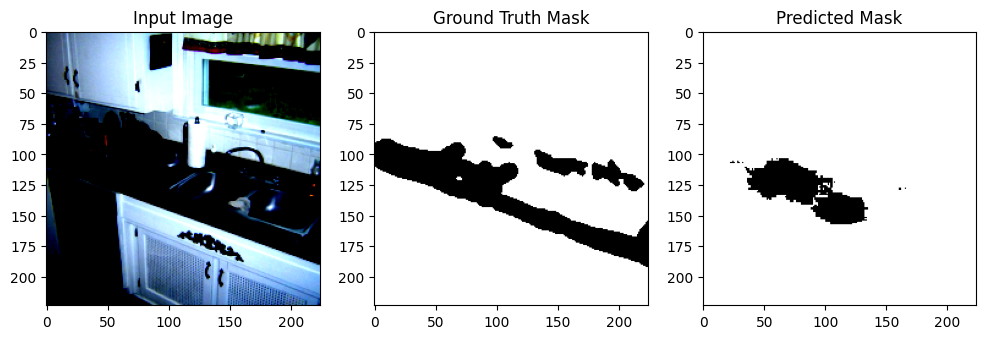

 62%|██████▏   | 85/138 [03:04<01:30,  1.72s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0293)


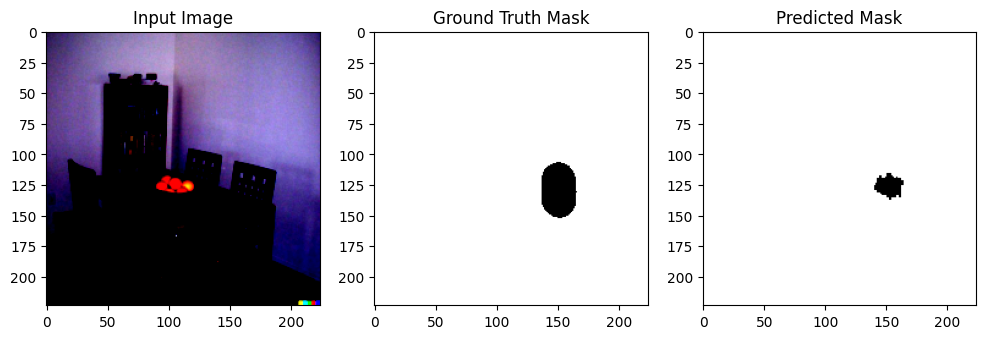

 62%|██████▏   | 86/138 [03:05<01:17,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6212862..2.622571].


tensor(0.0201)


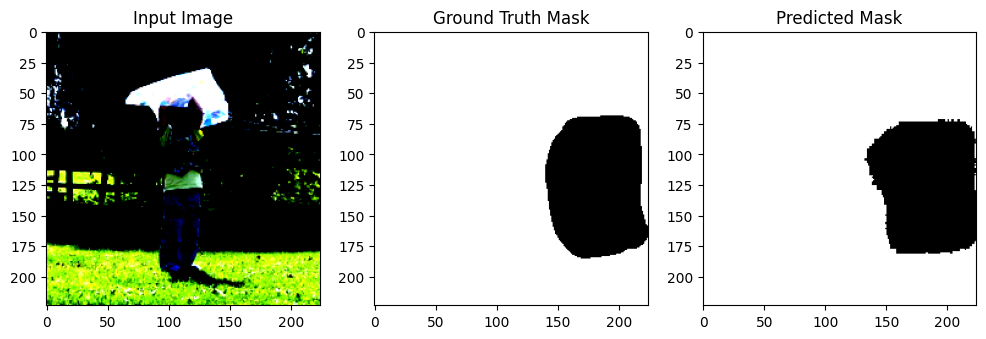

 63%|██████▎   | 87/138 [03:06<01:03,  1.25s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9481792..2.64].


tensor(0.0154)


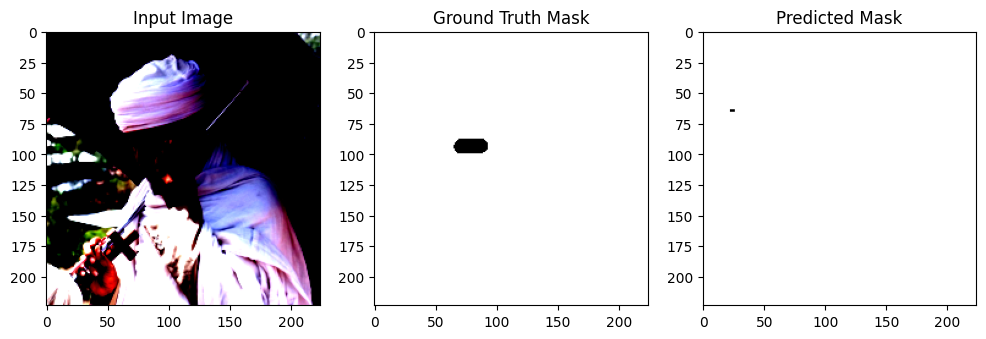

 64%|██████▍   | 88/138 [03:06<00:53,  1.06s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].


tensor(0.0174)


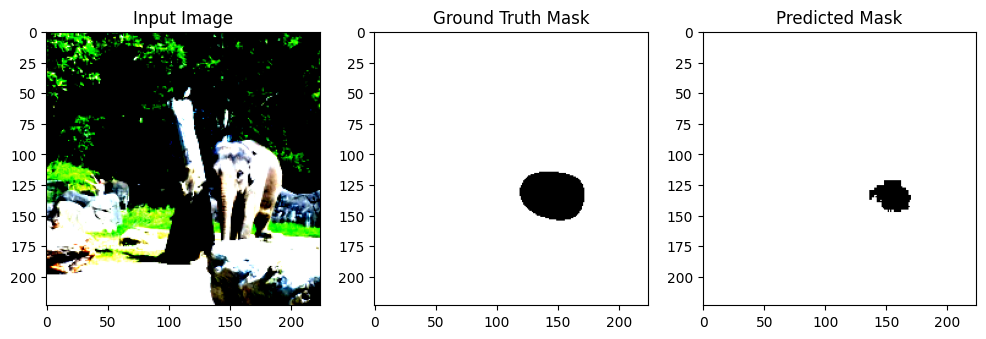

 64%|██████▍   | 89/138 [03:18<03:21,  4.11s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.2489083].


tensor(0.0227)


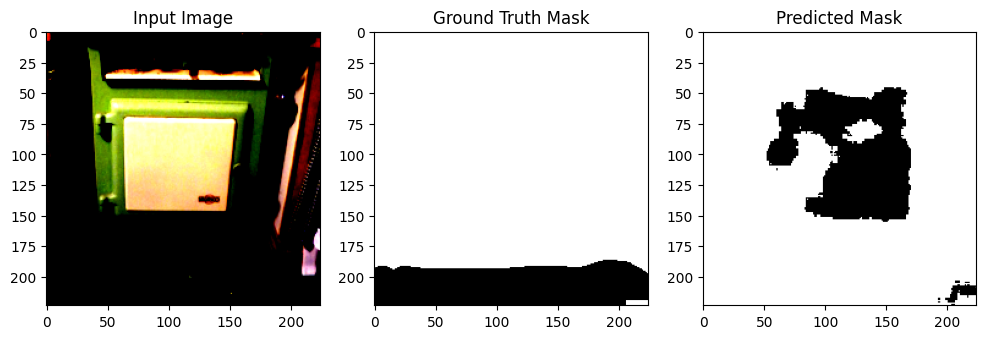

 65%|██████▌   | 90/138 [03:19<02:42,  3.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


tensor(0.0250)


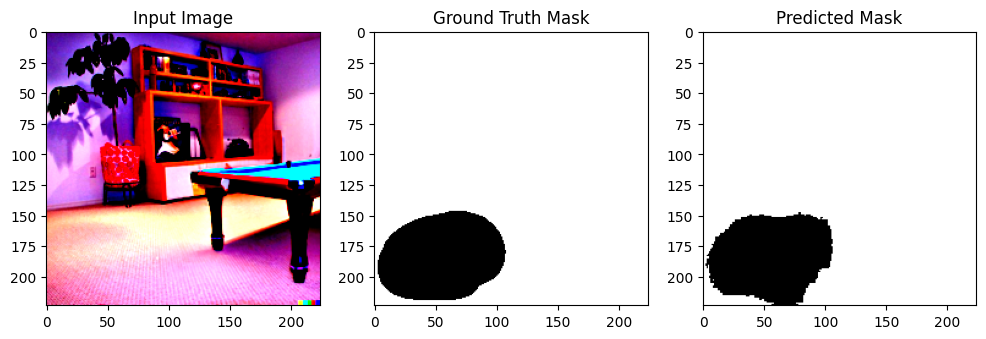

 66%|██████▌   | 91/138 [03:20<02:02,  2.61s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0211)


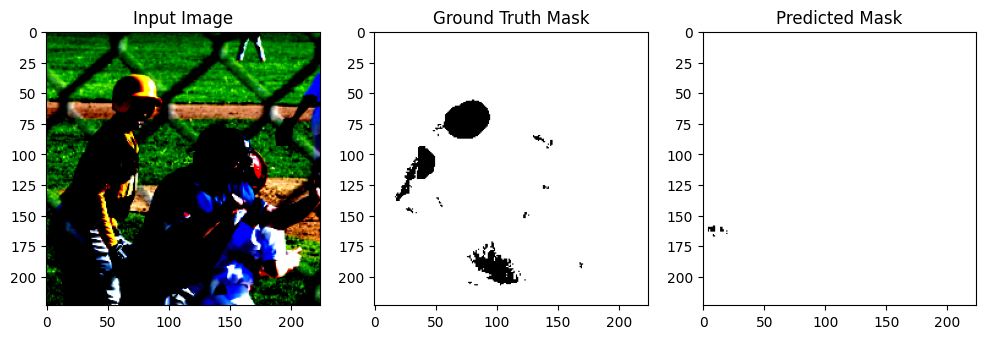

 67%|██████▋   | 92/138 [03:21<01:35,  2.07s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0164)


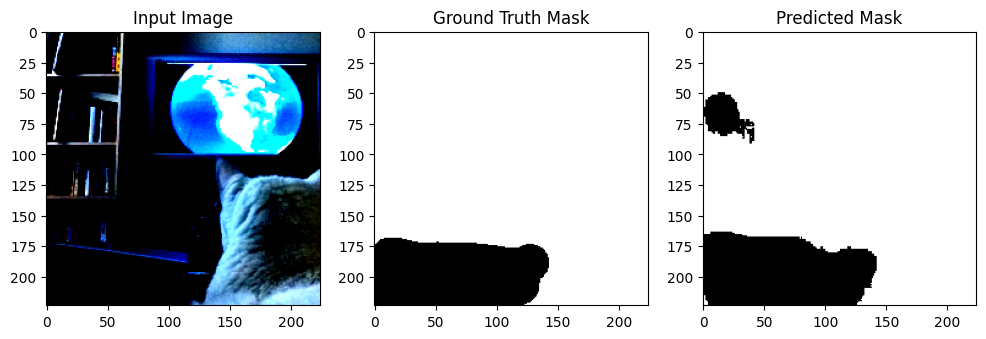

 67%|██████▋   | 93/138 [03:22<01:14,  1.66s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0189)


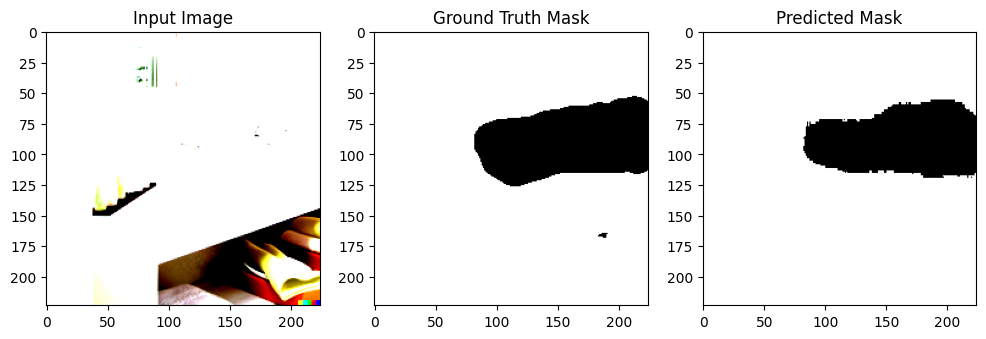

 68%|██████▊   | 94/138 [03:23<01:07,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0357141..2.64].


tensor(0.0198)


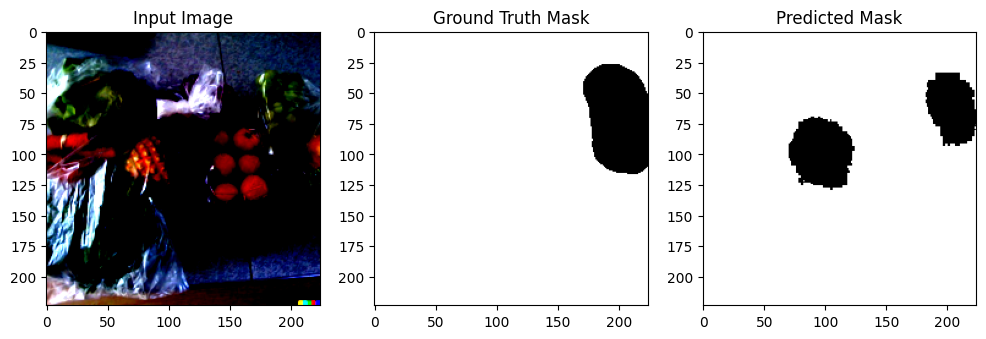

 69%|██████▉   | 95/138 [03:24<00:55,  1.29s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.5702832].


tensor(0.0186)


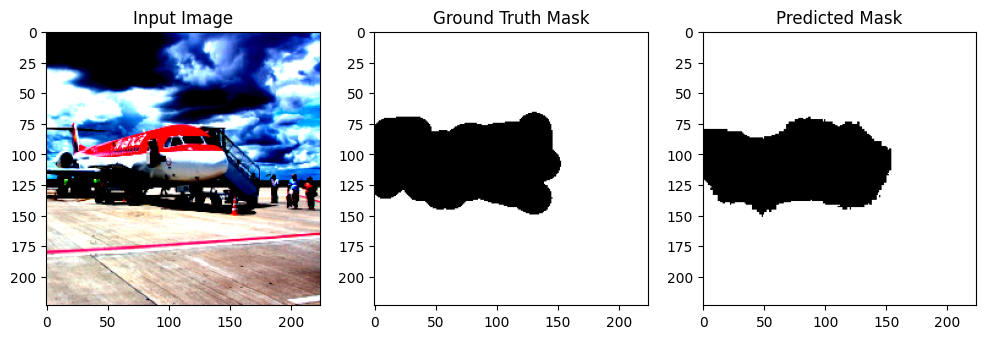

 70%|██████▉   | 96/138 [03:24<00:47,  1.12s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0240)


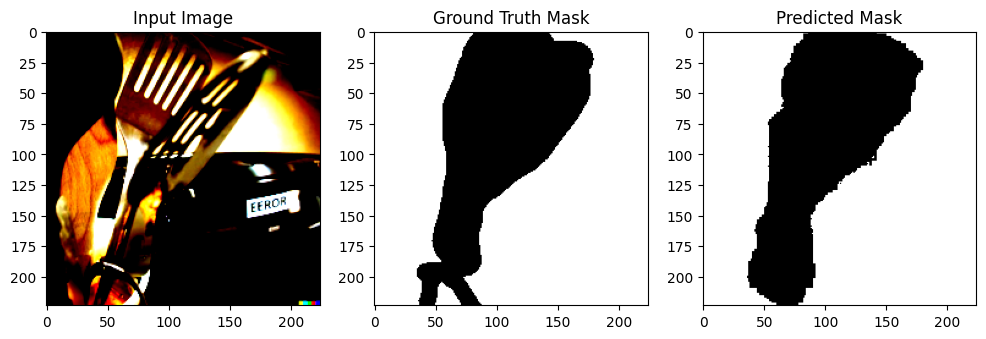

 70%|███████   | 97/138 [03:35<02:40,  3.92s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.64].


tensor(0.0169)


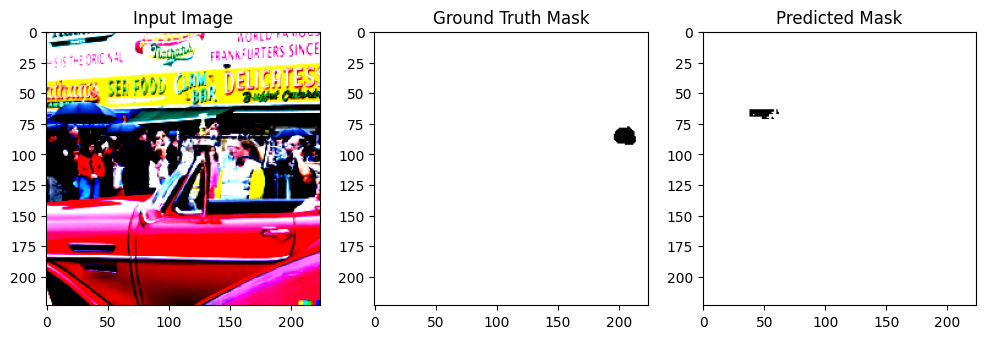

 71%|███████   | 98/138 [03:37<02:13,  3.34s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.64].


tensor(0.0125)


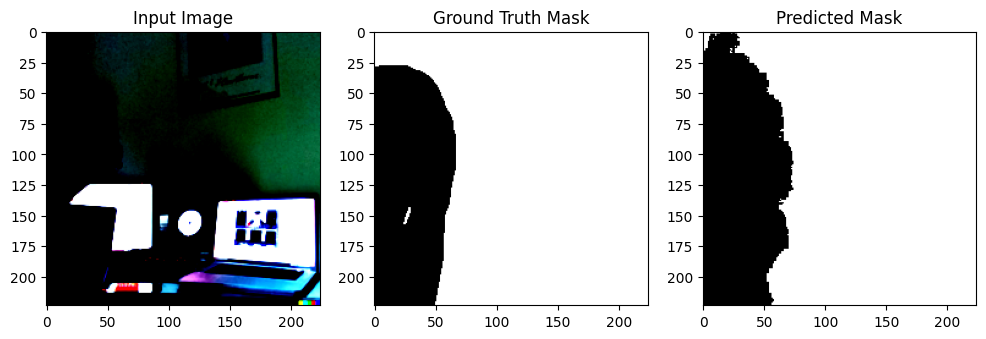

 72%|███████▏  | 99/138 [03:37<01:38,  2.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9980307..2.622571].


tensor(0.0105)


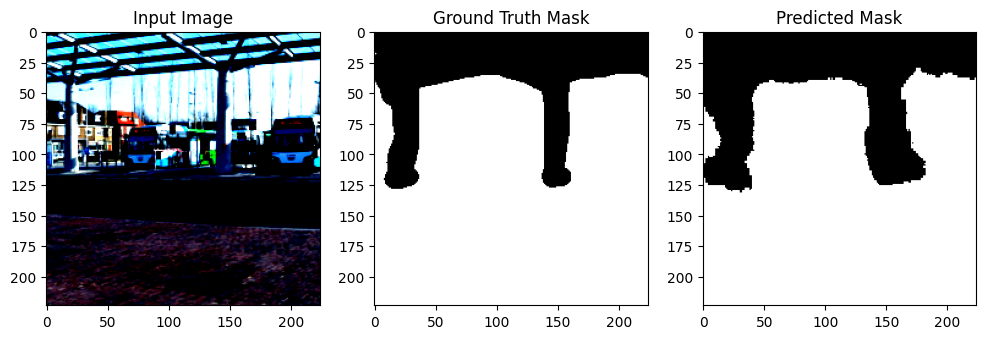

 72%|███████▏  | 100/138 [03:38<01:16,  2.02s/it]

tensor(0.0185)


 72%|███████▏  | 100/138 [03:50<01:27,  2.31s/it]


In [22]:
import torch
import matplotlib.pyplot as plt
from tqdm import tqdm

model = torch.load("crossattention+dice_maskpredictor_100-200.pth")
model.eval() 

with torch.no_grad(): 
    for i, (text_embedding, img, gt_mask) in enumerate(tqdm(test_loader)):
        text_embedding = text_embedding.to(device) 
        img = img.to(device) 
        gt_mask = gt_mask.to(device) 

        pred_mask = model(img, text_embedding)

        pred_mask = (pred_mask > 0.5).float()
        
        img = img.cpu()
        gt_mask = gt_mask.cpu()
        pred_mask = pred_mask.cpu()
        
        def dice_loss(pred, target, smooth=1):
            intersection = (pred * target).sum()
            dice = (2. * intersection + smooth) / (pred.sum() + target.sum() + smooth)
            return 1 - dice
        
        print(dice_loss(pred_mask,gt_mask))
        
        if i < 100: 
            fig, axes = plt.subplots(1, 3, figsize=(12, 4))
            axes[0].imshow(img[0].permute(1, 2, 0))
            axes[0].set_title("Input Image")
            axes[1].imshow(gt_mask[0].squeeze(), cmap="gray") 
            axes[1].set_title("Ground Truth Mask")
            axes[2].imshow(pred_mask[0].squeeze(), cmap="gray") 
            axes[2].set_title("Predicted Mask")
            plt.show()
        if i==100:
            break


only dice loss [white in fore ground]

In [16]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = MaskPredictor(resnet, projection_layer).to(device)
print(device)

cuda


In [20]:
import torch.optim as optim
from tqdm import tqdm

def dice_loss(pred_mask, target, smooth=1):
    pred_mask=1-pred_mask
    target=1-target
    intersection = (pred_mask * target).sum()
    dice = (2. * intersection + smooth) / (pred_mask.sum() + target.sum() + smooth)
    return  (1 - dice) 

optimizer = optim.Adam(model.parameters(), lr=1e-3)
num_epochs = 100
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    for text_embedding, img, gt_mask in tqdm(train_loader):
        text_embedding = text_embedding.to(device)
        img = img.to(device)
        gt_mask = gt_mask.to(device)

        optimizer.zero_grad()
        pred_mask = model(img, text_embedding)

        loss = dice_loss(pred_mask, gt_mask)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    epoch_loss = running_loss / len(train_loader)
    torch.save(model, "dice_maskpredictor_100.pth")
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}")

100%|██████████| 138/138 [04:50<00:00,  2.10s/it]


Epoch [1/100], Loss: 0.7415


100%|██████████| 138/138 [04:53<00:00,  2.12s/it]


Epoch [2/100], Loss: 0.7323


100%|██████████| 138/138 [05:24<00:00,  2.35s/it]


Epoch [3/100], Loss: 0.7553


100%|██████████| 138/138 [04:38<00:00,  2.02s/it]


Epoch [4/100], Loss: 0.7963


100%|██████████| 138/138 [04:48<00:00,  2.09s/it]


Epoch [5/100], Loss: 0.7634


100%|██████████| 138/138 [04:50<00:00,  2.11s/it]


Epoch [6/100], Loss: 0.8716


100%|██████████| 138/138 [04:52<00:00,  2.12s/it]


Epoch [7/100], Loss: 0.9836


100%|██████████| 138/138 [04:56<00:00,  2.15s/it]


Epoch [8/100], Loss: 0.9967


100%|██████████| 138/138 [05:36<00:00,  2.44s/it]


Epoch [9/100], Loss: 0.9967


100%|██████████| 138/138 [04:45<00:00,  2.07s/it]


Epoch [10/100], Loss: 0.9967


100%|██████████| 138/138 [04:52<00:00,  2.12s/it]


Epoch [11/100], Loss: 0.9967


100%|██████████| 138/138 [04:54<00:00,  2.13s/it]


Epoch [12/100], Loss: 0.9978


100%|██████████| 138/138 [05:45<00:00,  2.50s/it]


Epoch [13/100], Loss: 0.9981


100%|██████████| 138/138 [04:52<00:00,  2.12s/it]


Epoch [14/100], Loss: 0.9981


100%|██████████| 138/138 [04:54<00:00,  2.13s/it]


Epoch [15/100], Loss: 0.9981


100%|██████████| 138/138 [04:56<00:00,  2.15s/it]


Epoch [16/100], Loss: 0.9981


100%|██████████| 138/138 [05:00<00:00,  2.18s/it]


Epoch [17/100], Loss: 0.9981


100%|██████████| 138/138 [05:03<00:00,  2.20s/it]


Epoch [18/100], Loss: 0.9995


100%|██████████| 138/138 [05:48<00:00,  2.53s/it]


Epoch [19/100], Loss: 0.9997


100%|██████████| 138/138 [04:51<00:00,  2.11s/it]


Epoch [20/100], Loss: 0.9997


100%|██████████| 138/138 [04:53<00:00,  2.13s/it]


Epoch [21/100], Loss: 0.9997


100%|██████████| 138/138 [04:59<00:00,  2.17s/it]


Epoch [22/100], Loss: 0.9997


100%|██████████| 138/138 [05:02<00:00,  2.19s/it]


Epoch [23/100], Loss: 0.9997


100%|██████████| 138/138 [05:02<00:00,  2.19s/it]


Epoch [24/100], Loss: 0.9997


100%|██████████| 138/138 [05:03<00:00,  2.20s/it]


Epoch [25/100], Loss: 0.9997


100%|██████████| 138/138 [05:08<00:00,  2.24s/it]


Epoch [26/100], Loss: 0.9997


100%|██████████| 138/138 [05:08<00:00,  2.24s/it]


Epoch [27/100], Loss: 0.9997


100%|██████████| 138/138 [05:31<00:00,  2.40s/it]


Epoch [28/100], Loss: 0.9997


100%|██████████| 138/138 [04:48<00:00,  2.09s/it]


Epoch [29/100], Loss: 0.9997


100%|██████████| 138/138 [04:58<00:00,  2.16s/it]


Epoch [30/100], Loss: 0.9997


100%|██████████| 138/138 [05:04<00:00,  2.21s/it]


Epoch [31/100], Loss: 0.9997


100%|██████████| 138/138 [05:06<00:00,  2.22s/it]


Epoch [32/100], Loss: 0.9997


100%|██████████| 138/138 [05:08<00:00,  2.23s/it]


Epoch [33/100], Loss: 0.9997


100%|██████████| 138/138 [05:46<00:00,  2.51s/it]


Epoch [34/100], Loss: 0.9997


100%|██████████| 138/138 [04:49<00:00,  2.10s/it]


Epoch [35/100], Loss: 0.9997


100%|██████████| 138/138 [05:03<00:00,  2.20s/it]


Epoch [36/100], Loss: 0.9997


100%|██████████| 138/138 [05:05<00:00,  2.21s/it]


Epoch [37/100], Loss: 0.9997


100%|██████████| 138/138 [05:08<00:00,  2.24s/it]


Epoch [38/100], Loss: 0.9997


100%|██████████| 138/138 [06:08<00:00,  2.67s/it]


Epoch [39/100], Loss: 0.9997


100%|██████████| 138/138 [04:46<00:00,  2.08s/it]


Epoch [40/100], Loss: 0.9997


100%|██████████| 138/138 [05:02<00:00,  2.19s/it]


Epoch [41/100], Loss: 0.9997


100%|██████████| 138/138 [05:05<00:00,  2.21s/it]


Epoch [42/100], Loss: 0.9997


100%|██████████| 138/138 [05:07<00:00,  2.23s/it]


Epoch [43/100], Loss: 0.9997


100%|██████████| 138/138 [05:05<00:00,  2.22s/it]


Epoch [44/100], Loss: 0.9997


100%|██████████| 138/138 [05:44<00:00,  2.50s/it]


Epoch [45/100], Loss: 0.9997


100%|██████████| 138/138 [04:55<00:00,  2.14s/it]


Epoch [46/100], Loss: 0.9997


100%|██████████| 138/138 [05:04<00:00,  2.21s/it]


Epoch [47/100], Loss: 0.9997


100%|██████████| 138/138 [06:08<00:00,  2.67s/it]


Epoch [48/100], Loss: 0.9997


100%|██████████| 138/138 [04:55<00:00,  2.14s/it]


Epoch [49/100], Loss: 0.9997


100%|██████████| 138/138 [05:03<00:00,  2.20s/it]


Epoch [50/100], Loss: 0.9997


100%|██████████| 138/138 [05:01<00:00,  2.19s/it]


Epoch [51/100], Loss: 0.9997


100%|██████████| 138/138 [06:02<00:00,  2.63s/it]


Epoch [52/100], Loss: 0.9997


100%|██████████| 138/138 [04:49<00:00,  2.10s/it]


Epoch [53/100], Loss: 0.9997


100%|██████████| 138/138 [04:58<00:00,  2.17s/it]


Epoch [54/100], Loss: 0.9997


100%|██████████| 138/138 [05:04<00:00,  2.21s/it]


Epoch [55/100], Loss: 0.9997


100%|██████████| 138/138 [05:38<00:00,  2.45s/it]


Epoch [56/100], Loss: 0.9997


100%|██████████| 138/138 [04:59<00:00,  2.17s/it]


Epoch [57/100], Loss: 0.9997


100%|██████████| 138/138 [05:06<00:00,  2.22s/it]


Epoch [58/100], Loss: 0.9997


100%|██████████| 138/138 [05:07<00:00,  2.23s/it]


Epoch [59/100], Loss: 0.9997


100%|██████████| 138/138 [05:08<00:00,  2.23s/it]


Epoch [60/100], Loss: 0.9997


100%|██████████| 138/138 [05:09<00:00,  2.24s/it]


Epoch [61/100], Loss: 0.9997


100%|██████████| 138/138 [05:10<00:00,  2.25s/it]


Epoch [62/100], Loss: 0.9997


100%|██████████| 138/138 [05:09<00:00,  2.24s/it]


Epoch [63/100], Loss: 0.9997


100%|██████████| 138/138 [05:12<00:00,  2.27s/it]


Epoch [64/100], Loss: 0.9997


100%|██████████| 138/138 [05:11<00:00,  2.26s/it]


Epoch [65/100], Loss: 0.9997


100%|██████████| 138/138 [05:13<00:00,  2.27s/it]


Epoch [66/100], Loss: 0.9997


100%|██████████| 138/138 [05:42<00:00,  2.48s/it]


Epoch [67/100], Loss: 0.9997


100%|██████████| 138/138 [04:52<00:00,  2.12s/it]


Epoch [68/100], Loss: 0.9997


100%|██████████| 138/138 [05:01<00:00,  2.18s/it]


Epoch [69/100], Loss: 0.9997


100%|██████████| 138/138 [05:08<00:00,  2.24s/it]


Epoch [70/100], Loss: 0.9997


100%|██████████| 138/138 [05:08<00:00,  2.24s/it]


Epoch [71/100], Loss: 0.9997


100%|██████████| 138/138 [05:12<00:00,  2.27s/it]


Epoch [72/100], Loss: 0.9997


100%|██████████| 138/138 [05:12<00:00,  2.27s/it]


Epoch [73/100], Loss: 0.9997


100%|██████████| 138/138 [05:09<00:00,  2.24s/it]


Epoch [74/100], Loss: 0.9997


100%|██████████| 138/138 [05:06<00:00,  2.22s/it]


Epoch [75/100], Loss: 0.9997


100%|██████████| 138/138 [05:10<00:00,  2.25s/it]


Epoch [76/100], Loss: 0.9997


100%|██████████| 138/138 [05:04<00:00,  2.20s/it]


Epoch [77/100], Loss: 0.9997


100%|██████████| 138/138 [05:05<00:00,  2.22s/it]


Epoch [78/100], Loss: 0.9997


100%|██████████| 138/138 [06:01<00:00,  2.62s/it]


Epoch [79/100], Loss: 0.9997


100%|██████████| 138/138 [04:51<00:00,  2.11s/it]


Epoch [80/100], Loss: 0.9997


100%|██████████| 138/138 [04:59<00:00,  2.17s/it]


Epoch [81/100], Loss: 0.9997


100%|██████████| 138/138 [05:08<00:00,  2.24s/it]


Epoch [82/100], Loss: 0.9997


100%|██████████| 138/138 [05:08<00:00,  2.24s/it]


Epoch [83/100], Loss: 0.9997


100%|██████████| 138/138 [05:56<00:00,  2.58s/it]


Epoch [84/100], Loss: 0.9997


100%|██████████| 138/138 [04:54<00:00,  2.14s/it]


Epoch [85/100], Loss: 0.9997


100%|██████████| 138/138 [05:01<00:00,  2.19s/it]


Epoch [86/100], Loss: 0.9997


100%|██████████| 138/138 [05:02<00:00,  2.19s/it]


Epoch [87/100], Loss: 0.9997


100%|██████████| 138/138 [05:10<00:00,  2.25s/it]


Epoch [88/100], Loss: 0.9997


100%|██████████| 138/138 [05:09<00:00,  2.24s/it]


Epoch [89/100], Loss: 0.9997


100%|██████████| 138/138 [05:57<00:00,  2.59s/it]


Epoch [90/100], Loss: 0.9997


100%|██████████| 138/138 [04:53<00:00,  2.12s/it]


Epoch [91/100], Loss: 0.9997


100%|██████████| 138/138 [05:00<00:00,  2.18s/it]


Epoch [92/100], Loss: 0.9997


100%|██████████| 138/138 [05:09<00:00,  2.24s/it]


Epoch [93/100], Loss: 0.9997


100%|██████████| 138/138 [05:11<00:00,  2.26s/it]


Epoch [94/100], Loss: 0.9997


100%|██████████| 138/138 [05:53<00:00,  2.56s/it]


Epoch [95/100], Loss: 0.9997


100%|██████████| 138/138 [04:52<00:00,  2.12s/it]


Epoch [96/100], Loss: 0.9997


100%|██████████| 138/138 [04:58<00:00,  2.16s/it]


Epoch [97/100], Loss: 0.9997


100%|██████████| 138/138 [05:03<00:00,  2.20s/it]


Epoch [98/100], Loss: 0.9997


100%|██████████| 138/138 [05:06<00:00,  2.22s/it]


Epoch [99/100], Loss: 0.9997


100%|██████████| 138/138 [05:10<00:00,  2.25s/it]


Epoch [100/100], Loss: 0.9997


/tmp/ipykernel_1984198/3204714818.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load("dice_maskpredictor_100.pth")
  0%|          | 0/138 [00:00<?, ?it/s

tensor(0.1294)


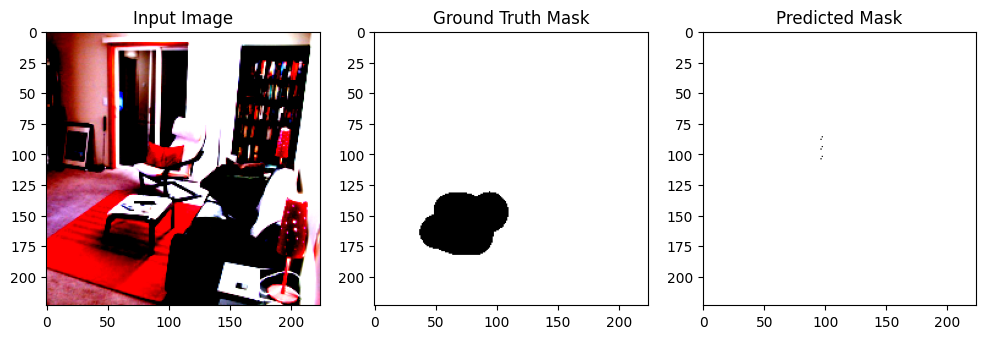

  1%|          | 1/138 [00:15<35:58, 15.75s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0755)


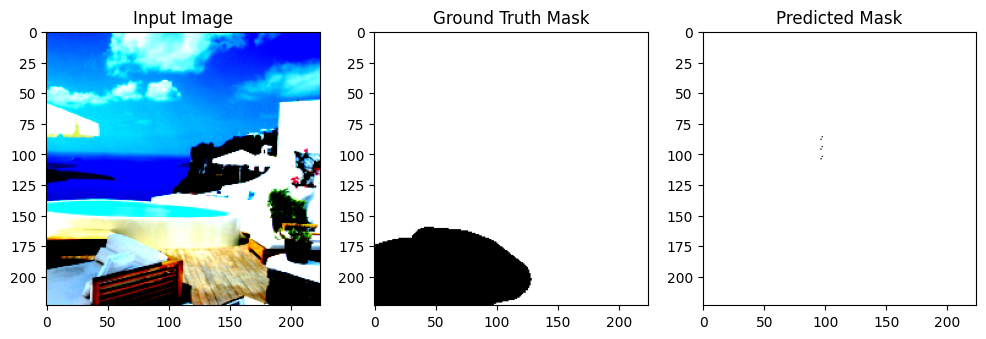

  1%|▏         | 2/138 [00:16<15:30,  6.84s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0614)


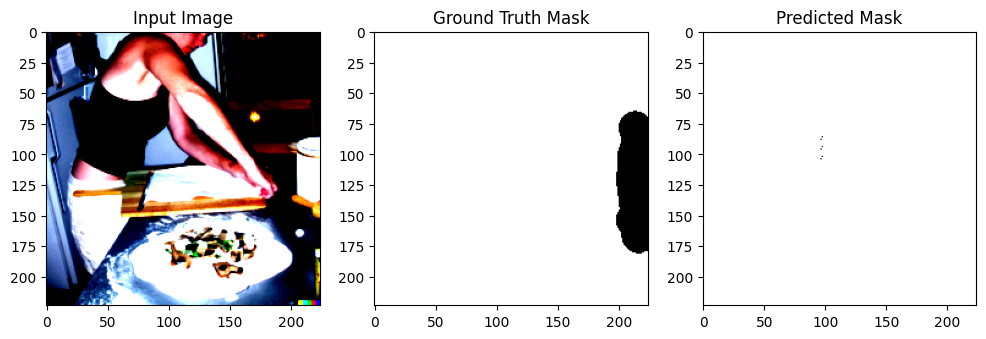

  2%|▏         | 3/138 [00:17<09:07,  4.06s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0869)


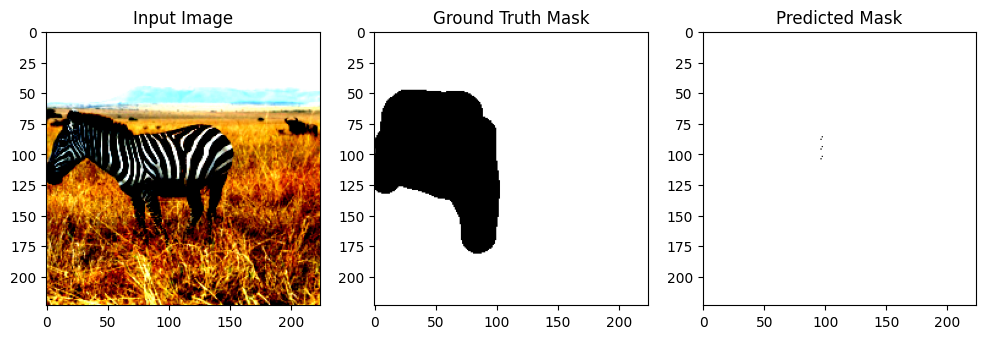

  3%|▎         | 4/138 [00:17<06:03,  2.71s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9980307..2.64].


tensor(0.0820)


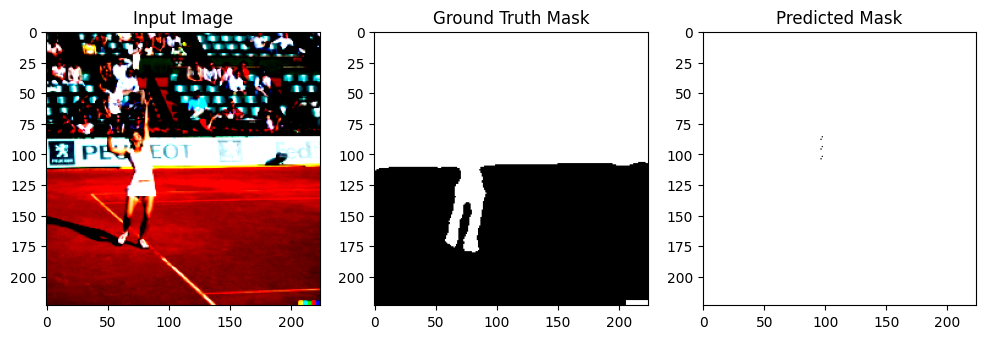

  4%|▎         | 5/138 [00:18<04:11,  1.89s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0843)


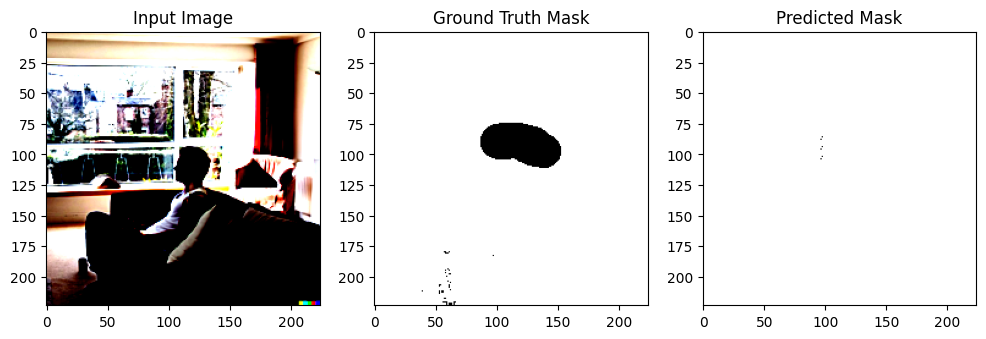

  4%|▍         | 6/138 [00:18<03:09,  1.44s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0357141..2.64].


tensor(0.0559)


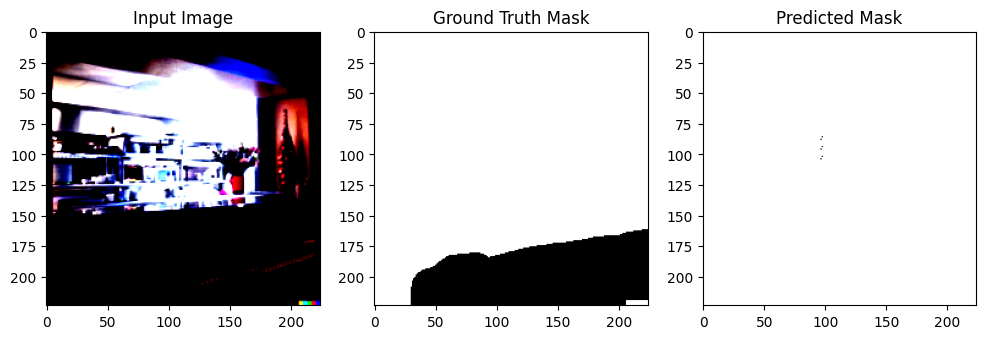

  5%|▌         | 7/138 [00:19<02:28,  1.14s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6384109..2.64].


tensor(0.1294)


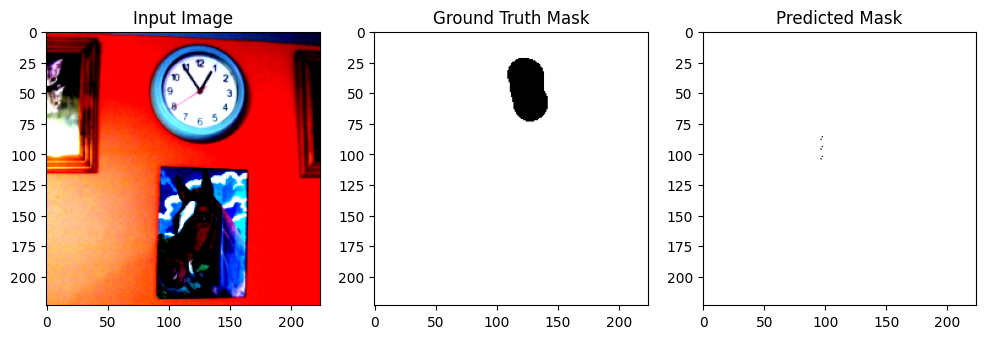

  6%|▌         | 8/138 [00:19<02:04,  1.04it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].


tensor(0.0603)


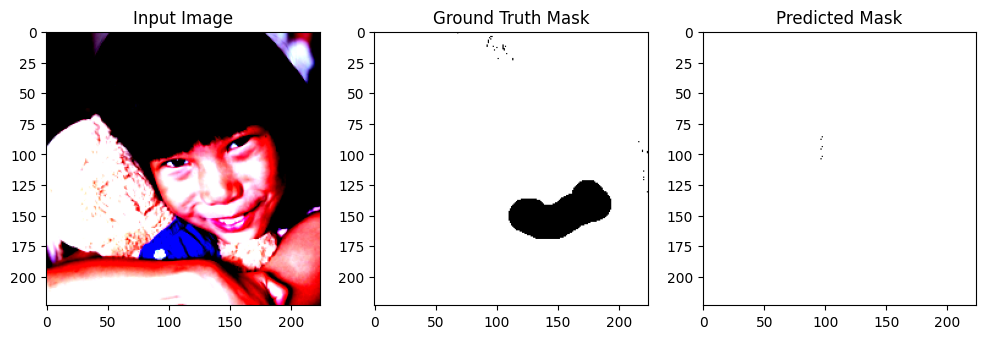

  7%|▋         | 9/138 [00:29<07:54,  3.68s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


tensor(0.0992)


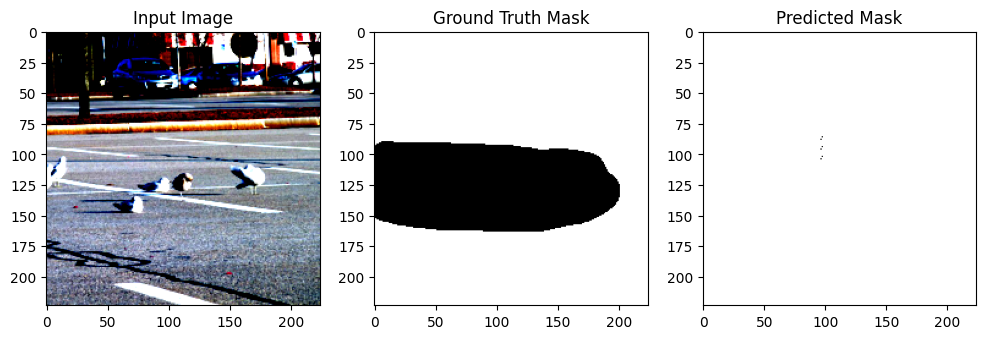

  7%|▋         | 10/138 [00:30<05:57,  2.79s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0613)


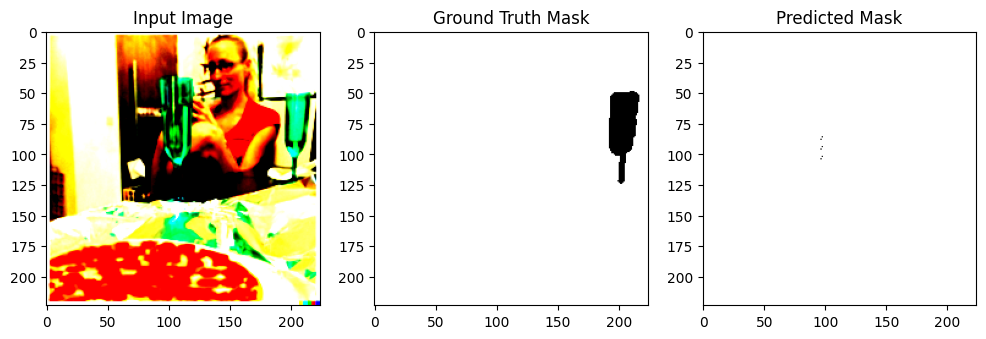

  8%|▊         | 11/138 [00:31<04:34,  2.16s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0770)


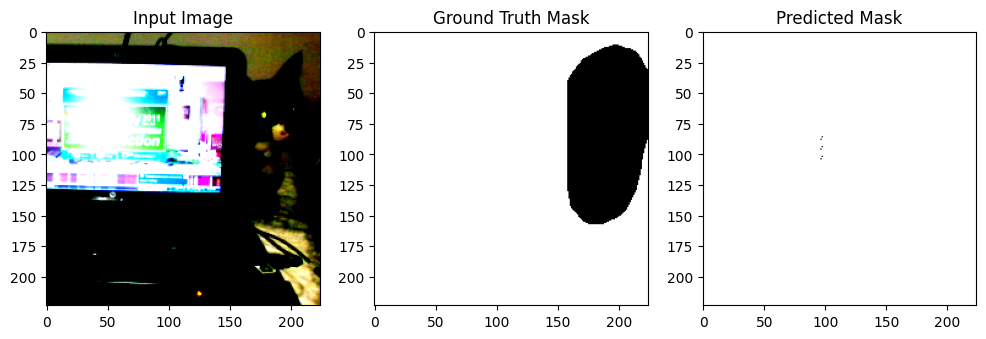

  9%|▊         | 12/138 [00:31<03:24,  1.63s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


tensor(0.0704)


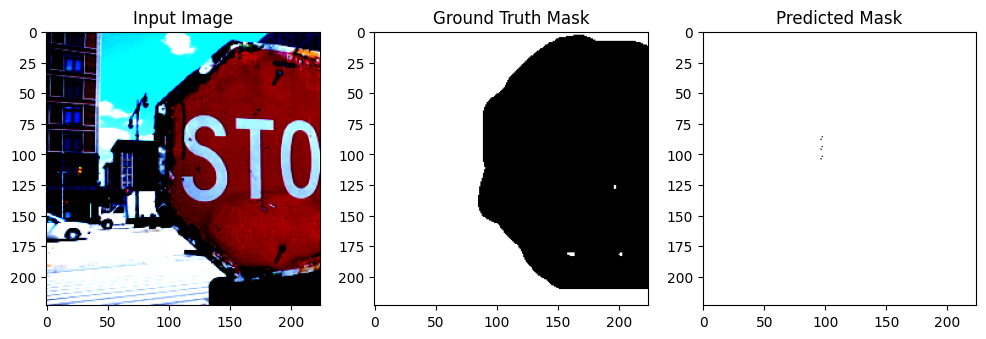

  9%|▉         | 13/138 [00:31<02:38,  1.27s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0322802..2.64].


tensor(0.0878)


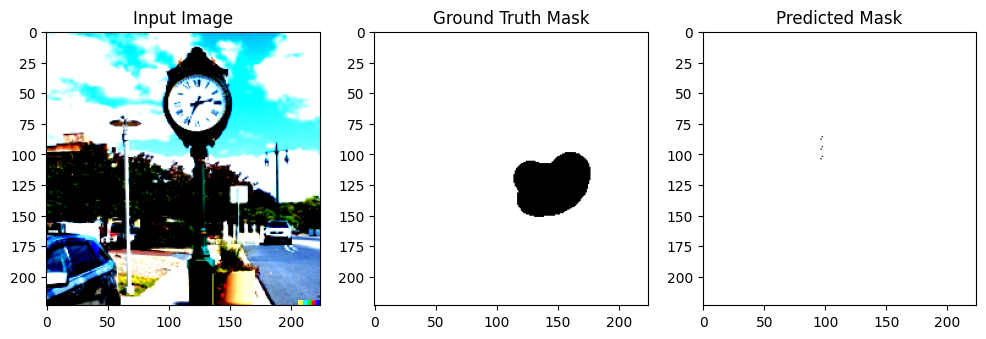

 10%|█         | 14/138 [00:32<02:18,  1.12s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9637812..2.5702832].


tensor(0.0959)


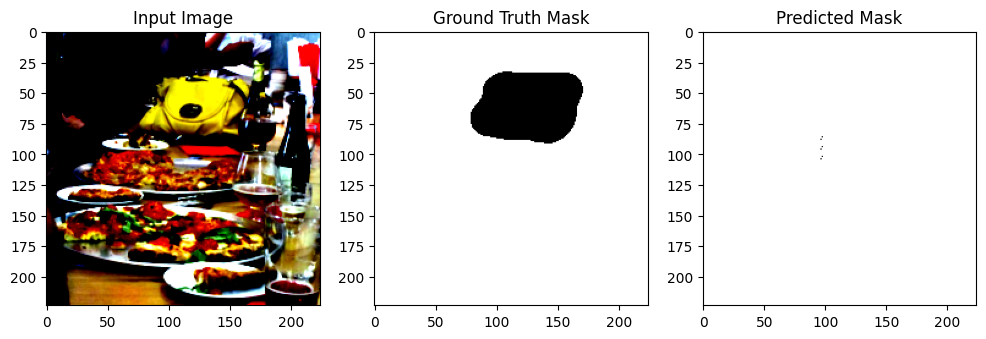

 11%|█         | 15/138 [00:33<01:57,  1.04it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.64].


tensor(0.0873)


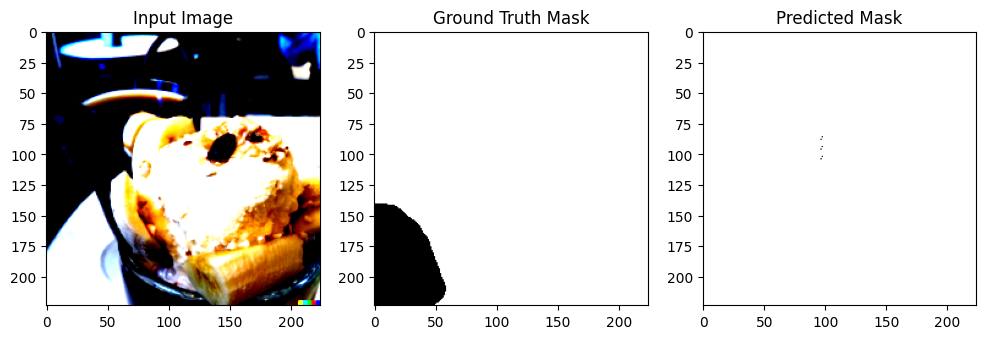

 12%|█▏        | 16/138 [00:33<01:45,  1.15it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9980307..2.64].


tensor(0.0532)


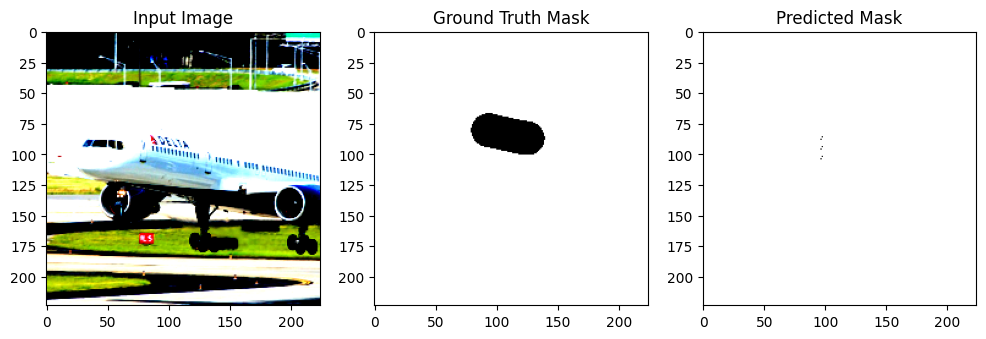

 12%|█▏        | 17/138 [00:46<08:45,  4.34s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0800)


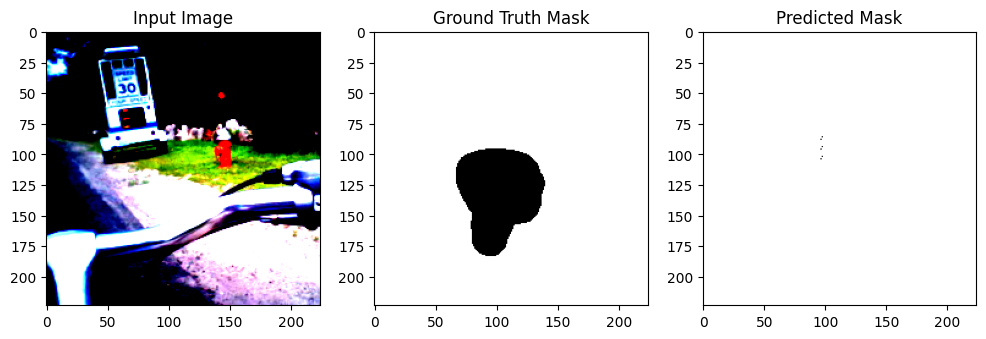

 13%|█▎        | 18/138 [00:46<06:23,  3.19s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0564)


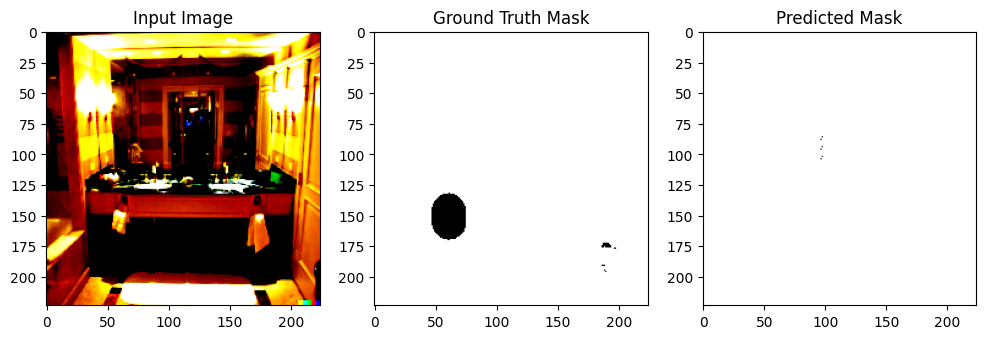

 14%|█▍        | 19/138 [00:47<04:45,  2.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


tensor(0.0796)


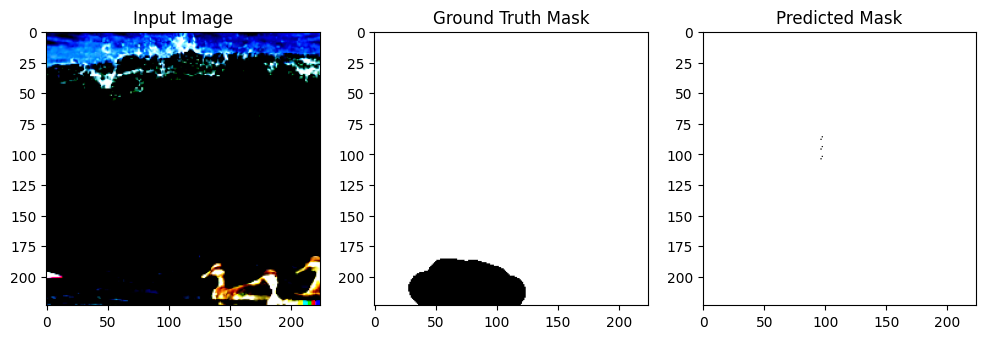

 14%|█▍        | 20/138 [00:47<03:34,  1.82s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0963)


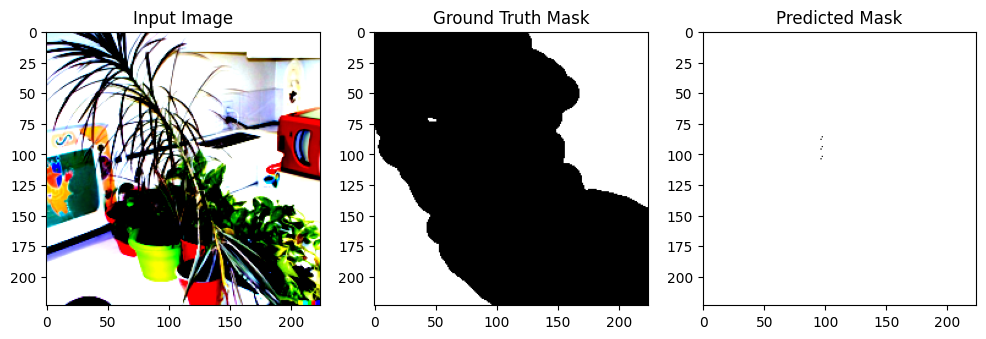

 15%|█▌        | 21/138 [00:48<02:51,  1.47s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8556864].


tensor(0.0884)


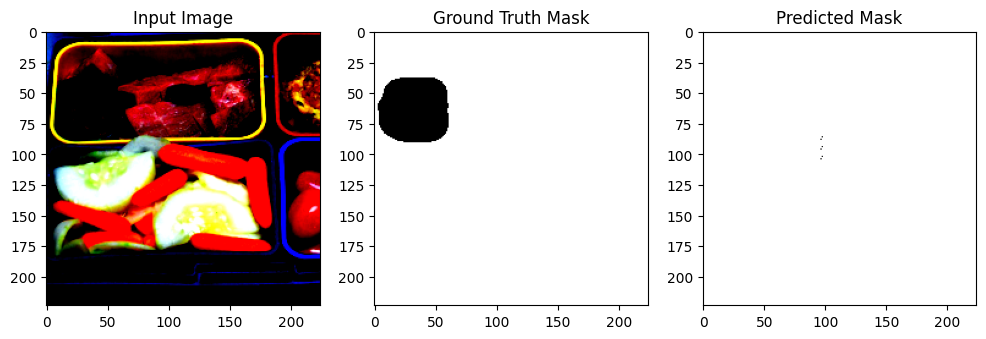

 16%|█▌        | 22/138 [00:49<02:27,  1.27s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0812)


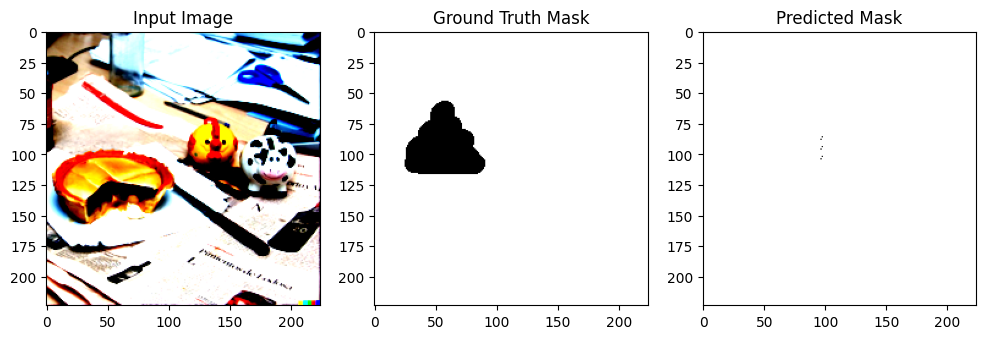

 17%|█▋        | 23/138 [00:49<02:00,  1.05s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0505)


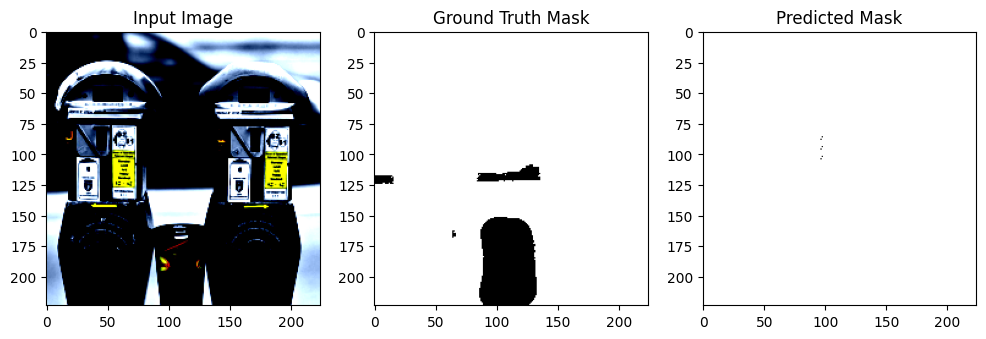

 17%|█▋        | 24/138 [00:50<01:43,  1.10it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0919)


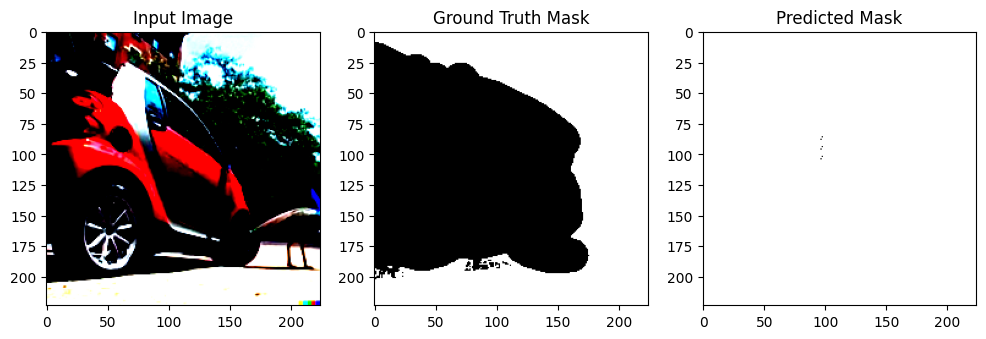

 18%|█▊        | 25/138 [01:02<08:08,  4.32s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9980307..2.64].


tensor(0.0863)


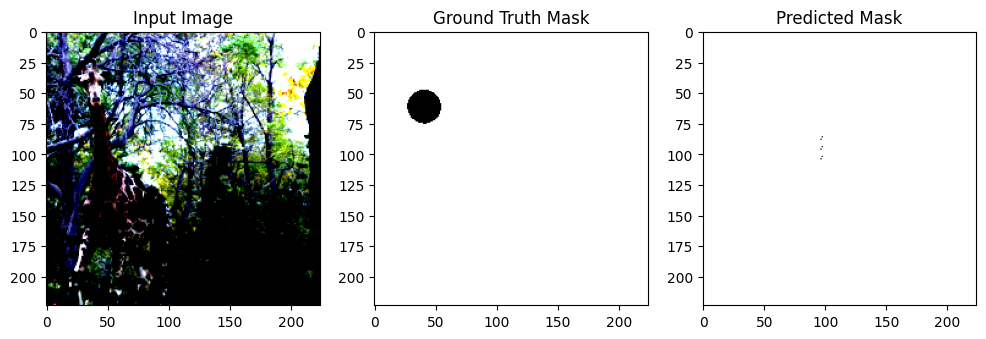

 19%|█▉        | 26/138 [01:03<05:56,  3.18s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9637812..2.64].


tensor(0.0719)


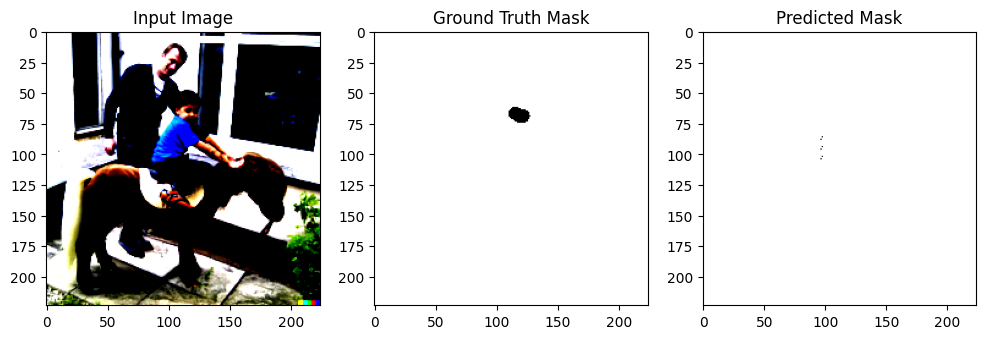

 20%|█▉        | 27/138 [01:03<04:29,  2.43s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.64].


tensor(0.0982)


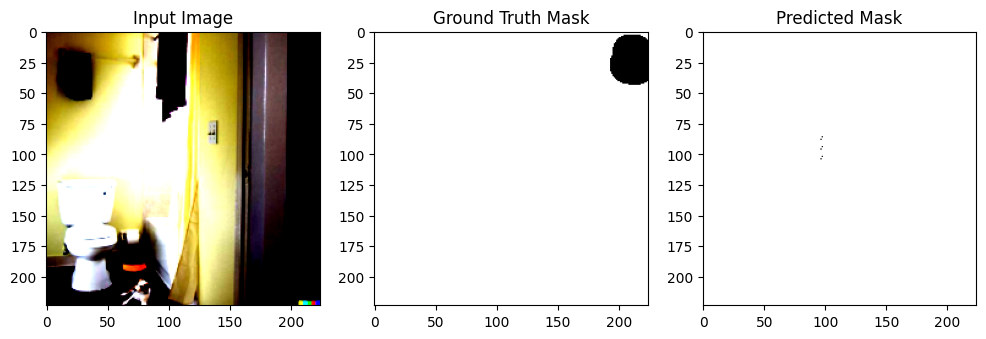

 20%|██        | 28/138 [01:04<03:29,  1.90s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.980906..2.64].


tensor(0.0763)


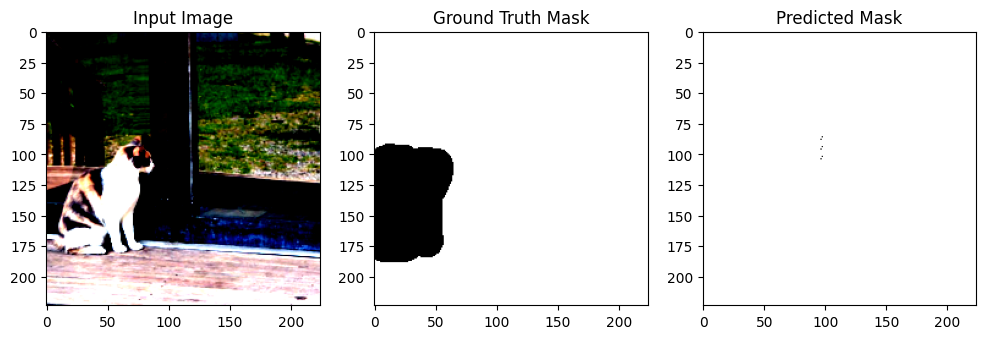

 21%|██        | 29/138 [01:05<02:42,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.465708].


tensor(0.0797)


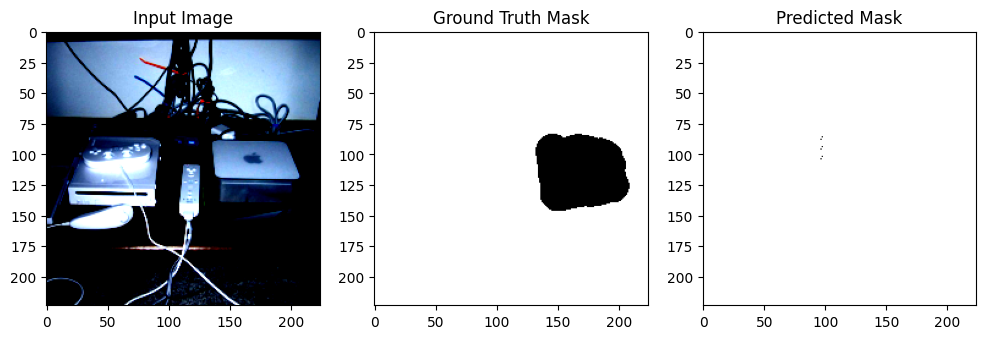

 22%|██▏       | 30/138 [01:05<02:15,  1.26s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.1087)


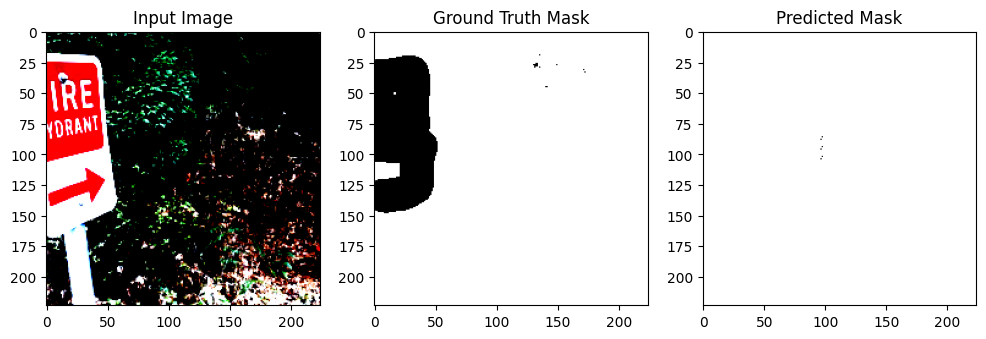

 22%|██▏       | 31/138 [01:06<01:57,  1.10s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.2739873].


tensor(0.0970)


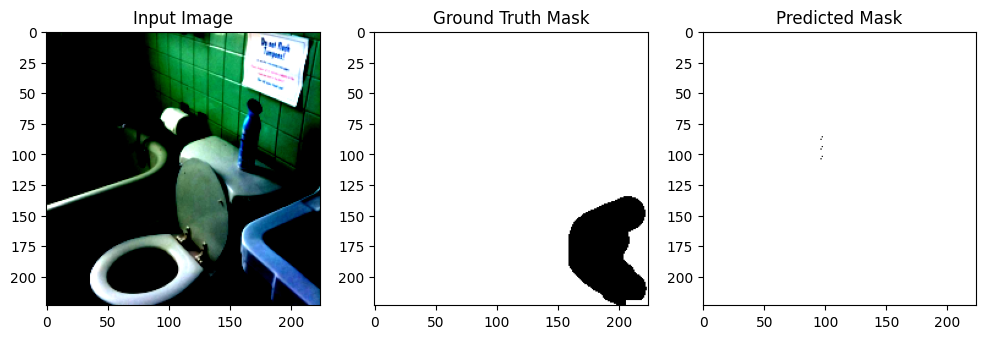

 23%|██▎       | 32/138 [01:07<01:41,  1.05it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..2.64].


tensor(0.0844)


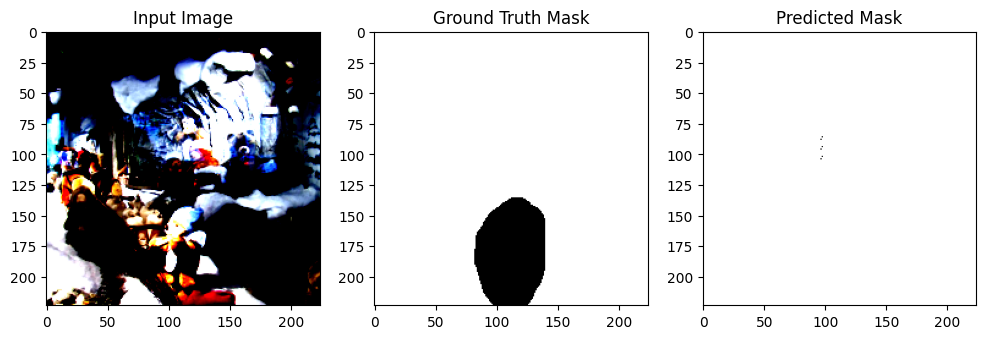

 24%|██▍       | 33/138 [01:19<07:47,  4.46s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9466565..2.64].


tensor(0.0952)


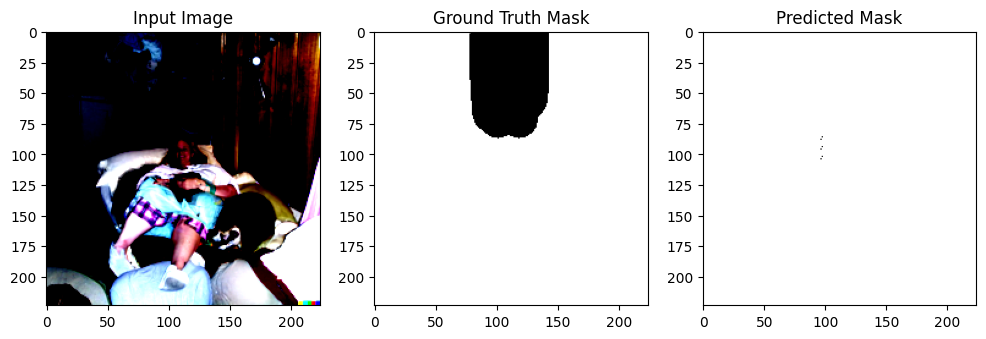

 25%|██▍       | 34/138 [01:20<05:52,  3.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.64].


tensor(0.0892)


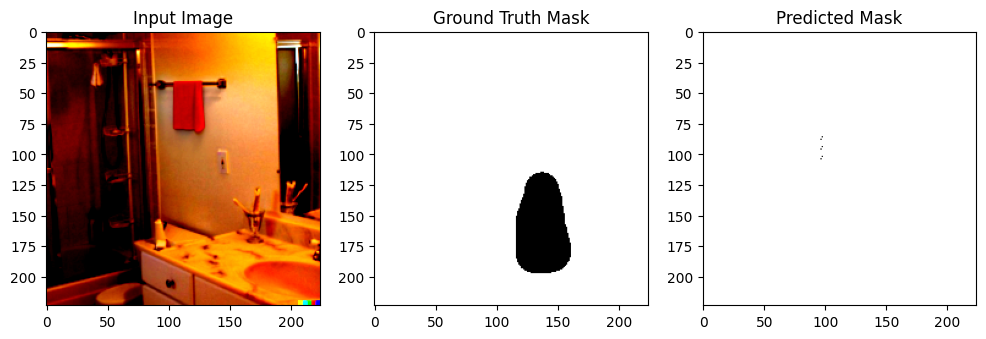

 25%|██▌       | 35/138 [01:21<04:25,  2.58s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0772)


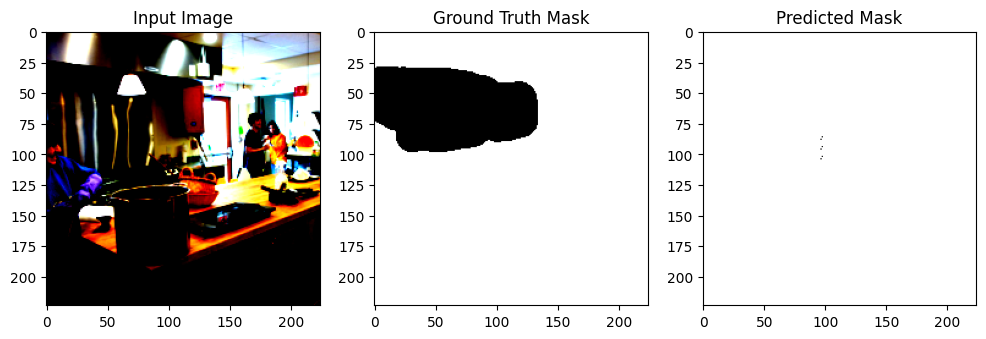

 26%|██▌       | 36/138 [01:21<03:19,  1.96s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


tensor(0.0636)


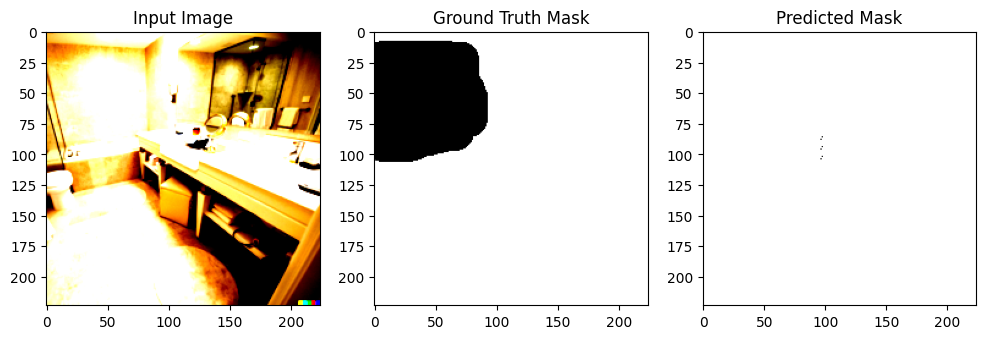

 27%|██▋       | 37/138 [01:22<02:44,  1.63s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0835)


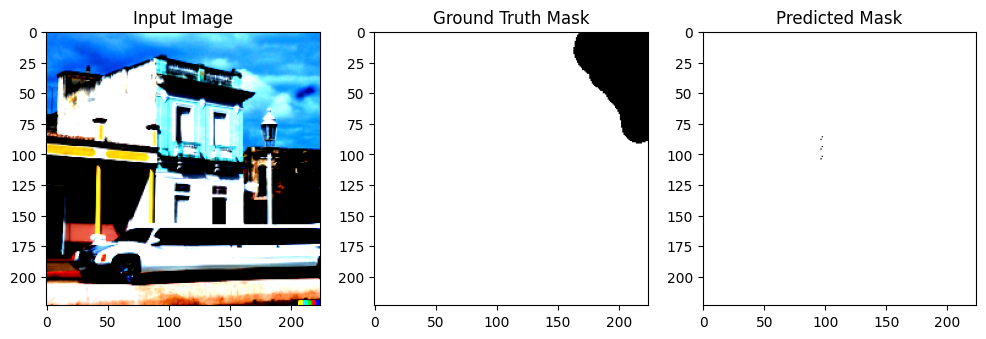

 28%|██▊       | 38/138 [01:23<02:13,  1.34s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.343704].


tensor(0.0955)


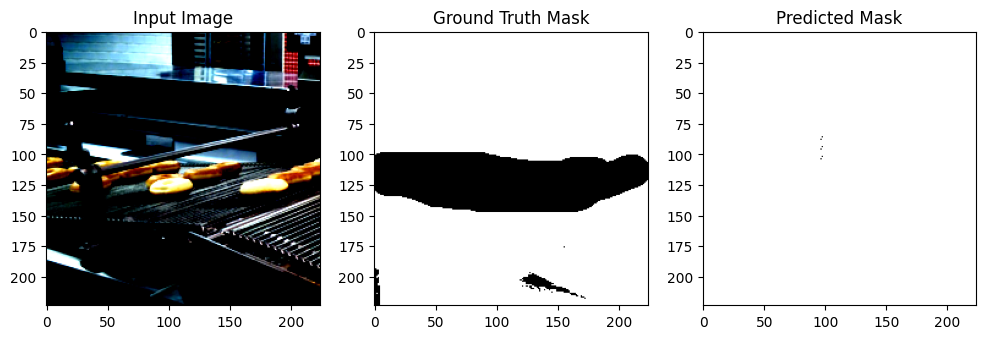

 28%|██▊       | 39/138 [01:24<01:55,  1.17s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.980906..2.64].


tensor(0.0684)


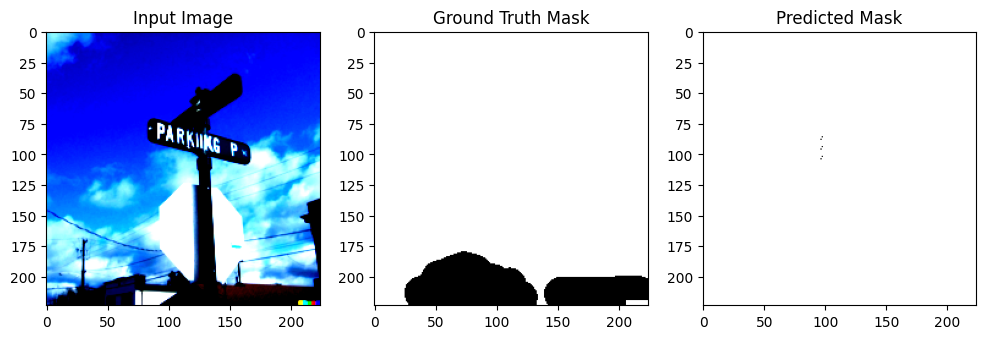

 29%|██▉       | 40/138 [01:24<01:38,  1.00s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0526)


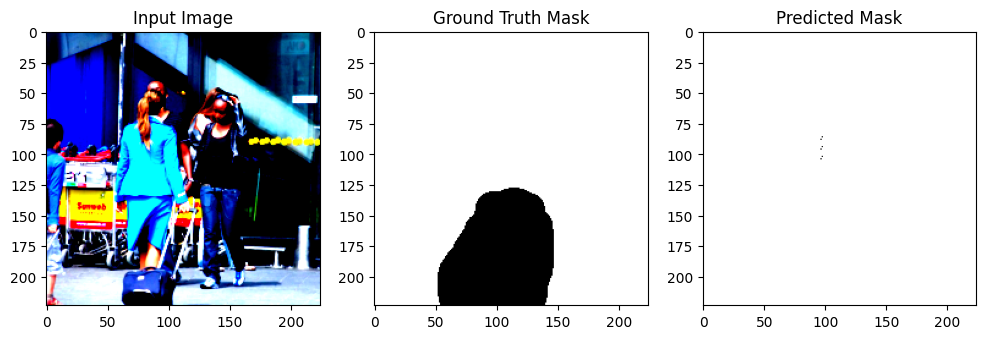

 30%|██▉       | 41/138 [01:37<07:10,  4.44s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0722)


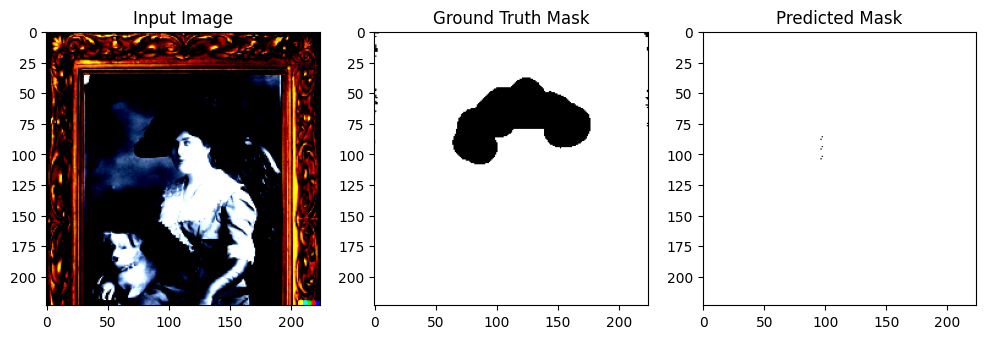

 30%|███       | 42/138 [01:37<05:14,  3.28s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


tensor(0.0932)


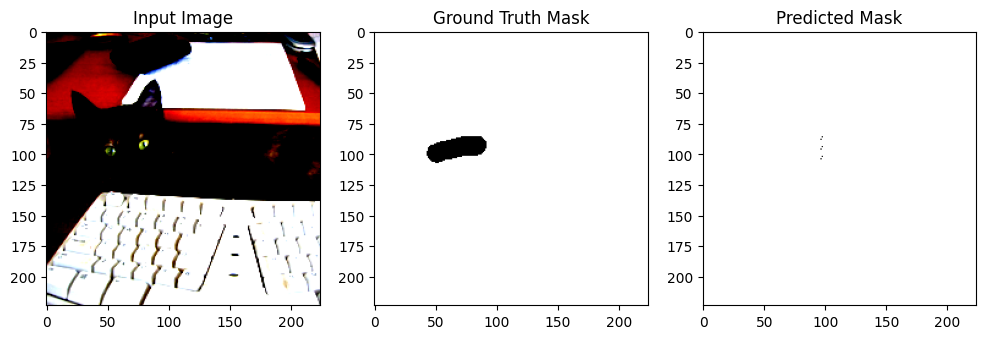

 31%|███       | 43/138 [01:38<04:05,  2.58s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0748)


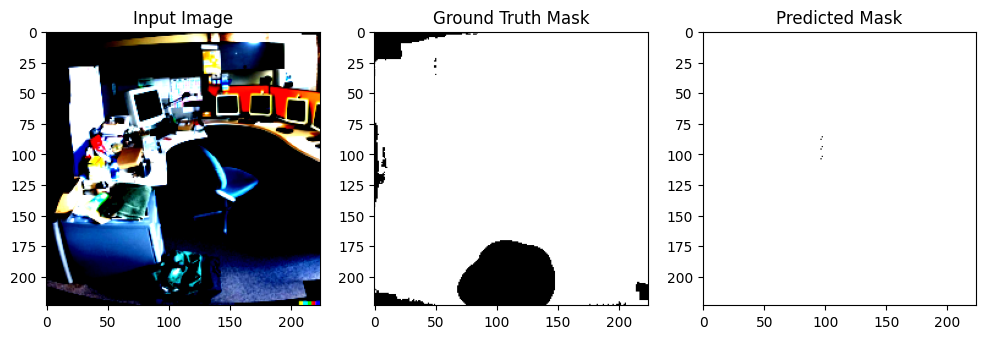

 32%|███▏      | 44/138 [01:39<03:12,  2.05s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].


tensor(0.0691)


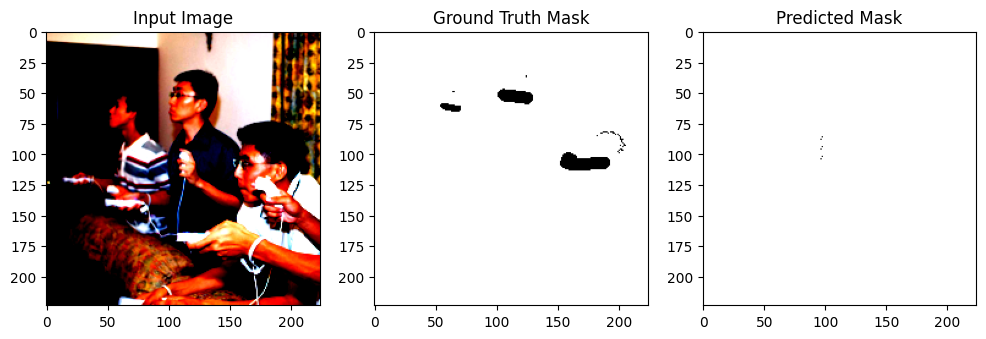

 33%|███▎      | 45/138 [01:40<02:32,  1.64s/it]

tensor(0.0610)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.980906..2.622571].


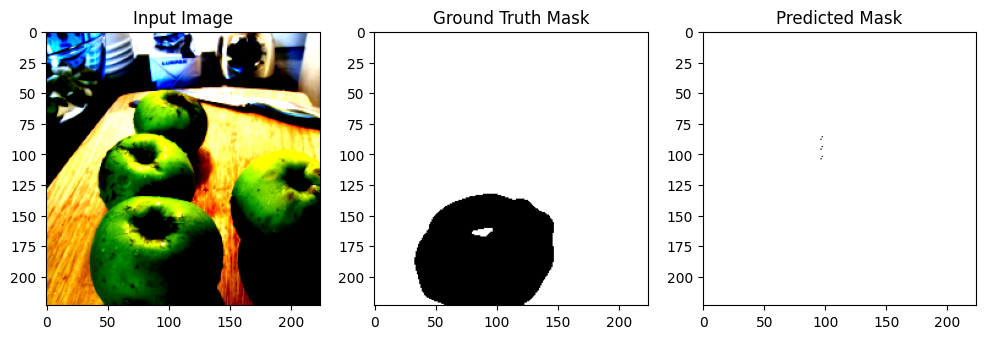

 33%|███▎      | 46/138 [01:41<02:18,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


tensor(0.0679)


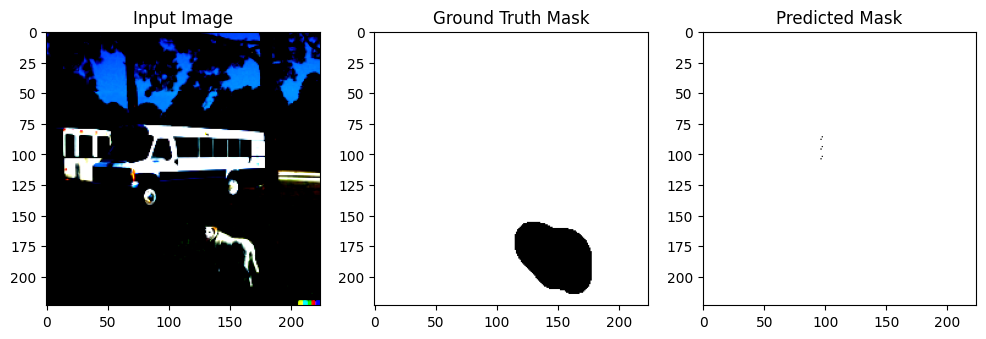

 34%|███▍      | 47/138 [01:42<01:52,  1.24s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.622571].


tensor(0.0639)


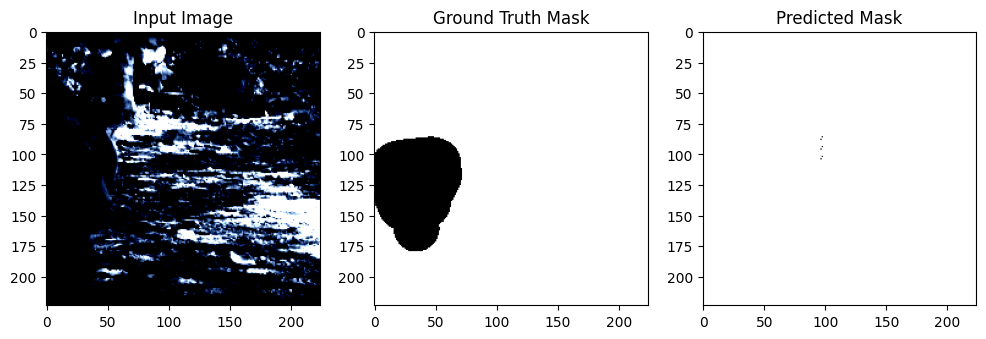

 35%|███▍      | 48/138 [01:42<01:33,  1.04s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.343704].


tensor(0.0796)


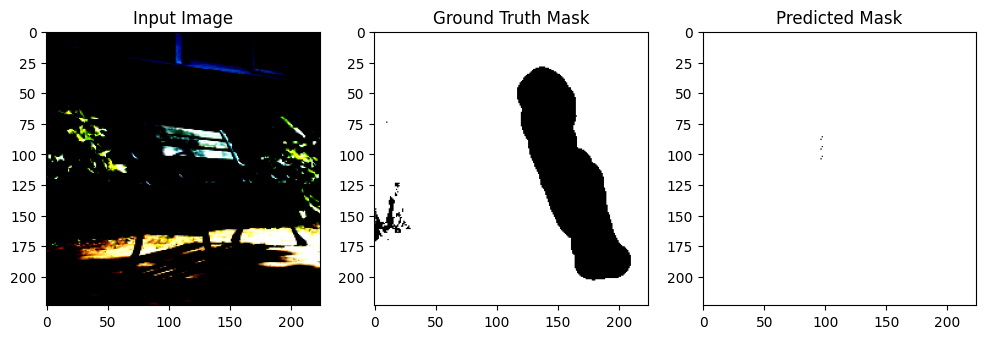

 36%|███▌      | 49/138 [01:55<06:41,  4.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7069099..2.2042704].


tensor(0.0720)


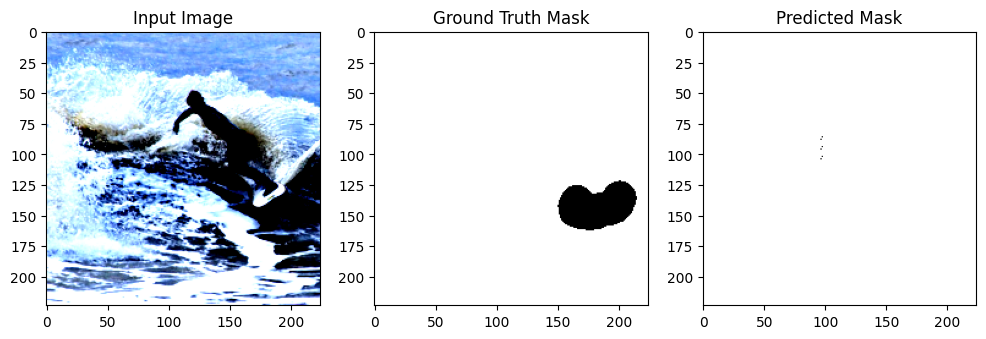

 38%|███▊      | 52/138 [01:56<02:40,  1.87s/it]

tensor(0.0845)
tensor(0.0750)


 39%|███▉      | 54/138 [01:56<01:32,  1.10s/it]

tensor(0.0533)
tensor(0.0574)


 40%|███▉      | 55/138 [01:57<01:24,  1.01s/it]

tensor(0.1042)


 41%|████      | 56/138 [01:57<01:04,  1.27it/s]

tensor(0.0880)


In [ ]:
import torch
import matplotlib.pyplot as plt
from tqdm import tqdm

model = torch.load("dice_maskpredictor_100.pth")
model.eval() 

with torch.no_grad(): 
    for i, (text_embedding, img, gt_mask) in enumerate(tqdm(test_loader)):
        text_embedding = text_embedding.to(device) 
        img = img.to(device) 
        gt_mask = gt_mask.to(device) 

        pred_mask = model(img, text_embedding)

        pred_mask = (pred_mask > 0.5).float()
        
        img = img.cpu()
        gt_mask = gt_mask.cpu()
        pred_mask = pred_mask.cpu()
        
        def dice_loss(pred, target, smooth=1):
            intersection = (pred * target).sum()
            dice = (2. * intersection + smooth) / (pred.sum() + target.sum() + smooth)
            return 1 - dice
        
        print(dice_loss(pred_mask,gt_mask))
        
        if i < 50: 
            fig, axes = plt.subplots(1, 3, figsize=(12, 4))
            axes[0].imshow(img[0].permute(1, 2, 0))
            axes[0].set_title("Input Image")
            axes[1].imshow(gt_mask[0].squeeze(), cmap="gray") 
            axes[1].set_title("Ground Truth Mask")
            axes[2].imshow(pred_mask[0].squeeze(), cmap="gray") 
            axes[2].set_title("Predicted Mask")
            plt.show()
        if i==100:
            break
